<a href="https://colab.research.google.com/github/AliceKitchkin/Unsupervised-Machine-Learning/blob/main/Clustering_FifaPlayer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Bibliotheken- und Datenimport

In [ ]:
# handle table-like data and matrices
import pandas as pd
import numpy as np

# visualisation
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
import plotly.express as px
from plotly.subplots import make_subplots
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree
from IPython.display import display, HTML

# preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder

# pca
from sklearn.decomposition import PCA

# clustering
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, MeanShift
from sklearn.neighbors import NearestNeighbors
import scipy.cluster.hierarchy as shc

# evaluations
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score, silhouette_score

#save and load models
import pickle
import os.path
import glob

# to display the total number columns present in the dataset
pd.set_option('display.max_columns', None)

!pip install ipython-autotime
%load_ext autotime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
The autotime extension is already loaded. To reload it, use:
  %reload_ext autotime
time: 4.42 s (started: 2023-02-19 09:10:52 +00:00)


In [ ]:
#Verbindung zum Google Drive herstellen
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
time: 1.99 s (started: 2023-02-19 09:10:56 +00:00)


In [ ]:
#Pfad der Raw-Datei
data_players = pd.read_csv("/content/drive/MyDrive/Bachelorarbeit/players_22.csv")

time: 477 ms (started: 2023-02-19 09:10:58 +00:00)


/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning:

Columns (25,108) have mixed types.Specify dtype option on import or set low_memory=False.



#Funktion zum Speichern und laden der Dateien

In [ ]:
#Pfad Pickle-Dateien
path_pickle = '/content/drive/MyDrive/Bachelorarbeit/savedFiles/pickle/'

#Pfad CSV-Dateien
path_csv = '/content/drive/MyDrive/Bachelorarbeit/savedFiles/csv/'

time: 859 µs (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
#Modell mit pickle speichern
def savePickle (model, filename:str):
  filename = filename + ".pickle"
  if os.path.isfile(filename):
    #überschreiben
    os.remove(filename)
    pickle_save = open(path_pickle + filename, 'wb')
    pickle.dump(model, pickle_save)
    pickle_save.close()
  else:
    #direkt speichern
    pickle_save = open(path_pickle + filename, 'wb')
    pickle.dump(model, pickle_save)
    pickle_save.close()

time: 1.24 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
#Modell laden
def loadPickle (filename:str):
  filename += ".pickle"
  if os.path.isfile(filename):
    #laden
    pickle.load(open(path_pickle + filename, 'rb'))
  else:
    #Datei nicht gefunden
    print("Datei nicht vorhanden")

time: 1.27 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
#Datei als CSV speichern
def saveCSV (df, filename:str):
  if os.path.isfile(filename):
    filename += ".csv"
    #überschreiben
    os.remove(filename)
    df.to_csv(path_csv + filename, index=False)
  else:
    #direkt speichern
    df.to_csv(path_csv + filename, index=False)

time: 1.82 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
#Datei laden
def loadCSV (filename:str):
  filename += ".csv"
  if os.path.isfile(filename):
    #laden
    pd.read_csv(path_csv + filename)
  else:
    #Datei nicht gefunden
    print("Datei nicht vorhanden")

time: 1.24 ms (started: 2023-02-19 09:10:59 +00:00)


#Überblick

In [ ]:
data_players.head()

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000.0,320000.0,34,1987-06-24,170,72,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,NaN,2021-08-10,2023.0,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,1988-08-21,185,81,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,NaN,2014-07-01,2023.0,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000.0,270000.0,36,1985-02-05,187,83,11.0,Manchester United,English Premier League,1.0,ST,7.0,NaN,2021-08-27,2023.0,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png


time: 78.7 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
data_players.shape

(19239, 110)

time: 4.41 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
data_players.describe()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed
count,19239.000000,19239.000000,19239.000000,1.916500e+04,19178.000000,19239.000000,19239.000000,19239.000000,19178.000000,19178.000000,19178.000000,19178.000000,19239.000000,759.000000,759.000000,19239.000000,19239.000000,19239.000000,1.806300e+04,17107.000000,17107.000000,17107.000000,17107.000000,17107.000000,17107.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,19239.000000,2132.000000
mean,231468.086959,65.772182,71.079370,2.850452e+06,9017.989363,25.210822,181.299704,74.943032,50580.498123,1.354364,20.945250,2022.764000,58.602682,14480.848485,12.567852,2.946151,2.352461,1.094184,5.374044e+06,68.213071,52.345297,57.312562,62.561174,51.703630,64.823289,49.577421,45.894433,51.783877,58.867977,42.463849,55.660429,47.268933,42.249025,53.072249,58.472010,64.652893,64.714902,63.500078,61.450023,64.068611,57.776860,64.813504,63.084880,65.007745,46.642705,55.538957,46.613545,50.330215,53.964603,47.858724,57.929830,46.601746,48.045584,45.906700,16.406102,16.192474,16.055356,16.229274,16.491814,36.439962
std,27039.717497,6.880232,6.086213,7.613700e+06,19470.176724,4.748235,6.863179,7.069434,54401.868535,0.747865,17.909369,1.213203,50.298614,35328.730217,7.039116,0.671560,0.767659,0.371098,1.494837e+07,10.933155,14.051623,10.068965,9.651312,16.189746,9.791886,18.034661,19.721023,17.294183,14.490858,17.653329,18.784590,18.181085,17.178590,15.026569,16.663722,15.167399,14.965426,14.862285,9.042281,14.324789,13.192224,12.122977,16.145279,12.663518,19.411583,16.972181,20.677077,19.621601,13.650481,15.768583,12.159326,20.200807,21.232718,20.755683,17.574028,16.839528,16.564554,17.059779,17.884833,10.751563
min,41.000000,47.000000,49.000000,9.000000e+03,500.000000,16.000000,155.000000,49.000000,1.000000,1.000000,1.000000,2021.000000,1.000000,1318.000000,1.000000,1.000000,1.000000,1.000000,1.600000e+04,28.000000,18.000000,25.000000,27.000000,14.000000,29.000000,6.000000,2.000000,5.000000,7.000000,3.000000,4.000000,6.000000,4.000000,9.000000,8.000000,14.000000,15.000000,18.000000,25.000000,15.000000,20.000000,22.000000,12.000000,19.000000,4.000000,10.000000,3.000000,2.000000,10.000000,7.000000,12.000000,4.000000,5.000000,5.000000,2.000000,2.000000,2.000000,2.000000,2.000000,15.000000
25%,214413.500000,61.000000,67.000000,4.750000e+05,1000.000000,21.000000,176.000000,70.000000,479.000000,1.000000,9.000000,2022.000000,21.000000,1338.000000,7.000000,3.000000,2.000000,1.000000,8.060000e+05,62.000000,42.000000,51.000000,57.000000,37.000000,59.000000,38.000000,30.000000,44.000000,54.000000,30.000000,50.000000,35.000000,31.000000,44.000000,55.000000,57.000000,58.000000,55.000000,56.000

time: 218 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
len(data_players['sofifa_id'].unique())

19239

time: 5.83 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
len(data_players['club_team_id'].unique())

702

time: 8.48 ms (started: 2023-02-19 09:10:59 +00:00)


In [ ]:
obj = data_players.isnull().sum()
for key,value in obj.iteritems():
    print(key,",",value)

sofifa_id , 0
player_url , 0
short_name , 0
long_name , 0
player_positions , 0
overall , 0
potential , 0
value_eur , 74
wage_eur , 61
age , 0
dob , 0
height_cm , 0
weight_kg , 0
club_team_id , 61
club_name , 61
league_name , 61
league_level , 61
club_position , 61
club_jersey_number , 61
club_loaned_from , 18137
club_joined , 1163
club_contract_valid_until , 61
nationality_id , 0
nationality_name , 0
nation_team_id , 18480
nation_position , 18480
nation_jersey_number , 18480
preferred_foot , 0
weak_foot , 0
skill_moves , 0
international_reputation , 0
work_rate , 0
body_type , 0
real_face , 0
release_clause_eur , 1176
player_tags , 17798
player_traits , 9841
pace , 2132
shooting , 2132
passing , 2132
dribbling , 2132
defending , 2132
physic , 2132
attacking_crossing , 0
attacking_finishing , 0
attacking_heading_accuracy , 0
attacking_short_passing , 0
attacking_volleys , 0
skill_dribbling , 0
skill_curve , 0
skill_fk_accuracy , 0
skill_long_passing , 0
skill_ball_control , 0
movement_a

In [ ]:
display(data_players[data_players.isna().any(axis=1)])

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000.0,320000.0,34,1987-06-24,170,72,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,NaN,2021-08-10,2023.0,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,1988-08-21,185,81,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,NaN,2014-07-01,2023.0,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000.0,270000.0,36,1985-02-05,187,83,11.0,Manchester United,English Premier League,1.0,ST,7.0,NaN,2021-08-27,2023.0,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png


time: 152 ms (started: 2023-02-19 09:10:59 +00:00)


#Datenaufbereitung

In [ ]:
#Datensatz kopieren
data_original = data_players.copy()

time: 30.3 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#Nicht benötigte Spalten löschen
cols = ['club_name', 'long_name','league_name','dob','league_level','real_face', 'skill_moves',
        'club_jersey_number','club_loaned_from','nation_jersey_number','work_rate','body_type',
        'player_face_url','club_logo_url','club_flag_url','nation_logo_url','nation_flag_url','player_url',
        'sofifa_id','goalkeeping_speed','player_traits','player_tags', 'club_position', 'weak_foot',
        'ls','st','rs','lw','lf','cf','rf',	'club_joined', 'club_contract_valid_until', 'nationality_id',
        'rw','lam','cam','ram','lm','lcm', 'nationality_name', 'nation_team_id',
        'cm','rcm','rm','lwb','ldm','rb','gk', 'nation_position', 'player_positions', 'international_reputation',
        'cdm','rdm','rwb','lb','lcb','cb','rcb', 'club_team_id', 'release_clause_eur',
        'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning',
        'goalkeeping_reflexes','goalkeeping_speed','pace','shooting','passing','dribbling','defending','physic']

data_original.drop(cols, axis=1, inplace=True)

time: 19.6 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#Spalten umbenennen
data_original.rename(columns={'overall': 'gesamtbewertung',
                              'potential': 'potenzial',
                              'value_eur': 'wert_in_euro',
                              'wage_eur': 'lohn',
                              'age': 'alter',
                              'height_cm': 'groesse_cm',
                              'weight_kg': 'gewicht_kg',
                              'nation_team_id': 'nation_team_id',
                              'pace': 'tempo',
                              'shooting': 'schiessen',
                              'passing': 'uebergabe',
                              'dribbling': 'dribbling',
                              'defending': 'verteidigen',
                              'attacking_crossing': 'offensiv_flanken',
                              'attacking_finishing': 'offensiv_abschluss',
                              'attacking_heading_accuracy': 'offensiv_kopfball_praezision',
                              'attacking_short_passing': 'offensiv_kurzpaesse',
                              'attacking_volleys': 'offensiv_volleys',
                              'skill_dribbling': 'technik_dribbling',
                              'skill_curve': 'technik_effet',
                              'skill_fk_accuracy': 'technik_freistoss_praezision',
                              'skill_long_passing': 'technik_lange_paesse',
                              'skill_ball_control': 'technik_ballkontrolle',
                              'movement_acceleration': 'bewegung_beschleunigung',
                              'movement_sprint_speed': 'bewegung_sprintgeschwindigkeit',
                              'movement_agility': 'bewegung_beweglichkeit',
                              'movement_reactions': 'bewegung_reaktionen',
                              'movement_balance': 'bewegung_balance',
                              'power_shot_power': 'kraft_schusskraft',
                              'power_jumping': 'kraft_sprungkraft',
                              'power_stamina': 'kraft_ausdauer',
                              'power_strength': 'kraft_staerke',
                              'power_long_shots': 'kraft_fernschuesse',
                              'mentality_aggression': 'mentalitaet_aggressivitaet',
                              'mentality_interceptions': 'mentalitaet_abfangen',
                              'mentality_positioning': 'mentalitaet_stellungsspiel',
                              'mentality_vision': 'mentalitaet_uebersicht',
                              'mentality_penalties': 'mentalitaet_elfmeter',
                              'mentality_composure': 'mentalitaet_ruhe',
                              'defending_marking_awareness': 'defensiv_bewusstsein',
                              'defending_standing_tackle': 'defensiv_faire_zweikaempfe',
                              'defending_sliding_tackle': 'defensiv_graetsche',
                              'short_name': 'kurzname',
                              'preferred_foot': 'bevorzugter_fuss'
                              }, inplace=True)

# club_joined Jahre extrahieren???
# club_contract_valid_until in jahre umwandeln???

display(data_original.head())

,kurzname,gesamtbewertung,potenzial,wert_in_euro,lohn,alter,groesse_cm,gewicht_kg,bevorzugter_fuss,offensiv_flanken,offensiv_abschluss,offensiv_kopfball_praezision,offensiv_kurzpaesse,offensiv_volleys,technik_dribbling,technik_effet,technik_freistoss_praezision,technik_lange_paesse,technik_ballkontrolle,bewegung_beschleunigung,bewegung_sprintgeschwindigkeit,bewegung_beweglichkeit,bewegung_reaktionen,bewegung_balance,kraft_schusskraft,kraft_sprungkraft,kraft_ausdauer,kraft_staerke,kraft_fernschuesse,mentalitaet_aggressivitaet,mentalitaet_abfangen,mentalitaet_stellungsspiel,mentalitaet_uebersicht,mentalitaet_elfmeter,mentalitaet_ruhe,defensiv_bewusstsein,defensiv_faire_zweikaempfe,defensiv_graetsche
0,L. Messi,93,93,78000000.0,320000.0,34,170,72,Left,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24
1,R. Lewandowski,92,92,119500000.0,270000.0,32,185,81,Right,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19
2,Cristiano Ronaldo,91,91,45000000.0,270000.0,36,187,83,Right,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24
3,Neymar Jr,91,91,129000000.0,270000.0,29,175,68,Right,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,35,32,29
4,K. De Bruyne,91,91,125500000.0,350000.0,30,181,70,Right,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53


time: 35.3 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#alle kategorischen Spalten anzeigen
categorical_columns = data_original.select_dtypes(['object']).columns
categorical_columns

Index(['kurzname', 'bevorzugter_fuss'], dtype='object')

time: 6.67 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#alle kategorischen Spalten numerisch machen
for i in categorical_columns:
 data_original[i] = pd.factorize(data_original[i])[0]

display(data_original.head())

,kurzname,gesamtbewertung,potenzial,wert_in_euro,lohn,alter,groesse_cm,gewicht_kg,bevorzugter_fuss,offensiv_flanken,offensiv_abschluss,offensiv_kopfball_praezision,offensiv_kurzpaesse,offensiv_volleys,technik_dribbling,technik_effet,technik_freistoss_praezision,technik_lange_paesse,technik_ballkontrolle,bewegung_beschleunigung,bewegung_sprintgeschwindigkeit,bewegung_beweglichkeit,bewegung_reaktionen,bewegung_balance,kraft_schusskraft,kraft_sprungkraft,kraft_ausdauer,kraft_staerke,kraft_fernschuesse,mentalitaet_aggressivitaet,mentalitaet_abfangen,mentalitaet_stellungsspiel,mentalitaet_uebersicht,mentalitaet_elfmeter,mentalitaet_ruhe,defensiv_bewusstsein,defensiv_faire_zweikaempfe,defensiv_graetsche
0,0,93,93,78000000.0,320000.0,34,170,72,0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24
1,1,92,92,119500000.0,270000.0,32,185,81,1,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19
2,2,91,91,45000000.0,270000.0,36,187,83,1,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24
3,3,91,91,129000000.0,270000.0,29,175,68,1,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,35,32,29
4,4,91,91,125500000.0,350000.0,30,181,70,1,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53


time: 42 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#Fehlende Werte 
obj = data_original.isnull().sum()
for key,value in obj.iteritems():
  print(key,",",value)

kurzname , 0
gesamtbewertung , 0
potenzial , 0
wert_in_euro , 74
lohn , 61
alter , 0
groesse_cm , 0
gewicht_kg , 0
bevorzugter_fuss , 0
offensiv_flanken , 0
offensiv_abschluss , 0
offensiv_kopfball_praezision , 0
offensiv_kurzpaesse , 0
offensiv_volleys , 0
technik_dribbling , 0
technik_effet , 0
technik_freistoss_praezision , 0
technik_lange_paesse , 0
technik_ballkontrolle , 0
bewegung_beschleunigung , 0
bewegung_sprintgeschwindigkeit , 0
bewegung_beweglichkeit , 0
bewegung_reaktionen , 0
bewegung_balance , 0
kraft_schusskraft , 0
kraft_sprungkraft , 0
kraft_ausdauer , 0
kraft_staerke , 0
kraft_fernschuesse , 0
mentalitaet_aggressivitaet , 0
mentalitaet_abfangen , 0
mentalitaet_stellungsspiel , 0
mentalitaet_uebersicht , 0
mentalitaet_elfmeter , 0
mentalitaet_ruhe , 0
defensiv_bewusstsein , 0
defensiv_faire_zweikaempfe , 0
defensiv_graetsche , 0
time: 12.2 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#Zeilen mit fehlenden Werten in wert_in_euro und lohn löschen
data_original.dropna(subset=['wert_in_euro', 'lohn'], inplace=True)

time: 33.4 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#Kontrolle: Fehlende Werte
obj = data_original.isnull().sum()
for key,value in obj.iteritems():
  print(key,",",value)

kurzname , 0
gesamtbewertung , 0
potenzial , 0
wert_in_euro , 0
lohn , 0
alter , 0
groesse_cm , 0
gewicht_kg , 0
bevorzugter_fuss , 0
offensiv_flanken , 0
offensiv_abschluss , 0
offensiv_kopfball_praezision , 0
offensiv_kurzpaesse , 0
offensiv_volleys , 0
technik_dribbling , 0
technik_effet , 0
technik_freistoss_praezision , 0
technik_lange_paesse , 0
technik_ballkontrolle , 0
bewegung_beschleunigung , 0
bewegung_sprintgeschwindigkeit , 0
bewegung_beweglichkeit , 0
bewegung_reaktionen , 0
bewegung_balance , 0
kraft_schusskraft , 0
kraft_sprungkraft , 0
kraft_ausdauer , 0
kraft_staerke , 0
kraft_fernschuesse , 0
mentalitaet_aggressivitaet , 0
mentalitaet_abfangen , 0
mentalitaet_stellungsspiel , 0
mentalitaet_uebersicht , 0
mentalitaet_elfmeter , 0
mentalitaet_ruhe , 0
defensiv_bewusstsein , 0
defensiv_faire_zweikaempfe , 0
defensiv_graetsche , 0
time: 22.3 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#Namen der Spieler speichern
player_names = data_original.kurzname.tolist()
print(player_names)

#Namen der Spieler aus Df löschen
data_original.drop(['kurzname'], axis=1, inplace=True)
display(data_original.head())

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222,

,gesamtbewertung,potenzial,wert_in_euro,lohn,alter,groesse_cm,gewicht_kg,bevorzugter_fuss,offensiv_flanken,offensiv_abschluss,offensiv_kopfball_praezision,offensiv_kurzpaesse,offensiv_volleys,technik_dribbling,technik_effet,technik_freistoss_praezision,technik_lange_paesse,technik_ballkontrolle,bewegung_beschleunigung,bewegung_sprintgeschwindigkeit,bewegung_beweglichkeit,bewegung_reaktionen,bewegung_balance,kraft_schusskraft,kraft_sprungkraft,kraft_ausdauer,kraft_staerke,kraft_fernschuesse,mentalitaet_aggressivitaet,mentalitaet_abfangen,mentalitaet_stellungsspiel,mentalitaet_uebersicht,mentalitaet_elfmeter,mentalitaet_ruhe,defensiv_bewusstsein,defensiv_faire_zweikaempfe,defensiv_graetsche
0,93,93,78000000.0,320000.0,34,170,72,0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24
1,92,92,119500000.0,270000.0,32,185,81,1,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19
2,91,91,45000000.0,270000.0,36,187,83,1,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24
3,91,91,129000000.0,270000.0,29,175,68,1,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,35,32,29
4,91,91,125500000.0,350000.0,30,181,70,1,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53


time: 88.3 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
data_spaltenanzahl = len(data_original.columns)
data_spaltenanzahl

37

time: 14.5 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
data_original

,gesamtbewertung,potenzial,wert_in_euro,lohn,alter,groesse_cm,gewicht_kg,bevorzugter_fuss,offensiv_flanken,offensiv_abschluss,offensiv_kopfball_praezision,offensiv_kurzpaesse,offensiv_volleys,technik_dribbling,technik_effet,technik_freistoss_praezision,technik_lange_paesse,technik_ballkontrolle,bewegung_beschleunigung,bewegung_sprintgeschwindigkeit,bewegung_beweglichkeit,bewegung_reaktionen,bewegung_balance,kraft_schusskraft,kraft_sprungkraft,kraft_ausdauer,kraft_staerke,kraft_fernschuesse,mentalitaet_aggressivitaet,mentalitaet_abfangen,mentalitaet_stellungsspiel,mentalitaet_uebersicht,mentalitaet_elfmeter,mentalitaet_ruhe,defensiv_bewusstsein,defensiv_faire_zweikaempfe,defensiv_graetsche
0,93,93,78000000.0,320000.0,34,170,72,0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24
1,92,92,119500000.0,270000.0,32,185,81,1,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19
2,91,91,45000000.0,270000.0,36,187,83,1,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24
3,91,91,129000000.0,270000.0,29,175,68,1,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,35,32,29
4,91,91,125500000.0,350000.0,30,181,70,1,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19234,47,52,70000.0,1000.0,22,180,64,1,46,32,48,50,30,45,33,38,48,49,56,60,55,53,70,46,62,51,46,30,52,42,38,43,42,37,38,43,48
19235,47,59,110000.0,500.0,19,175,70,1,54,33,46,51,32,41,53,31,50,42,60,58,64,49,69,49,47,63,47,38,49,39,51,49,44,47,37,44,47
19236,47,55,100000.0,500.0,21,178,72,1,39,32,43,49,37,47,37,37,49,49,60,60,58,46,59,50,57,56,50,34,51,38,45,46,39,36,38,44,48
19237,47,60,110000.0,500.0,19,173,66,1,29,49,40,38,34,42,36,34,33,45,69,67,72,48,73,48,50,50,40,41,34,14,47,40,49,47,10,14,11


time: 102 ms (started: 2023-02-19 09:11:00 +00:00)


#Feature Scaling

In [ ]:
#Scaling with minMaxScaler
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(data_original)
data_scaled_df = pd.DataFrame(data_scaled)

time: 30.7 ms (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
data_scaled_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36
0,1.000000,0.956522,0.402034,0.914163,0.666667,0.294118,0.377049,0.0,0.897727,1.000000,0.738636,0.965517,0.977011,1.000000,0.988636,1.000000,0.976190,1.000000,0.927711,0.792683,0.935897,1.000000,0.987654,0.880000,0.630137,0.705882,0.641026,1.000000,0.400000,0.420455,0.968085,1.000000,0.790698,1.000000,0.179775,0.340909,0.218391
1,0.978261,0.934783,0.615962,0.771102,0.592593,0.588235,0.524590,1.0,0.738636,1.000000,0.965909,0.896552,0.988506,0.880435,0.829545,0.900000,0.726190,0.909091,0.759036,0.780488,0.756410,0.985507,0.827160,0.933333,0.863014,0.752941,0.858974,0.922222,0.835294,0.522727,0.989362,0.835294,0.965116,0.904762,0.348315,0.420455,0.160920
2,0.956522,0.913043,0.231923,0.771102,0.740741,0.627451,0.557377,1.0,0.920455,1.000000,0.965909,0.839080,0.954023,0.913043,0.852273,0.888889,0.809524,0.909091,0.855422,0.890244,0.871795,1.000000,0.728395,0.986667,1.000000,0.764706,0.743590,0.988889,0.623529,0.295455,0.989362,0.776471,0.941860,0.988095,0.224719,0.306818,0.218391
3,0.956522,0.913043,0.664933,0.771102,0.481481,0.392157,0.311475,1.0,0.897727,0.870968,0.659091,0.908046,0.954023,0.989130,0.931818,0.922222,0.857143,0.988636,0.951807,0.902439,1.000000,0.927536,0.851852,0.800000,0.575342,0.811765,0.435897,0.855556,0.623529,0.386364,0.893617,0.941176,1.000000,0.964286,0.348315,0.306818,0.275862
4,0.956522,0.913043,0.646891,1.000000,0.518519,0.509804,0.344262,1.0,1.000000,0.860215,0.568182,1.000000,0.908046,0.913043,0.897727,0.877778,1.000000,0.943182,0.746988,0.743902,0.782051,0.956522,0.777778,0.946667,0.561644,0.905882,0.705128,0.966667,0.776471,0.715909,0.914894,0.988235,0.883721,0.916667,0.719101,0.681818,0.551724


time: 55.6 ms (started: 2023-02-19 09:11:00 +00:00)


/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



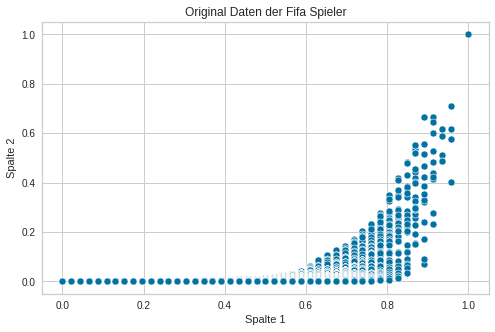

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



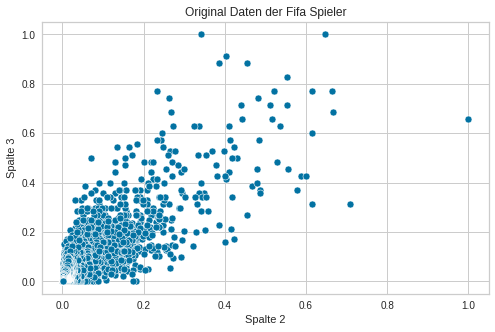

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



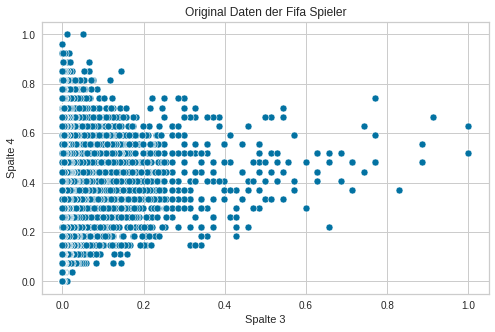

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



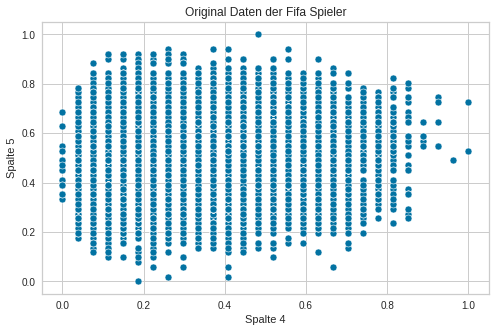

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



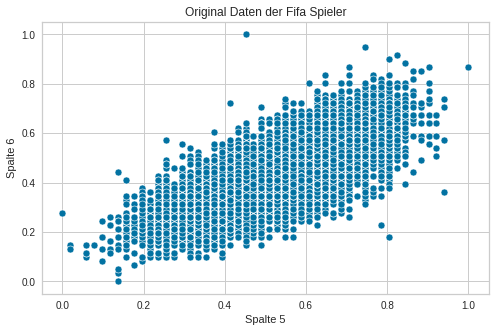

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



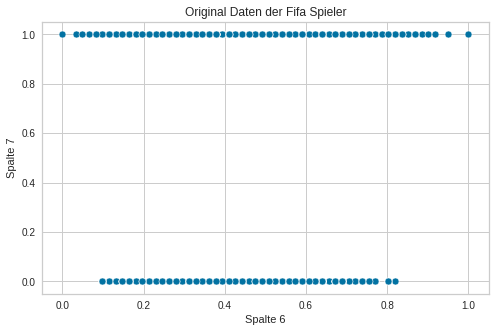

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



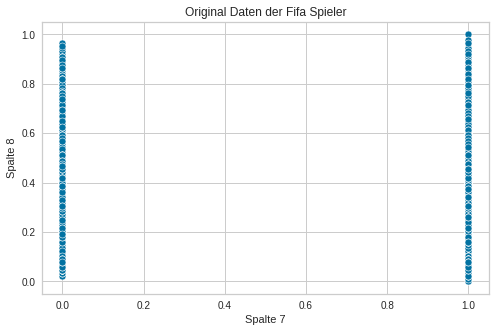

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



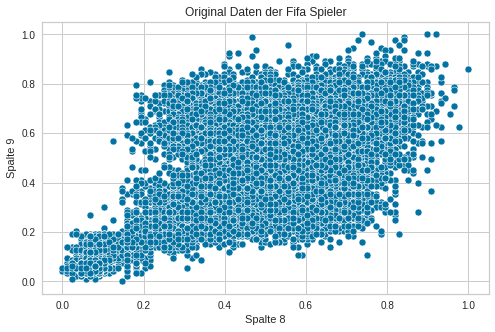

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



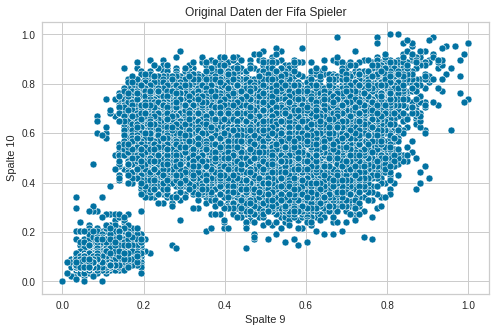

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



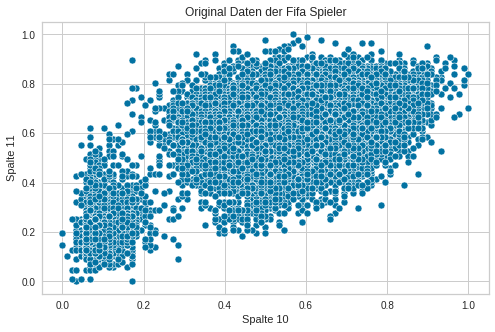

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



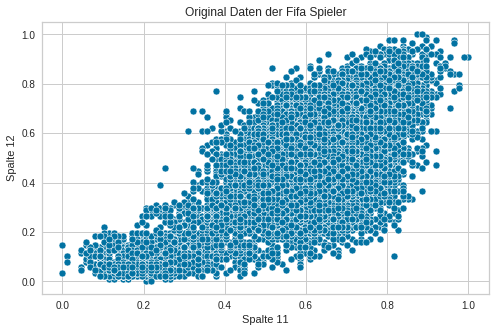

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



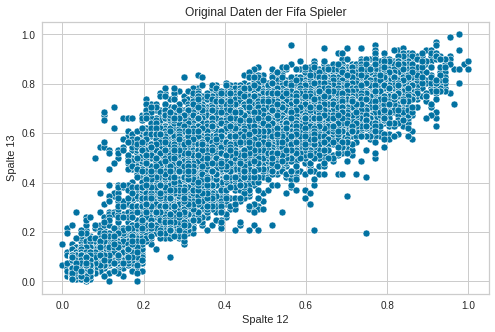

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



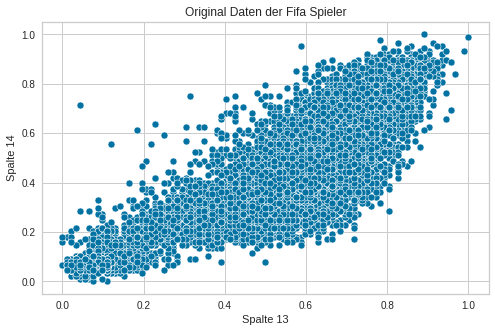

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



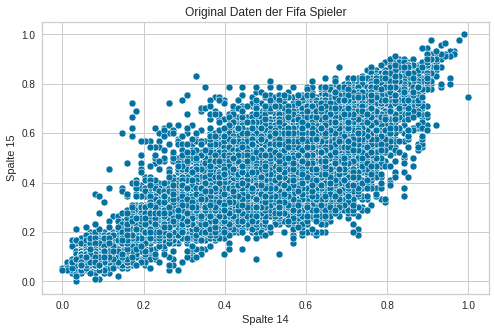

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



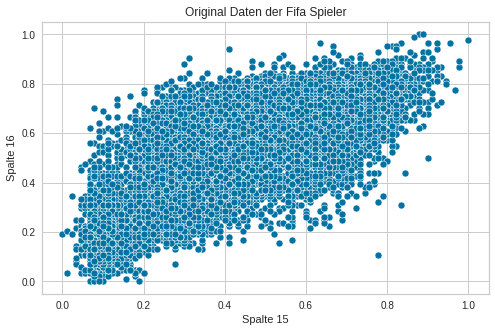

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



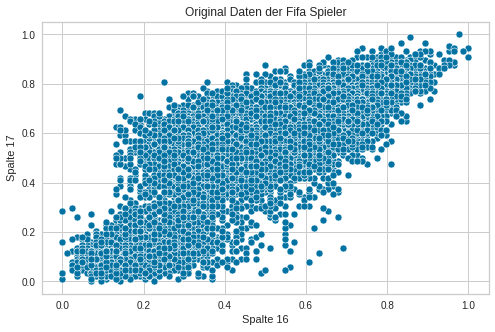

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



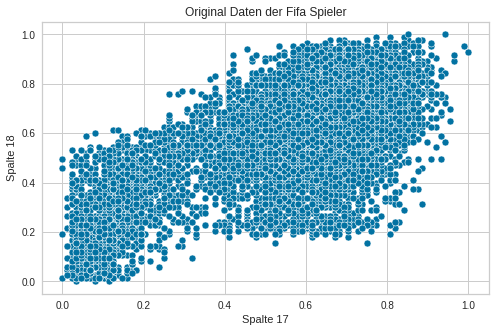

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



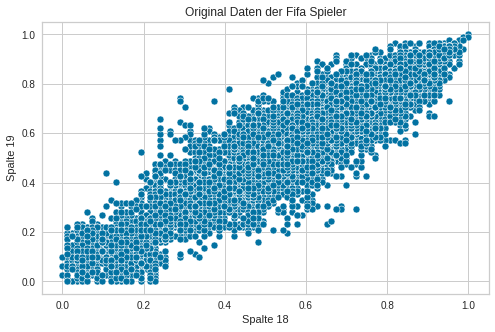

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



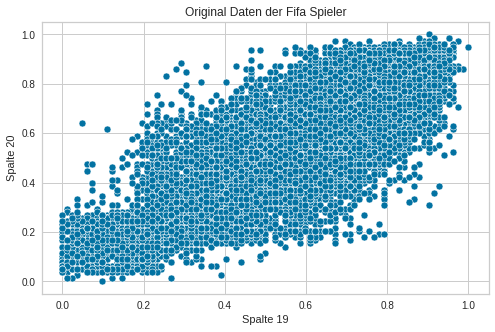

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



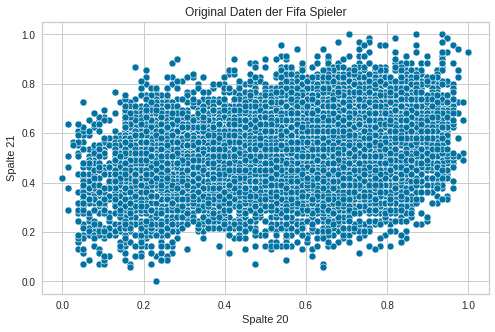

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



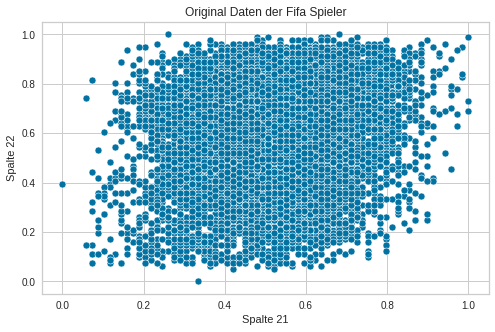

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



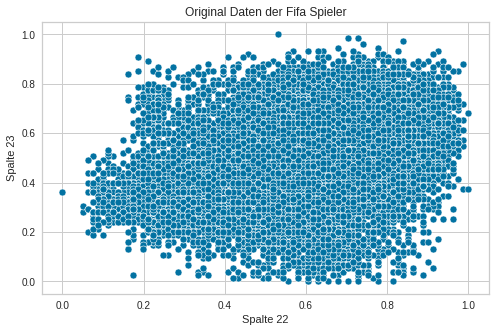

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



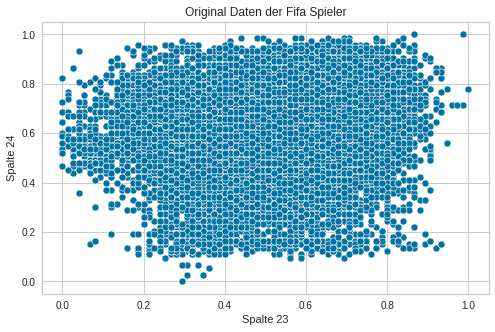

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



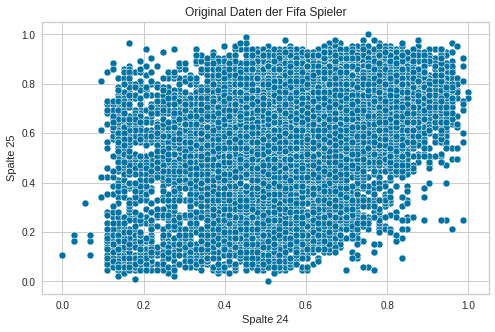

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



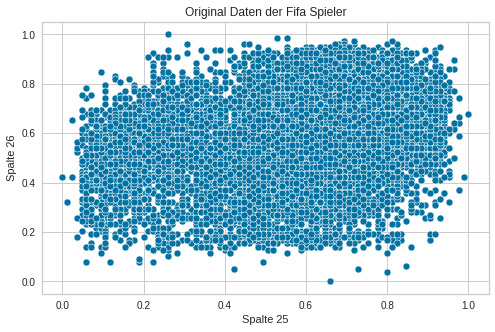

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



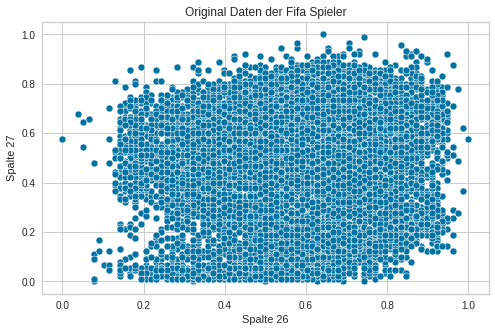

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



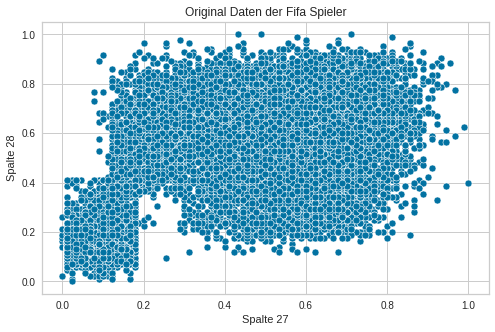

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



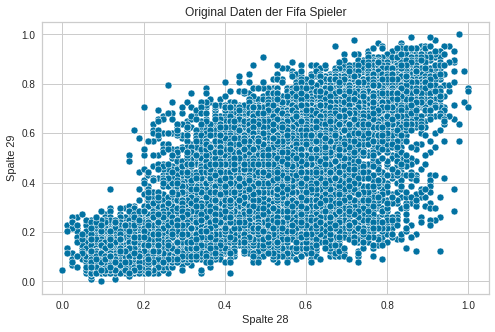

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



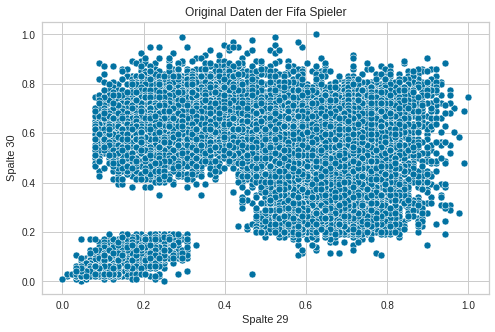

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



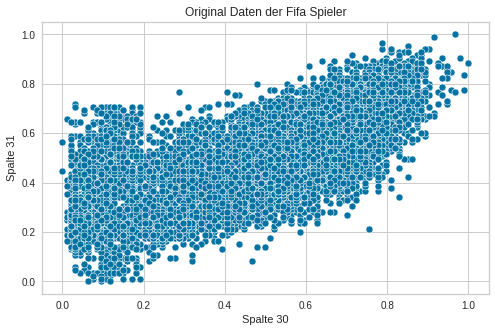

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



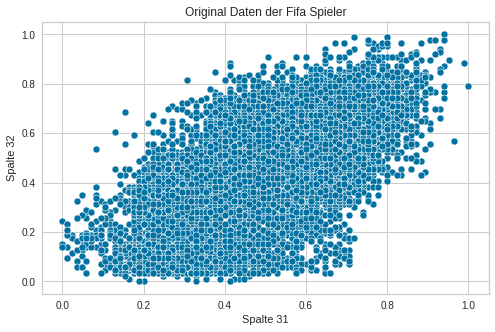

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



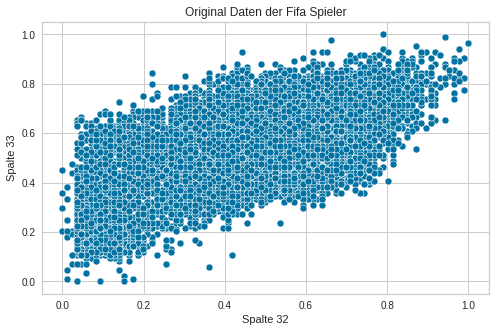

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



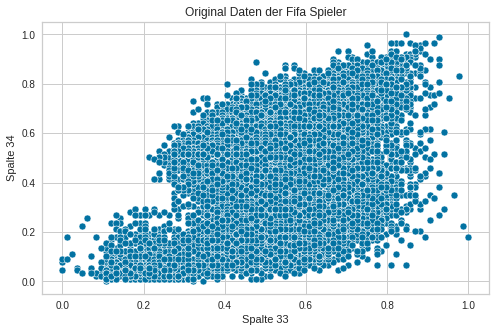

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



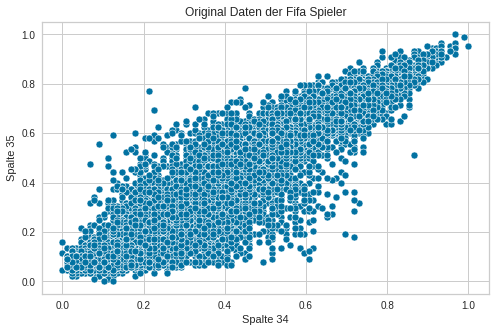

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



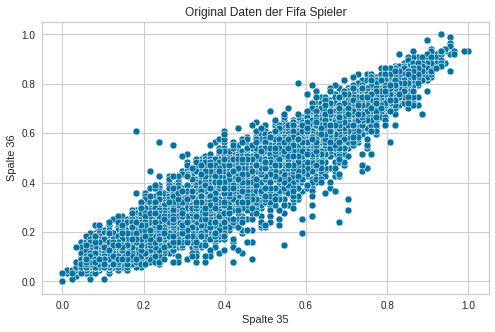

time: 12.1 s (started: 2023-02-19 09:11:00 +00:00)


In [ ]:
#Nicht alle Spaltenkombinationen werden geplottet
for i in range(1, data_spaltenanzahl-1):
  #Spalten für das Diagramm wählen
  x_axis = data_scaled_df.iloc[:,i] #component/column x in table
  y_axis = data_scaled_df.iloc[:,i+1]  #component/column y in table

  #Diagramm Settings
  plt.figure(figsize=(8,5))
  sns.scatterplot(x_axis, y_axis, palette ="deep")
  plt.title('Original Daten der Fifa Spieler')
  plt.xlabel("Spalte " + str(data_scaled_df.columns[i]))
  plt.ylabel("Spalte " + str(data_scaled_df.columns[i+1]))

  #Anzeigen
  plt.show()

#Hauptkomponentenanalyse

##100% Varianz

In [ ]:
#Berechnung
pca = PCA()
components = pca.fit_transform(data_scaled)
data_pca_df = pd.DataFrame(components)

time: 190 ms (started: 2023-02-19 09:11:12 +00:00)


In [ ]:
display(data_pca_df.head())

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36
0,-1.766839,-0.917854,0.708408,0.668270,0.397554,0.607614,0.176605,-0.089657,-0.181404,-0.203934,0.128325,-0.025127,-0.042094,-0.148664,-0.007296,-0.111969,0.073915,0.047101,0.219337,0.205935,-0.037652,-0.149868,0.029554,0.145311,0.057932,0.125560,-0.050506,-0.083855,0.122679,0.522090,0.444214,-0.155567,-0.024756,-0.028468,-0.063418,-0.146463,-0.151197
1,-1.530927,-0.705357,-0.394649,0.900191,-0.063720,0.460353,0.208260,-0.209388,-0.103419,-0.201273,-0.105826,0.072733,-0.181335,-0.113507,-0.057613,-0.013469,0.146508,0.025687,0.060268,0.183466,-0.117701,-0.175596,-0.000658,-0.006224,0.019926,0.078903,-0.135684,-0.134631,0.143429,0.521158,0.443207,-0.074207,0.034613,-0.107395,-0.014308,-0.102721,0.106266
2,-1.538455,-0.927260,-0.342885,0.895578,-0.103059,0.567486,0.055932,-0.106086,-0.035116,-0.336309,0.080205,0.026571,-0.091485,0.018318,0.082610,0.010710,0.003665,0.054458,-0.023270,0.115267,-0.165510,-0.118493,0.095970,0.099192,0.050513,0.116318,-0.043992,-0.162814,0.049899,0.409896,0.271851,-0.061761,-0.041661,-0.030443,-0.069627,-0.153320,-0.209344
3,-1.585155,-0.974202,-0.244643,0.316684,0.314482,0.568899,0.282306,-0.013207,-0.164202,-0.258051,-0.015537,0.062018,-0.182079,-0.195094,0.037263,0.142904,0.018700,-0.046714,-0.065306,0.110553,-0.029856,-0.099955,0.022019,0.018492,-0.019224,0.113384,-0.070331,-0.098525,0.028653,0.567874,0.481518,-0.103383,-0.014549,0.029914,-0.047749,-0.066678,0.145227
4,-1.781889,-0.302298,-0.406021,0.520099,0.529688,0.401160,0.364118,0.022871,-0.016430,-0.062662,-0.039350,-0.060427,-0.176327,-0.027075,0.030597,-0.000234,0.135142,-0.075431,-0.078322,0.177478,0.009535,-0.078452,0.028174,-0.081510,-0.004369,0.146870,-0.167479,-0.205859,0.008514,0.692555,0.567665,-0.100273,0.045872,-0.019482,-0.041327,-0.131006,0.006146


time: 51.5 ms (started: 2023-02-19 09:11:13 +00:00)


(0.0, 1.0278353718561988)

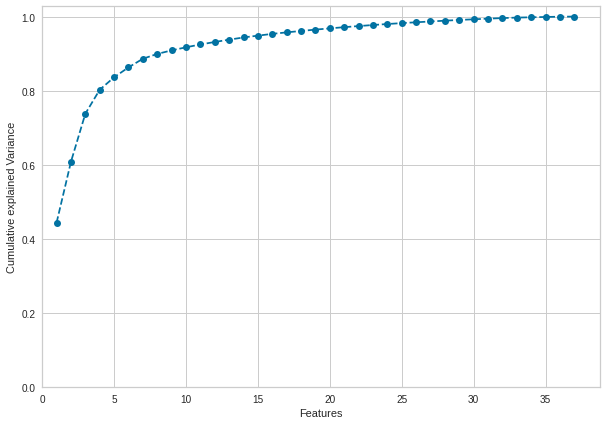

time: 386 ms (started: 2023-02-19 09:11:13 +00:00)


In [ ]:
#Visualisierung
plt.figure(figsize=(10,7))
#plt.title('Explained Variance by components')
plt.xlabel('Features')
plt.ylabel('Cumulative explained Variance')
plt.grid(True)
plt.plot(range(1,data_spaltenanzahl+1), pca.explained_variance_ratio_.cumsum(), marker='o', linestyle='--')
plt.xlim(0)
plt.ylim(0)

##90% Varianz

In [ ]:
#Berechnung
pca_90 = PCA(n_components=0.9)
components_90 = pca_90.fit_transform(data_scaled)
data_pca_90 = pd.DataFrame(components_90)

time: 102 ms (started: 2023-02-19 09:11:13 +00:00)


In [ ]:
display(data_pca_90.head())

,0,1,2,3,4,5,6,7,8
0,-1.766839,-0.917854,0.708408,0.668270,0.397554,0.607614,0.176605,-0.089657,-0.181404
1,-1.530927,-0.705357,-0.394649,0.900191,-0.063720,0.460353,0.208260,-0.209388,-0.103419
2,-1.538455,-0.927260,-0.342885,0.895578,-0.103059,0.567486,0.055932,-0.106086,-0.035116
3,-1.585155,-0.974202,-0.244643,0.316684,0.314482,0.568899,0.282306,-0.013207,-0.164202
4,-1.781889,-0.302298,-0.406021,0.520099,0.529688,0.401160,0.364118,0.022871,-0.016430


time: 31.3 ms (started: 2023-02-19 09:11:13 +00:00)


In [ ]:
labels = {
    str(i): f"PCA {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca_90.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components_90,
    labels=labels,
    dimensions=range(9),
    color=data_original["alter"]
)
fig.update_traces(diagonal_visible=False)
fig.show()

time: 763 ms (started: 2023-02-19 09:11:13 +00:00)


##70% Varianz

In [ ]:
#Berechnung
pca_70 = PCA(n_components=0.7)
components_70 = pca_70.fit_transform(data_scaled)
data_pca_70 = pd.DataFrame(components_70)

time: 89.4 ms (started: 2023-02-19 09:11:14 +00:00)


In [ ]:
display(data_pca_70.head())

,0,1,2
0,-1.766839,-0.917854,0.708408
1,-1.530927,-0.705357,-0.394649
2,-1.538455,-0.927260,-0.342885
3,-1.585155,-0.974202,-0.244643
4,-1.781889,-0.302298,-0.406021


time: 40.4 ms (started: 2023-02-19 09:11:14 +00:00)


In [ ]:
labels = {
    str(i): f"PCA {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca_70.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components_70,
    labels=labels,
    dimensions=range(3),
    color=data_original["alter"]
)
fig.update_traces(diagonal_visible=False)
fig.show()

time: 559 ms (started: 2023-02-19 09:11:14 +00:00)


#Clustering mit dem k-Means Verfahren

##Elbow-Method zur Bestimmung von k

In [ ]:
k = np.arange(2,11,1)

time: 2.65 ms (started: 2023-02-19 09:11:15 +00:00)


###Mit 100% Varianz

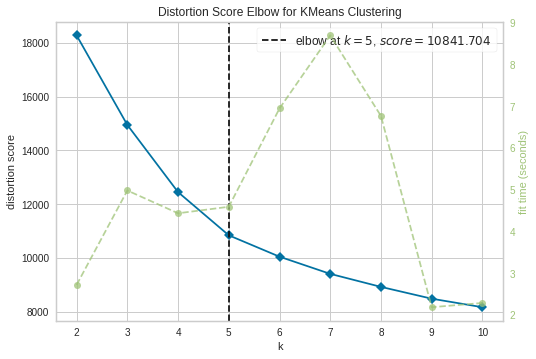

time: 44.2 s (started: 2023-02-19 09:11:15 +00:00)


In [ ]:
#Berechnung
elbow = KElbowVisualizer(KMeans(), k=k)
elbow = elbow.fit(data_scaled)
elbow.show()

In [ ]:
#optimale Clusteranzahl laut Ellbogen Methode
optimalcluster_elbow_ohne_pca_kmeans = elbow.elbow_value_
print(optimalcluster_elbow_ohne_pca_kmeans)

5
time: 1.05 ms (started: 2023-02-19 09:11:59 +00:00)


In [ ]:
#Speichern
savePickle(elbow, 'elbow')

time: 29.8 ms (started: 2023-02-19 09:11:59 +00:00)


###Mit 90% Varianz

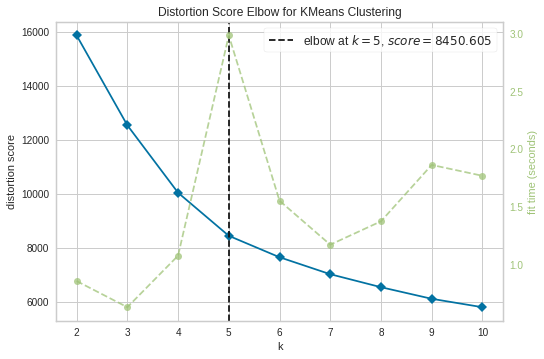

time: 13.8 s (started: 2023-02-19 09:11:59 +00:00)


In [ ]:
#Berechnung
elbow_90 = KElbowVisualizer(KMeans(), k=k)
elbow_90 = elbow_90.fit(data_pca_90)
elbow_90.show()

In [ ]:
#optimale Clusteranzahl laut Ellbogen Methode
optimalcluster_elbow_90_kmeans = elbow_90.elbow_value_
print(optimalcluster_elbow_90_kmeans)

5
time: 2.5 ms (started: 2023-02-19 09:12:13 +00:00)


In [ ]:
#Speichern
savePickle(elbow_90, 'elbow_90')

time: 22.9 ms (started: 2023-02-19 09:12:13 +00:00)


###Mit 70% Varianz

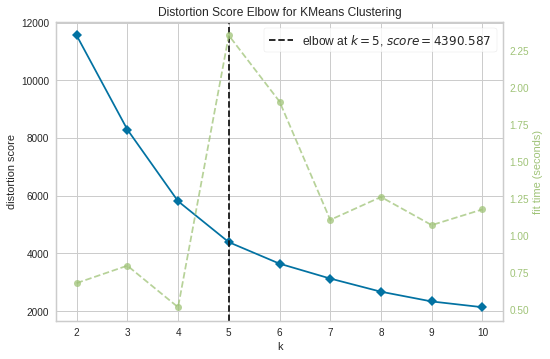

time: 11.3 s (started: 2023-02-19 09:12:13 +00:00)


In [ ]:
#Ellbogen Methode
elbow_70 = KElbowVisualizer(KMeans(), k=k)
elbow_70 = elbow_70.fit(data_pca_70)
elbow_70.show()

In [ ]:
#optimale Clusteranzahl laut Ellbogen Methode
optimalcluster_elbow_70_kmeans = elbow_70.elbow_value_
print(optimalcluster_elbow_70_kmeans)

5
time: 859 µs (started: 2023-02-19 09:12:24 +00:00)


In [ ]:
#Speichern
savePickle(elbow_70, 'elbow_70')

time: 28.6 ms (started: 2023-02-19 09:12:24 +00:00)


###Visualisierung aller 3 Varianzen in einem Diagramm

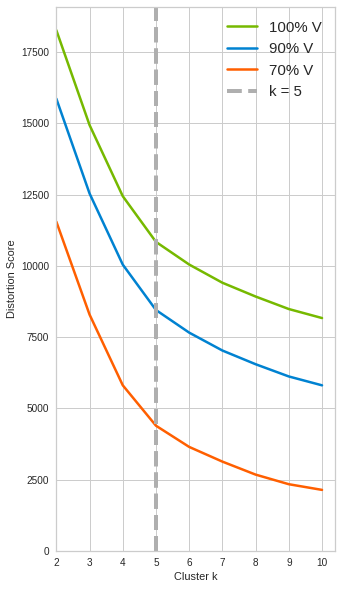

time: 233 ms (started: 2023-02-19 09:12:24 +00:00)


In [ ]:
plt.figure(figsize=(5, 10))

plt.xlabel('Cluster k')
plt.ylabel('Distortion Score')

lw = 2.5
lw_k = lw+1.5

plt.plot(elbow.k_values_, elbow.k_scores_, label = "100% V", ls="-", color="#76B900", linewidth=lw)
plt.plot(elbow_90.k_values_, elbow_90.k_scores_, label = "90% V", ls="-", color="#0082D1", linewidth=lw)
plt.plot(elbow_70.k_values_, elbow_70.k_scores_, label = "70% V", ls="-", color="#FF5F00", linewidth=lw)

plt.axvline(x = elbow.elbow_value_, color = "#AFAFAF", ls="--", linewidth=lw_k, label="k = "+str(elbow.elbow_value_))
plt.axvline(x = elbow_90.elbow_value_, color = "#AFAFAF", ls="--", linewidth=lw_k)
plt.axvline(x = elbow_70.elbow_value_, color = "#AFAFAF", ls="--", linewidth=lw_k)

plt.ylim(0)
plt.xlim(2)
plt.xticks(np.arange(2,k.max()+1,1))
plt.legend(prop={'size': 15})

plt.show()

##Silhouette Score zur Bestimmung von k

###Mit 100% Varianz

In [ ]:
#DataFrame erstellen
sScore_cluster_ohne_pca_kmeans = pd.DataFrame(columns = ["Cluster", "Silhouette_Score"])

time: 3.09 ms (started: 2023-02-19 09:12:25 +00:00)


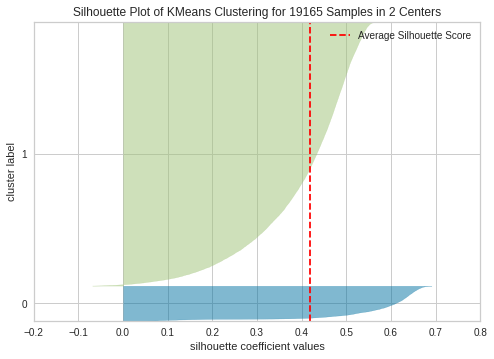

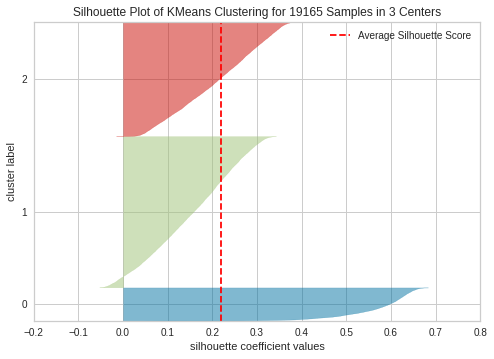

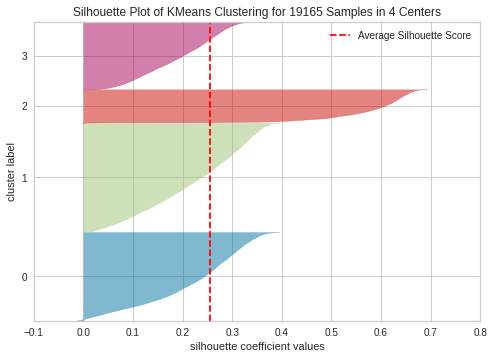

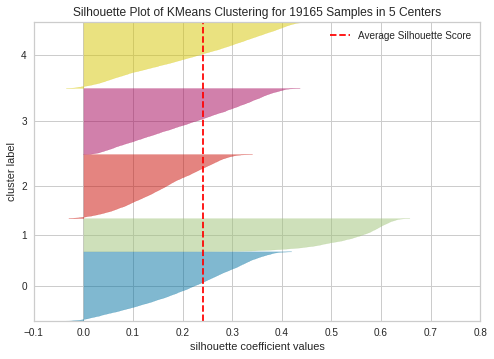

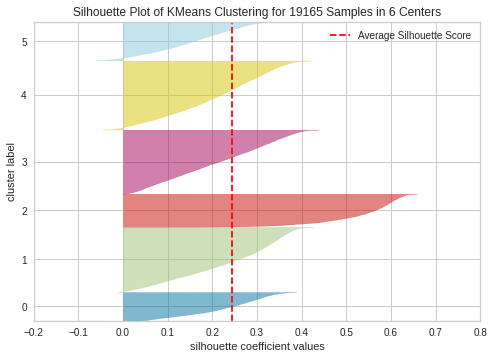

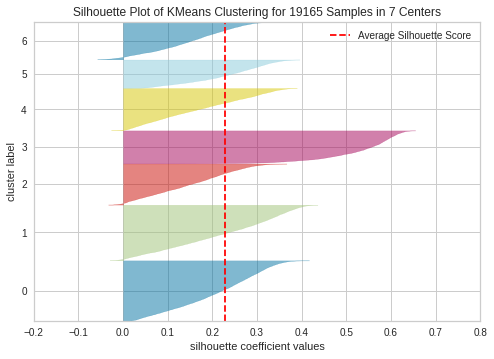

time: 1min 22s (started: 2023-02-19 09:12:25 +00:00)


In [ ]:
for i in range(2, optimalcluster_elbow_ohne_pca_kmeans+3, 1):
  #kMeans
  kmeans = KMeans(n_clusters = i, random_state=42)
  visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick')
  visualizer = visualizer.fit(data_scaled_df)

  #Werte in das DataFrame schreiben
  new_row = {"Cluster":int(i), "Silhouette_Score":visualizer.silhouette_score_.round(decimals=4)}
  sScore_cluster_ohne_pca_kmeans = sScore_cluster_ohne_pca_kmeans.append(new_row, ignore_index=True)

  visualizer.show()

  #Speichern
  filename = 'visualizer_' + str(i)
  savePickle(visualizer, filename)
  filename = 'kmeans_' + str(i)
  savePickle(kmeans, filename)

#Datentypen der Spalten festlegen
sScore_cluster_ohne_pca_kmeans = sScore_cluster_ohne_pca_kmeans.astype({'Cluster':'int', 'Silhouette_Score':'float'})

In [ ]:
#print
sScore_cluster_ohne_pca_kmeans.style.hide_index()

Cluster,Silhouette_Score
2,0.419200
3,0.220000
4,0.255000
5,0.240600
6,0.244400
7,0.227200


time: 7.35 ms (started: 2023-02-19 09:13:47 +00:00)


###Mit 90% Varianz

In [ ]:
#DataFrame für die Silhouette Scores der verschiedenen Cluster
sScore_cluster_90_kmeans = pd.DataFrame(columns = ["Cluster", "Silhouette_Score"])

time: 2.91 ms (started: 2023-02-19 09:13:47 +00:00)


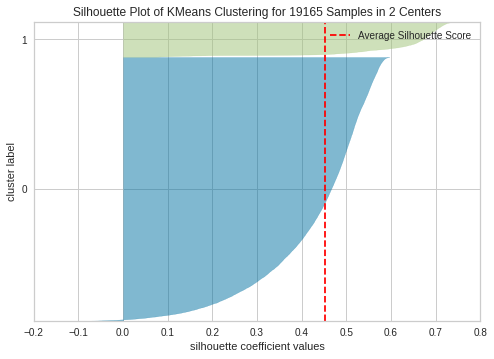

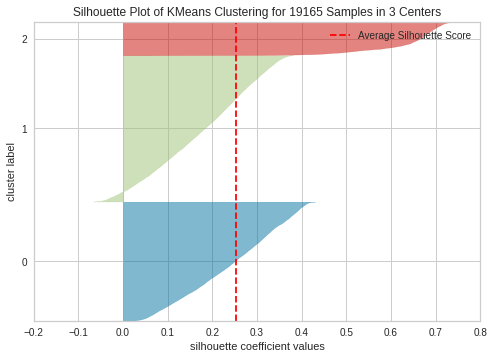

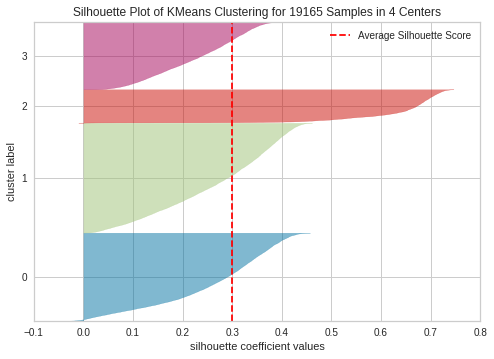

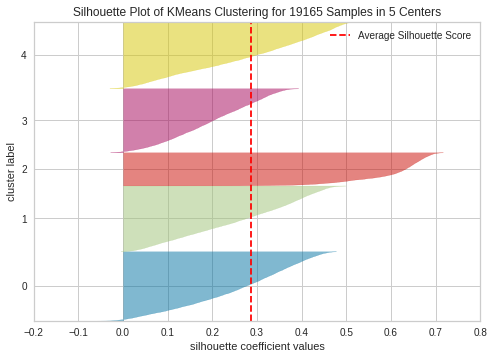

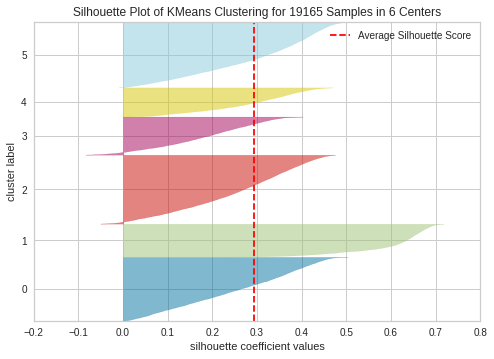

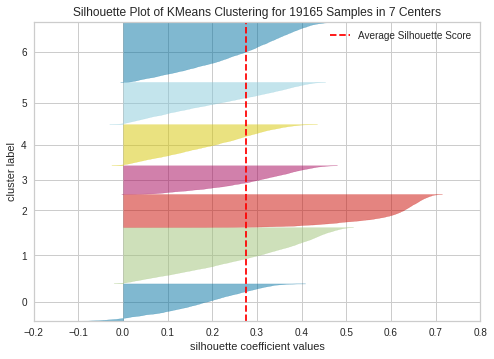



time: 1min 14s (started: 2023-02-19 09:13:47 +00:00)


In [ ]:
from yellowbrick.base import VisualizerGrid
for i in range(2, optimalcluster_elbow_90_kmeans+3, 1):
  #kMeans
  kmeans = KMeans(n_clusters = i, random_state=42)
  visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick')
  visualizer = visualizer.fit(data_pca_90)

  #Werte in das DataFrame schreiben
  new_row = {"Cluster":int(i), "Silhouette_Score": visualizer.silhouette_score_.round(decimals=4)}
  sScore_cluster_90_kmeans = sScore_cluster_90_kmeans.append(new_row, ignore_index=True)

  #Speichern
  filename = 'visualizer_90_' + str(i)
  savePickle(visualizer, filename)
  filename = 'kmeans_90_' + str(i)
  savePickle(kmeans, filename)

  #Visualisierung
  visualizer.show()
  print("\n")

#Datentypen der Spalten festlegen
sScore_cluster_90_kmeans = sScore_cluster_90_kmeans.astype({'Cluster':'int', 'Silhouette_Score':'float'})

In [ ]:
#print
sScore_cluster_90_kmeans.style.hide_index()

Cluster,Silhouette_Score
2,0.452400
3,0.252400
4,0.298800
5,0.287200
6,0.293000
7,0.276100


time: 7.57 ms (started: 2023-02-19 09:15:02 +00:00)


###Mit 70% Varianz

In [ ]:
#DataFrame für die Silhouette Scores der verschiedenen Cluster
sScore_cluster_70_kmeans = pd.DataFrame(columns = ["Cluster", "SilhouetteScore"])

time: 3.59 ms (started: 2023-02-19 09:15:02 +00:00)


Cluster Anzahl:  2
Silhouette Score:  0.5095


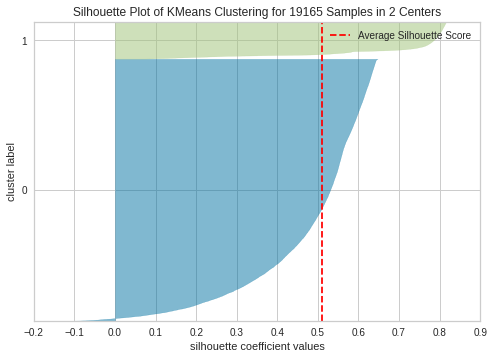



Cluster Anzahl:  3
Silhouette Score:  0.3421


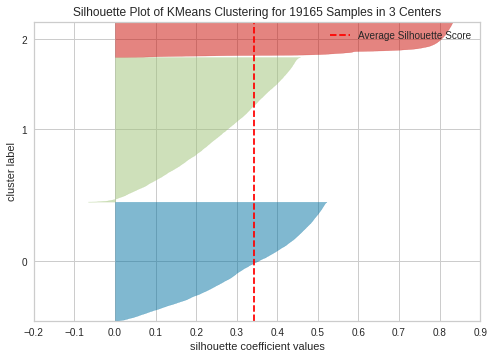



Cluster Anzahl:  4
Silhouette Score:  0.4144


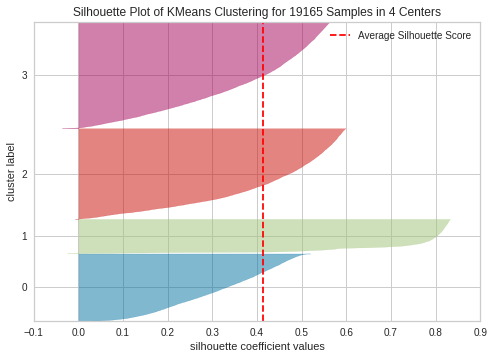



Cluster Anzahl:  5
Silhouette Score:  0.4172


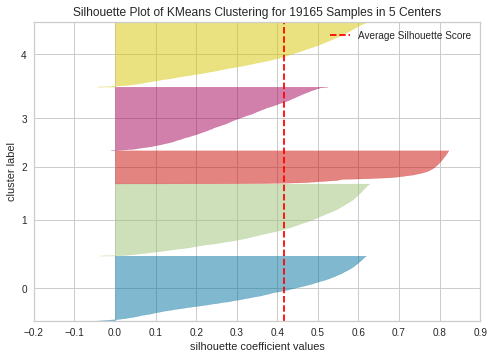



Cluster Anzahl:  6
Silhouette Score:  0.4308


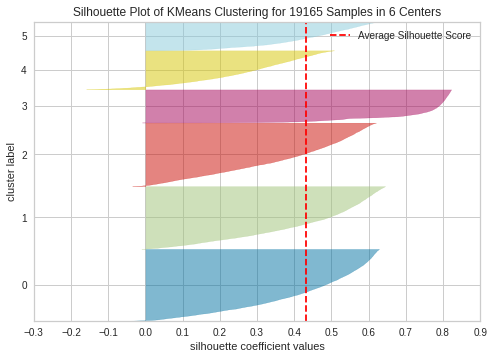



Cluster Anzahl:  7
Silhouette Score:  0.4127


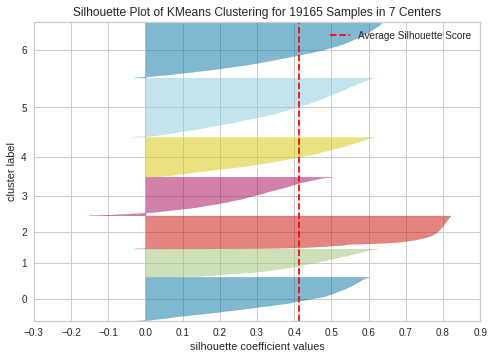



time: 1min 6s (started: 2023-02-19 09:15:02 +00:00)


In [ ]:
for i in range(2, optimalcluster_elbow_70_kmeans+3, 1):
  #kMeans
  kmeans = KMeans(n_clusters = i, random_state=42)
  visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick')
  visualizer.fit(data_pca_70)

  #Werte in das DataFrame schreiben
  new_row = {"Cluster": i, "SilhouetteScore":visualizer.silhouette_score_.round(decimals=4)}
  sScore_cluster_70_kmeans = sScore_cluster_70_kmeans.append(new_row, ignore_index=True)

  #Speichern
  filename = 'visualizer_70_' + str(i)
  savePickle(visualizer, filename)
  filename = 'kmeans_70_' + str(i)
  savePickle(kmeans, filename)

  #Visualisierung
  print("Cluster Anzahl: ", i)
  print("Silhouette Score: ", visualizer.silhouette_score_.round(decimals=4))
  visualizer.show()
  print("\n")

#Datentypen der Spalten festlegen
sScore_cluster_70_kmeans = sScore_cluster_70_kmeans.astype({'Cluster':'int', 'SilhouetteScore':'float'})

In [ ]:
#print
sScore_cluster_70_kmeans.style.hide_index()

Cluster,SilhouetteScore
2,0.509500
3,0.342100
4,0.414400
5,0.417200
6,0.430800
7,0.412700


time: 7.26 ms (started: 2023-02-19 09:16:09 +00:00)


##kMeans Clustering mit 100% Varianz

####k-Means Berechnung

In [ ]:
#specify the number of clusters we got from silhouette score
kmeans_ohne_pca = KMeans(n_clusters = optimalcluster_elbow_ohne_pca_kmeans)

#fit the scaled data
kmeans_ohne_pca = kmeans_ohne_pca.fit(data_scaled_df)

#get the cluster labels
labels_ohne_pca_kmeans = kmeans_ohne_pca.predict(data_scaled_df)

#get the centroid values
centroids_ohne_pca_kmeans = kmeans_ohne_pca.cluster_centers_

#get the cluster values
clusters_ohne_pca_kmeans = kmeans_ohne_pca.labels_.tolist()

time: 1.2 s (started: 2023-02-19 09:16:09 +00:00)


In [ ]:
#Daten kopieren
data_ohne_pca_kmeans = data_scaled_df.copy()

#Cluster-Spalte hinzufügen
data_ohne_pca_kmeans['clusters'] = clusters_ohne_pca_kmeans

#Namen der Spieler hinzufügen
data_ohne_pca_kmeans['player_names'] = player_names

#Spalten umbenennen
data_ohne_pca_kmeans.columns = [f"pca_{i+1}" for i in range(pca.n_components_)] + ['clusters', 'player_names']

time: 17.2 ms (started: 2023-02-19 09:16:10 +00:00)


In [ ]:
#Speichern
savePickle(kmeans_ohne_pca, "kmeans_ohne_pca")
saveCSV(data_ohne_pca_kmeans, "data_ohne_pca_kmeans")

time: 1.17 s (started: 2023-02-19 09:16:10 +00:00)


####Visualisierung

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



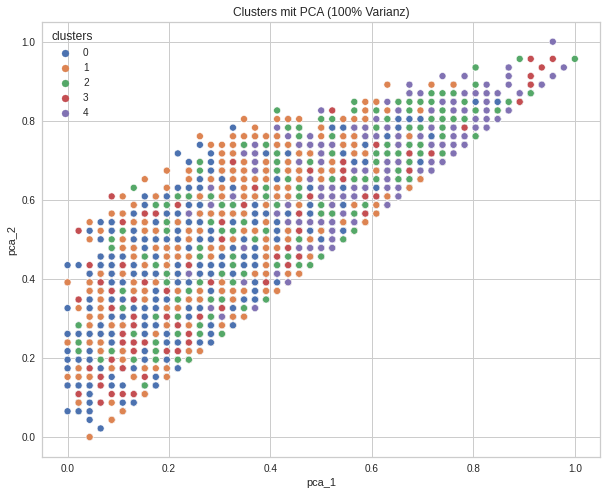

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



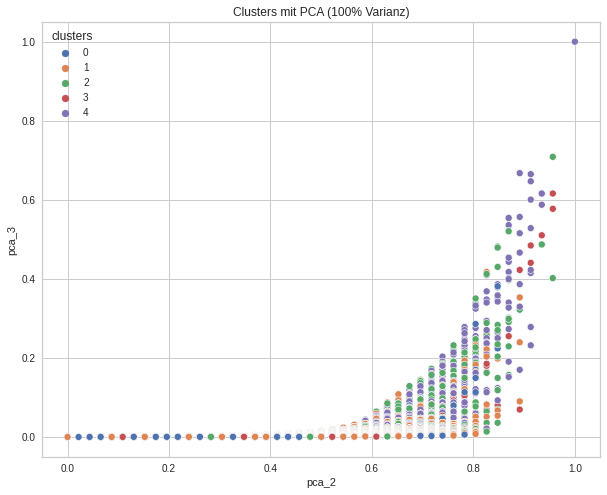

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



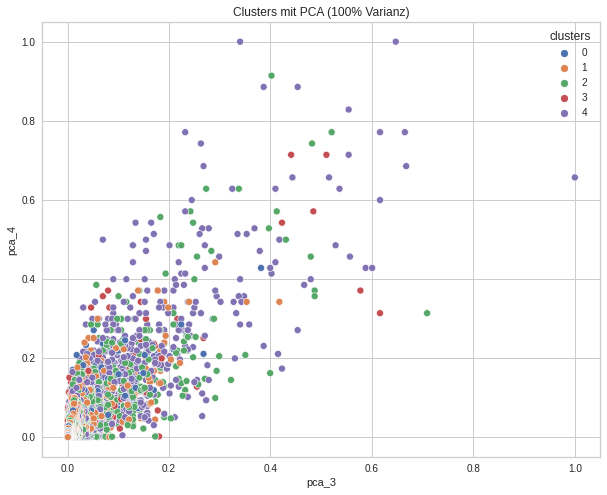

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



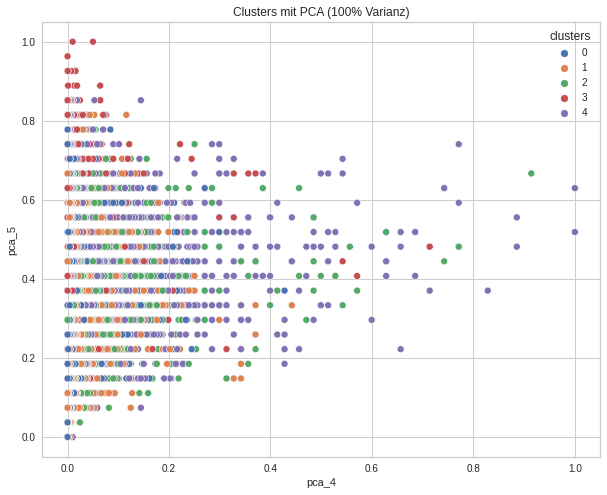

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



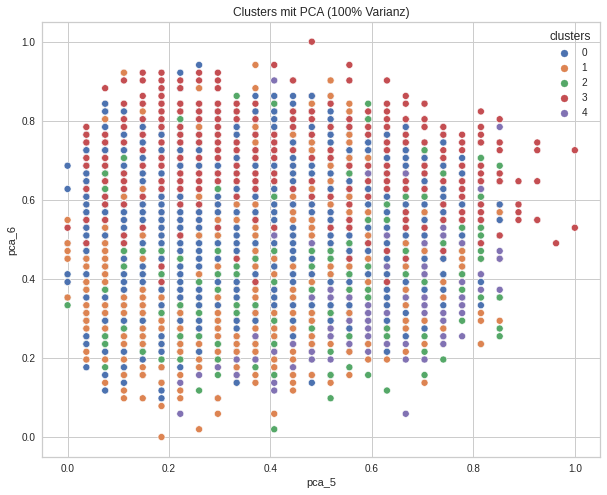

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



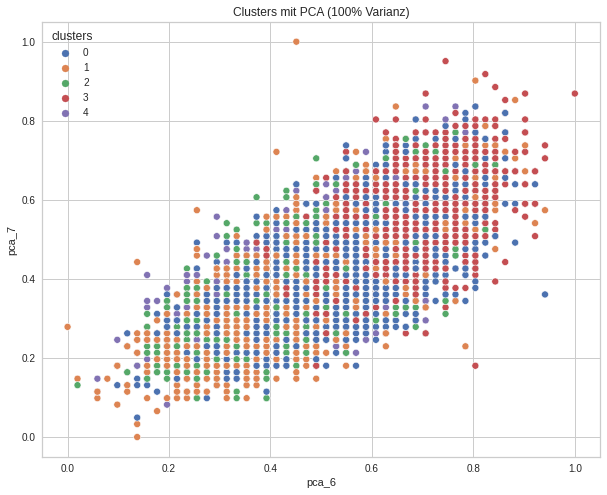

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



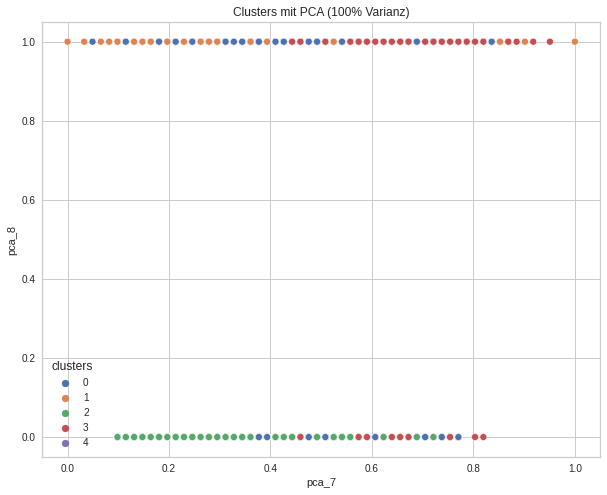

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



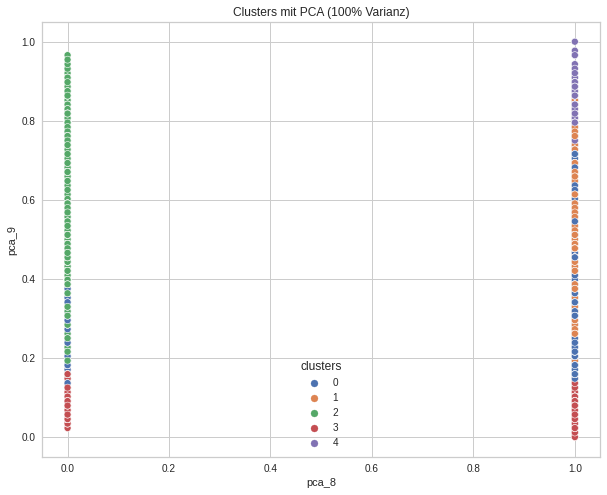

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



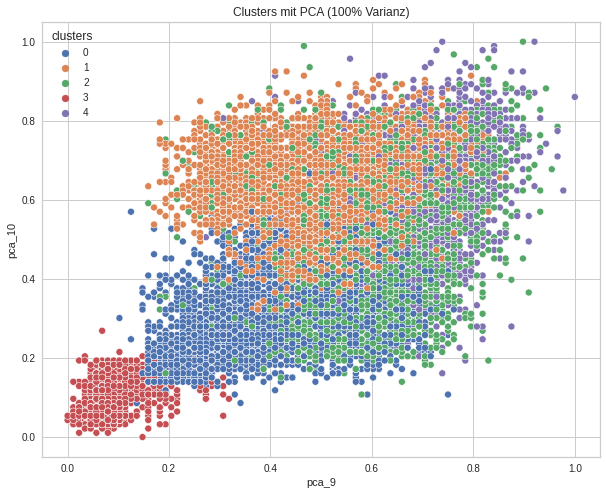

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



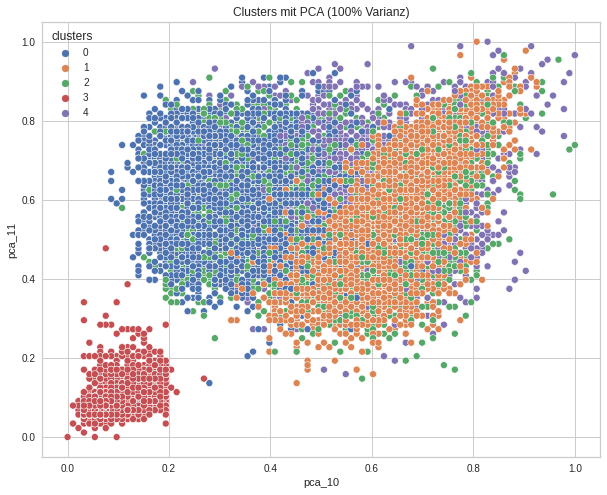

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



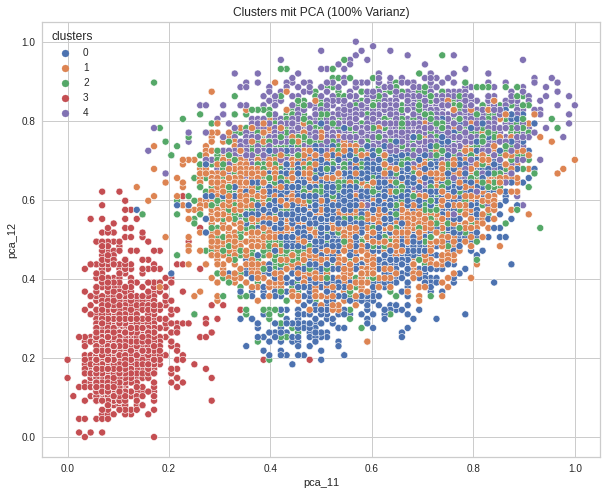

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



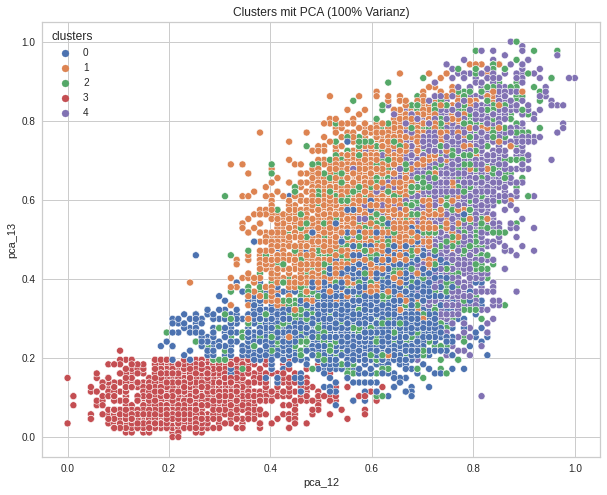

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



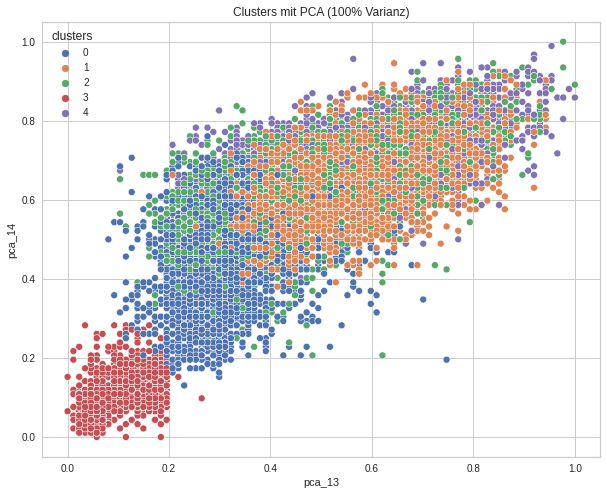

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



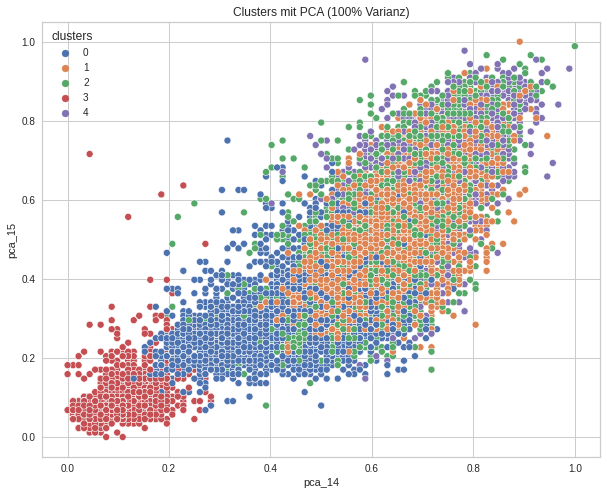

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



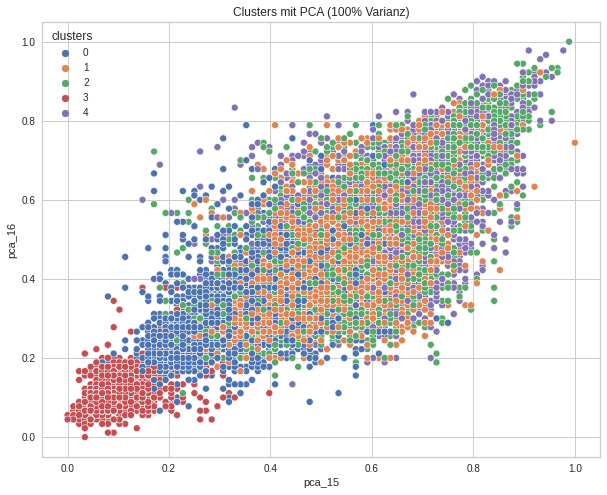

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



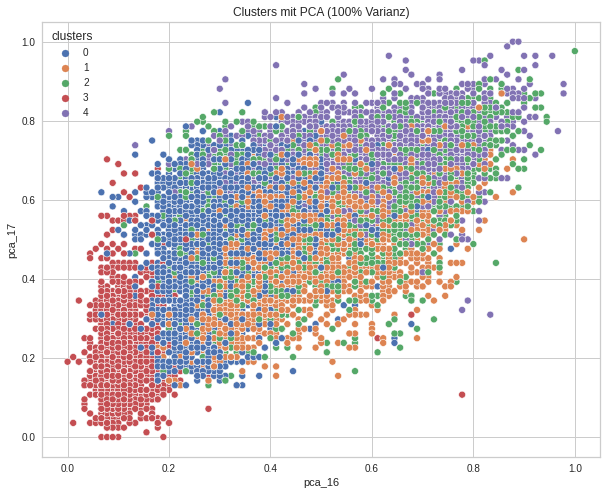

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



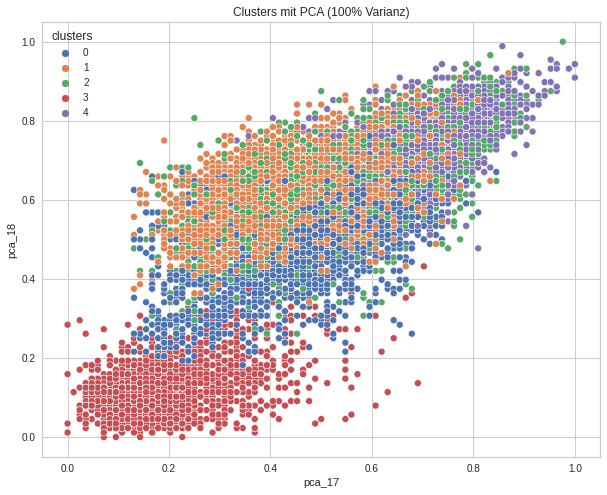

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



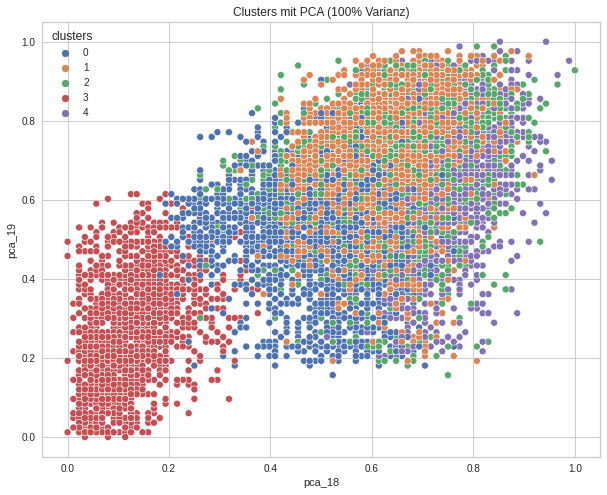

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



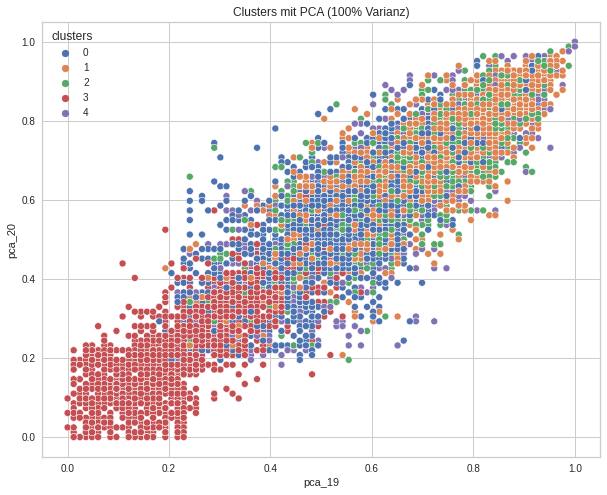

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



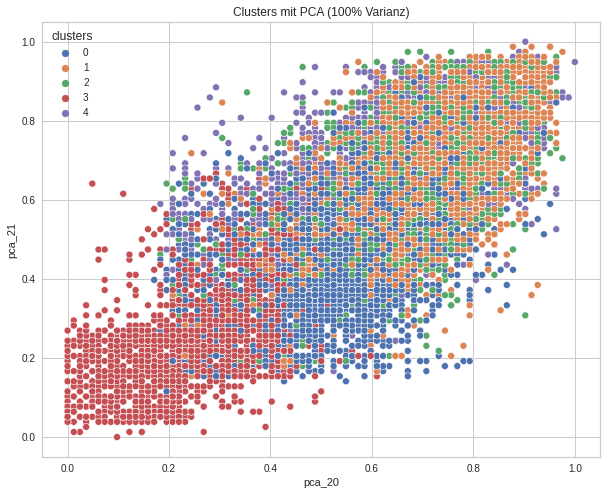

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



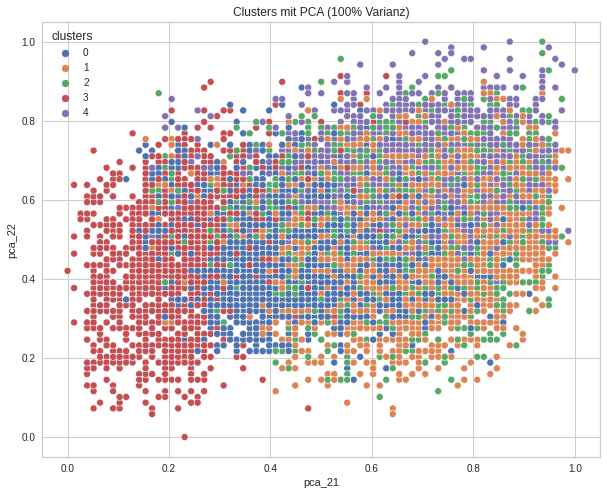

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



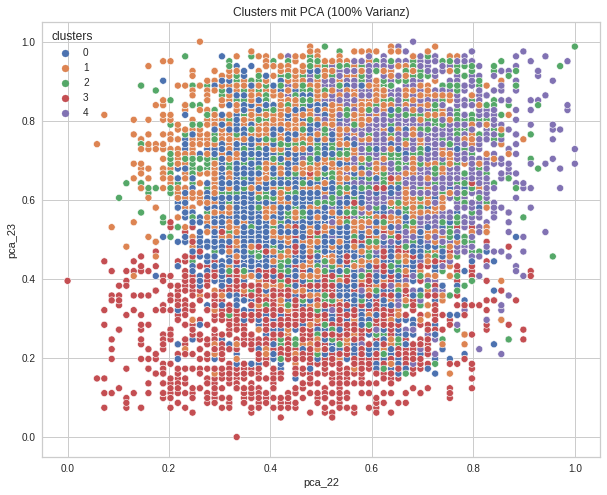

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



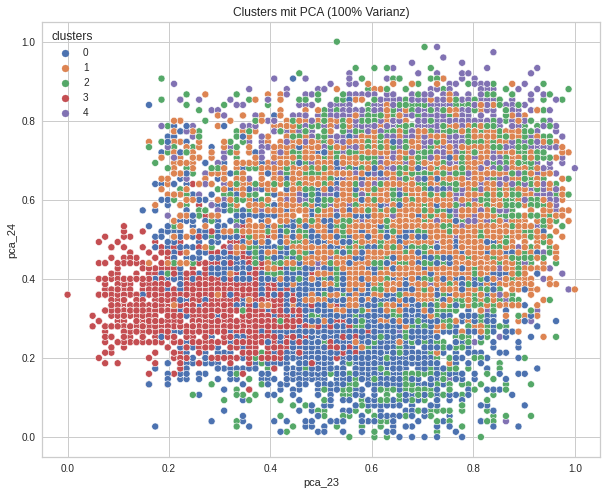

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



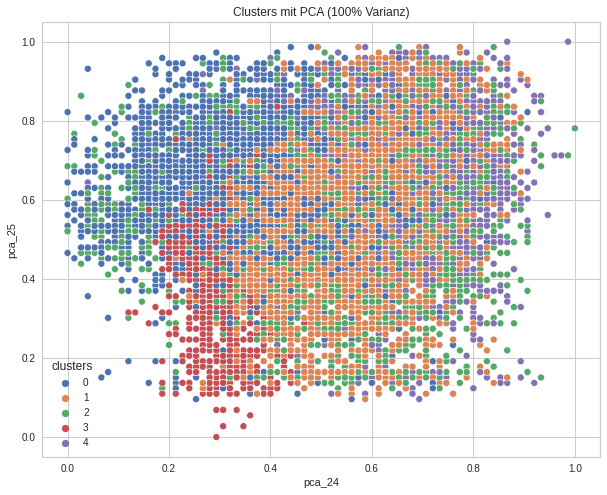

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



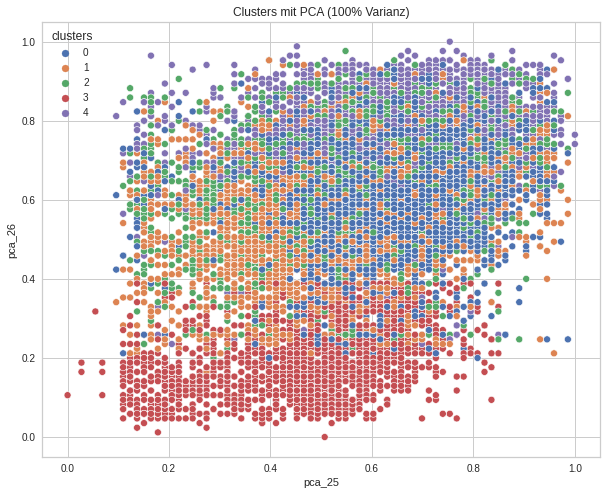

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



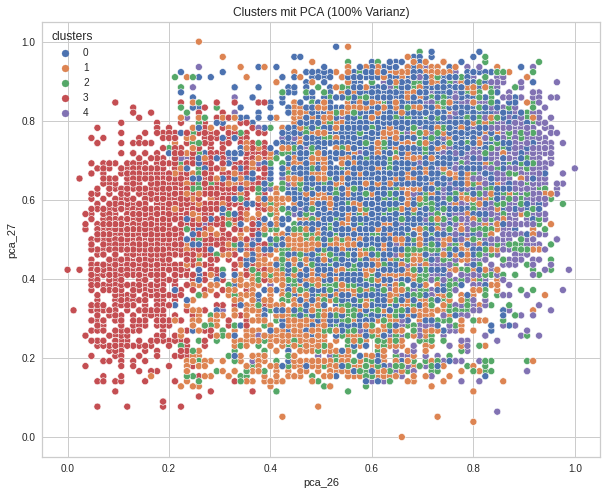

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



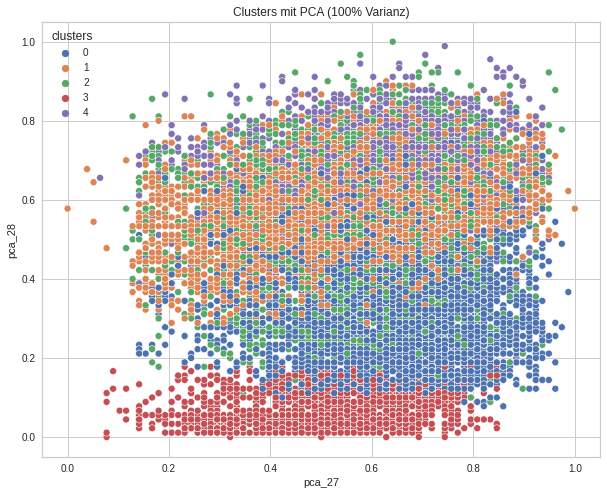

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



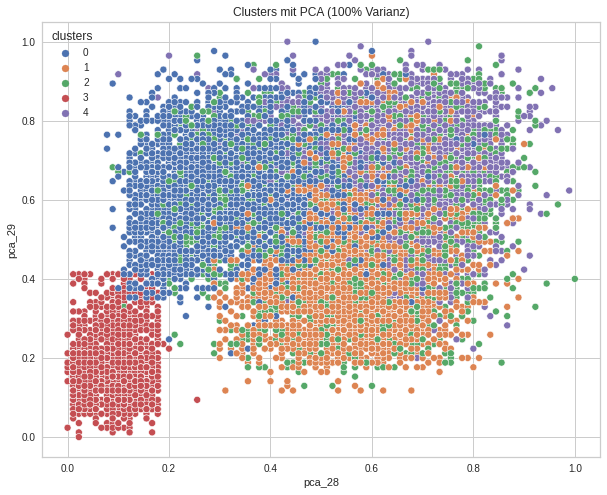

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



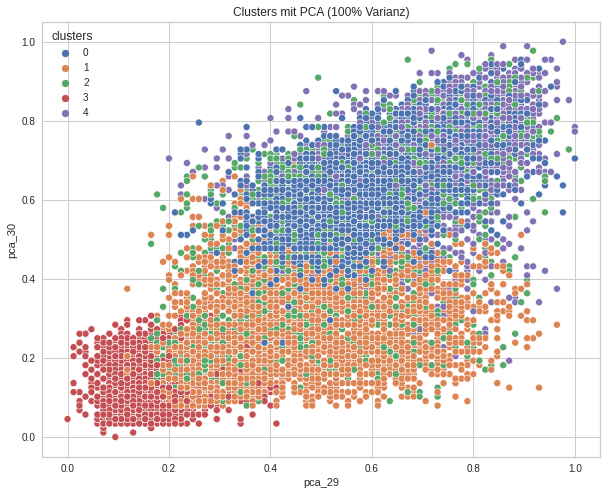

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



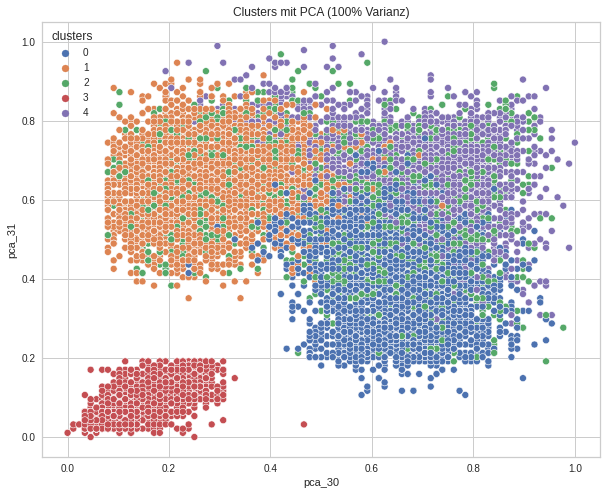

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



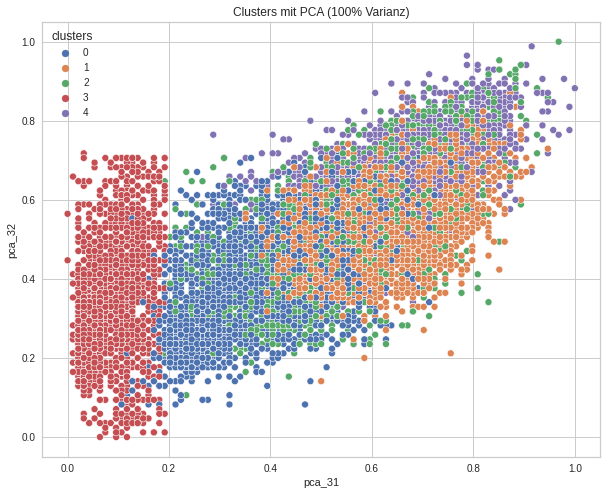

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



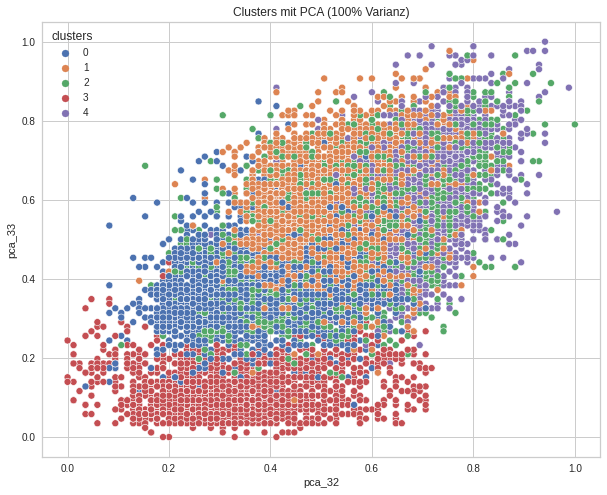

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



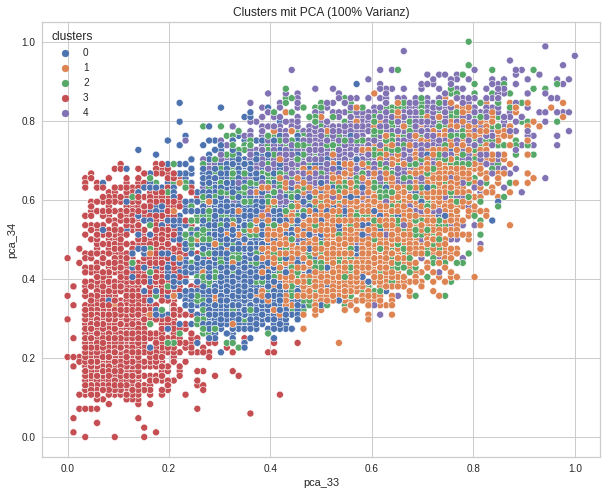

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



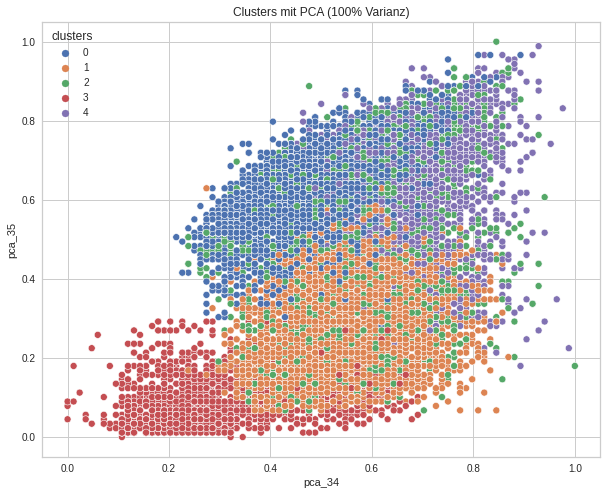

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



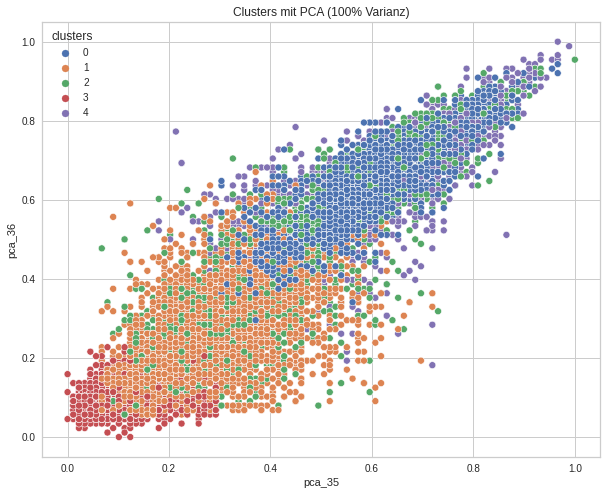

time: 56.6 s (started: 2023-02-19 09:16:41 +00:00)


In [ ]:
#Nicht alle Spaltenkombinationen werden geplottet
for i in range(1, pca.n_components_-1):
  #Spalten für das Diagramm wählen
  x_axis = data_ohne_pca_kmeans['pca_'+ str(i)] #component/column x in table
  y_axis = data_ohne_pca_kmeans['pca_'+ str(i+1)] #component/column y in table

  #Diagramm Settings
  plt.figure(figsize=(10,8))
  sns.scatterplot(x_axis, y_axis, hue=data_ohne_pca_kmeans['clusters'], palette ="deep")
  plt.title('Clusters mit PCA (100% Varianz)')

  #Anzeigen
  plt.show()

##kMeans Clustering mit 90% Varianz

####K-Means Berechnung

In [ ]:
#specify the number of clusters we got from silhouette score
kmeans_90 = KMeans(n_clusters = optimalcluster_elbow_90_kmeans)

#fit the scaled data
kmeans_90 = kmeans_90.fit(data_pca_90)

#get the cluster labels
labels_90_kmeans = kmeans_90.predict(data_pca_90)

#get the centroid values
centroids_90_kmeans = kmeans_90.cluster_centers_

#get the cluster values
clusters_90_kmeans = kmeans_90.labels_.tolist()

time: 763 ms (started: 2023-02-19 09:17:40 +00:00)


In [ ]:
#Daten kopieren
data_pca_90_kmeans = data_pca_90.copy()

#Cluster-Spalte hinzufügen
data_pca_90_kmeans['clusters'] = clusters_90_kmeans

#Namen der Spieler hinzufügen
data_pca_90_kmeans['player_names'] = player_names

#Spalten umbenennen
data_pca_90_kmeans.columns = [f"pca_{i+1}" for i in range(pca_90.n_components_)] + ['clusters', 'player_names']

time: 22.1 ms (started: 2023-02-19 09:17:40 +00:00)


In [ ]:
#Speichern
savePickle(kmeans_90, "kmeans_90")
saveCSV(data_pca_90_kmeans, "data_pca_90_kmeans")

time: 325 ms (started: 2023-02-19 09:17:41 +00:00)


####Visualisierung

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



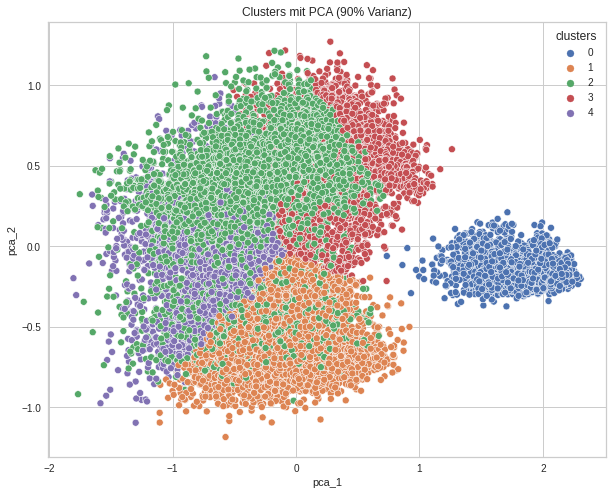

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



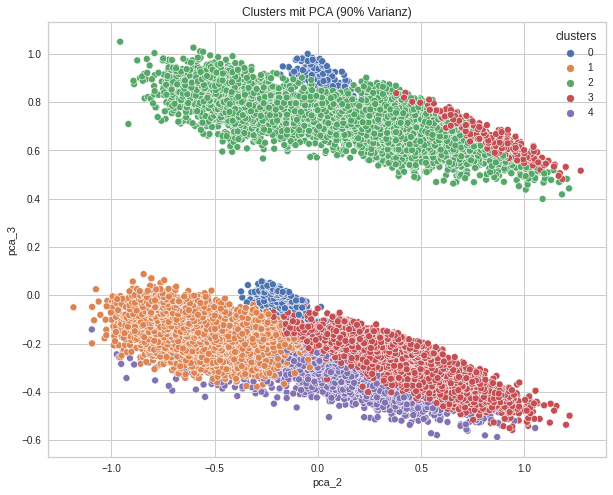

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



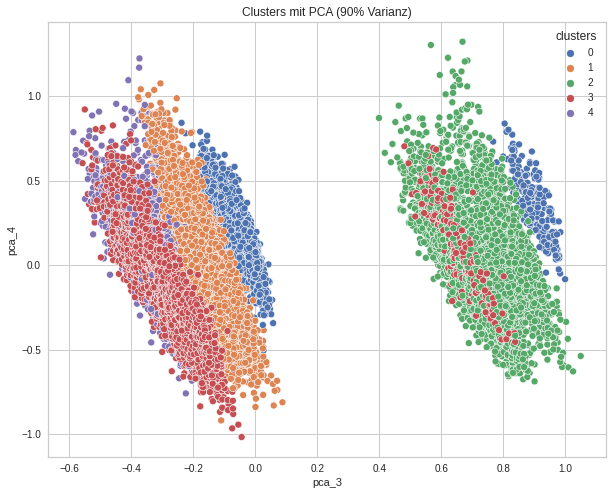

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



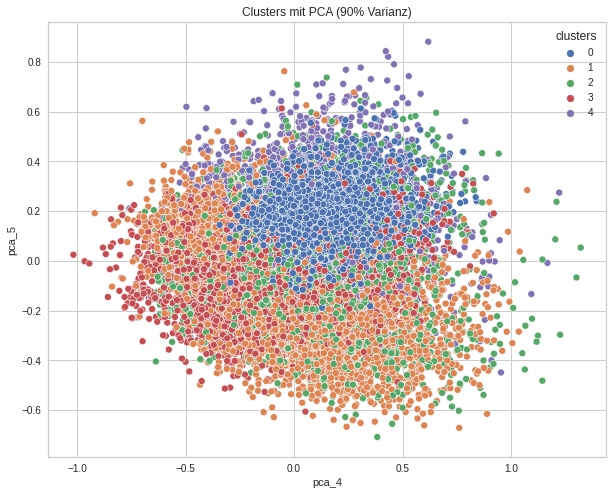

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



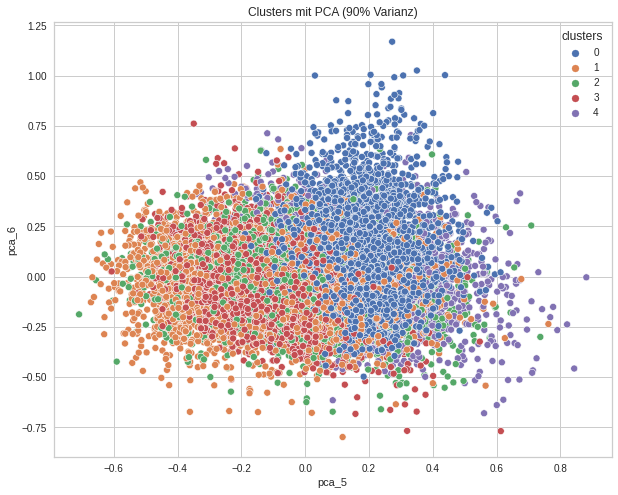

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



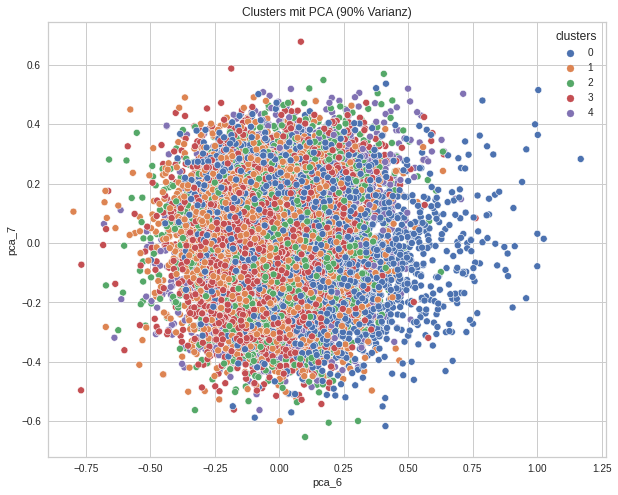

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



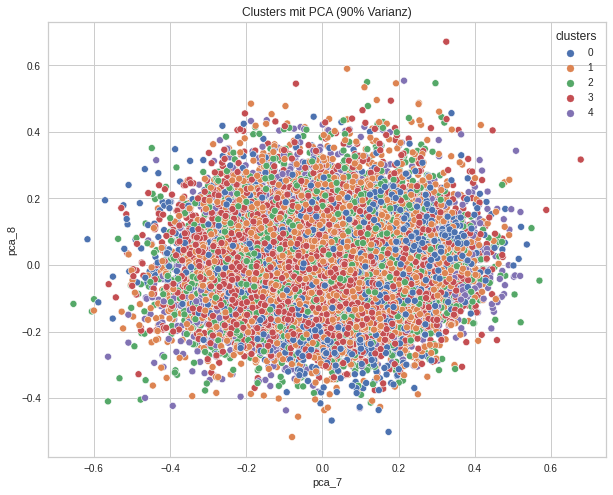

time: 7.94 s (started: 2023-02-19 09:17:41 +00:00)


In [ ]:
#Nicht alle Spaltenkombinationen werden geplottet
for i in range(1, pca_90.n_components_-1):
  #Spalten für das Diagramm wählen
  x_axis = data_pca_90_kmeans['pca_'+ str(i)] #component/column x in table
  y_axis = data_pca_90_kmeans['pca_'+ str(i+1)] #component/column y in table

  #Diagramm Settings
  plt.figure(figsize=(10,8))
  sns.scatterplot(x_axis, y_axis, hue=data_pca_90_kmeans['clusters'], palette ="deep")
  plt.title('Clusters mit PCA (90% Varianz)')

  #Anzeigen
  plt.show()

##kMeans Clustering mit 70% Varianz

####Berechnung

In [ ]:
#specify the number of clusters we got from silhouette score
kmeans_70 = KMeans(n_clusters = optimalcluster_elbow_70_kmeans)

#fit the scaled data
kmeans_70 = kmeans_70.fit(data_pca_70)

#get the cluster labels
labels_70_kmeans = kmeans_70.predict(data_pca_70)

#get the centroid values
centroids_70_kmeans = kmeans_70.cluster_centers_

#get the cluster values
clusters_70_kmeans = kmeans_70.labels_.tolist()

time: 1.02 s (started: 2023-02-19 09:17:49 +00:00)


In [ ]:
#copy data
data_pca_70_kmeans = data_pca_70.copy()

#Cluster-Spalte hinzufügen
data_pca_70_kmeans['cluster'] = clusters_70_kmeans

#Namen der Spieler hinzufügen
data_pca_70_kmeans['player_names'] = player_names

#Spalten umbenennen
data_pca_70_kmeans.columns = [f"pca_{i+1}" for i in range(pca_70.n_components_)] + ['cluster', 'player_names']

time: 22.5 ms (started: 2023-02-19 09:17:50 +00:00)


In [ ]:
#Speichern
savePickle(kmeans_70, "kmeans_70")
saveCSV(data_pca_70_kmeans, "data_pca_70_kmeans")

time: 130 ms (started: 2023-02-19 09:17:50 +00:00)


####Visualisierung

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



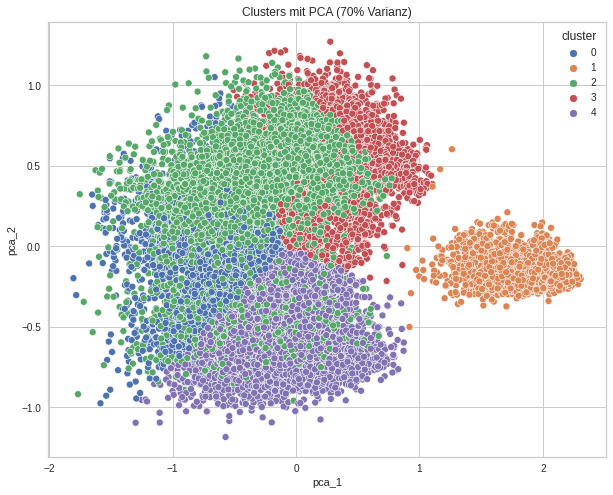

time: 905 ms (started: 2023-02-19 09:17:50 +00:00)


In [ ]:
#Nicht alle Spaltenkombinationen werden geplottet
for i in range(1, pca_70.n_components_-1):
  #Spalten für das Diagramm wählen
  x_axis = data_pca_70_kmeans['pca_'+ str(i)]
  y_axis = data_pca_70_kmeans['pca_'+ str(i+1)]

  #Diagramm Settings
  plt.figure(figsize=(10,8))
  sns.scatterplot(x_axis, y_axis, hue=data_pca_70_kmeans['cluster'], palette ="deep")
  plt.title('Clusters mit PCA (70% Varianz)')

  #Anzeigen
  plt.show()

##Grid Search

In [ ]:
k_maxrange = 11

time: 621 µs (started: 2023-02-19 09:17:51 +00:00)


###100% Varianz

####Berechnung

In [ ]:
#Arrays zum speichern der Scores
kmeans_ohne_pca_silhouette = []
kmeans_ohne_pca_davies = []
kmeans_ohne_pca_calinski = []
kmeans_ohne_pca_cluster = []

time: 1.08 ms (started: 2023-02-19 09:17:51 +00:00)


In [ ]:
#Berechnung kmeans mit verschiedener Clusteranzahl und Performance Metriken
for k in np.arange(2, k_maxrange):
  #kmeans
  kmeans = KMeans(n_clusters = k)
  kmeans = kmeans.fit(data_scaled_df)
  
  #Clusteranzahl hinzufügen
  kmeans_ohne_pca_cluster.append(len(np.unique(kmeans.labels_)))

  #Performance Metriken berechnen
  kmeans_ohne_pca_silhouette.append(silhouette_score(data_scaled_df, kmeans.labels_))
  kmeans_ohne_pca_davies.append(davies_bouldin_score(data_scaled_df, kmeans.labels_))
  kmeans_ohne_pca_calinski.append(calinski_harabasz_score(data_scaled_df, kmeans.labels_))

time: 1min 11s (started: 2023-02-19 09:17:51 +00:00)


In [ ]:
#DataFrames erstellen zum plotten
kmeans_ohne_pca_heatmap_df_silhouette = pd.DataFrame(kmeans_ohne_pca_silhouette, index=kmeans_ohne_pca_cluster, columns=["silhouette_score"])
kmeans_ohne_pca_heatmap_df_davies = pd.DataFrame(kmeans_ohne_pca_davies, index=kmeans_ohne_pca_cluster, columns=["davies_bouldin_score"])
kmeans_ohne_pca_heatmap_df_calinski = pd.DataFrame(kmeans_ohne_pca_calinski, index=kmeans_ohne_pca_cluster, columns=["calinski_harabasz_score"])

time: 2.9 ms (started: 2023-02-19 09:19:02 +00:00)


In [ ]:
kmeans_ohne_pca_heatmap_df_silhouette.transpose()

,2,3,4,5,6,7,8,9,10
silhouette_score,0.419377,0.219918,0.254972,0.240649,0.244426,0.227175,0.232963,0.213986,0.20383


time: 21.4 ms (started: 2023-02-19 09:19:02 +00:00)


In [ ]:
#Save Files
savePickle(kmeans_ohne_pca_heatmap_df_silhouette, "kmeans_ohne_pca_heatmap_df_silhouette")
savePickle(kmeans_ohne_pca_heatmap_df_davies, "kmeans_ohne_pca_heatmap_df_davies")
savePickle(kmeans_ohne_pca_heatmap_df_calinski, "kmeans_ohne_pca_heatmap_df_calinski")

time: 852 ms (started: 2023-02-19 09:19:02 +00:00)


####Visualisierung

In [ ]:
size = (4,12)

time: 716 µs (started: 2023-02-19 09:19:03 +00:00)


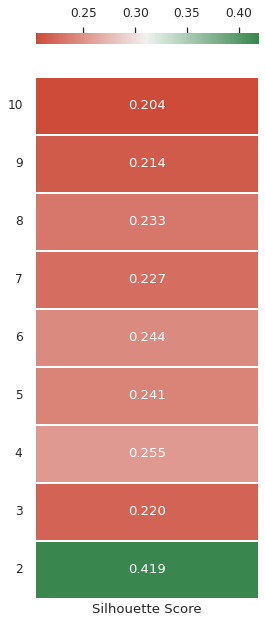

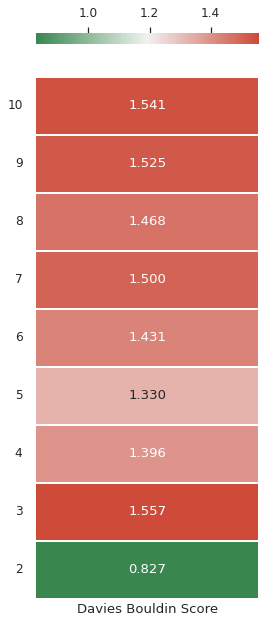

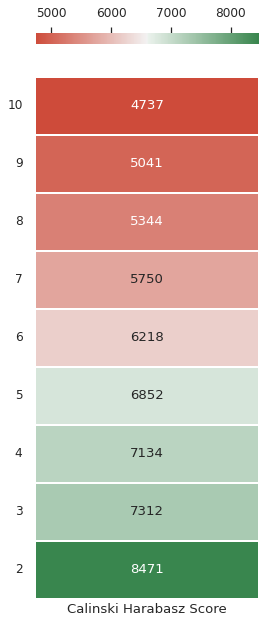

time: 1.2 s (started: 2023-02-19 09:19:03 +00:00)


In [ ]:
#Farbskala einstellen
#h_neg, h_pos, s, l
cmp = sns.diverging_palette(135, 16, s=75, as_cmap=True)
cmp_r = sns.diverging_palette(16, 135, as_cmap=True)
sns.set(font_scale=1.1)

#Visualisierung silhouette_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_ohne_pca_heatmap_df_silhouette,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.3f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.tick_params(rotation=0)
ax.invert_yaxis()
ax.set_xlabel("Silhouette Score")

#-----------------------------------------------------------------

#Visualisierung davies_bouldin_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_ohne_pca_heatmap_df_davies,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp,
                 fmt = '0.3f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.invert_yaxis()
ax.tick_params(rotation=0)
ax.set_xlabel("Davies Bouldin Score")

#-----------------------------------------------------------------

#Visualisierung calinski_harabasz_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_ohne_pca_heatmap_df_calinski,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.0f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.tick_params(rotation=0)
ax.invert_yaxis()
ax.set_xlabel("Calinski Harabasz Score")

plt.show()

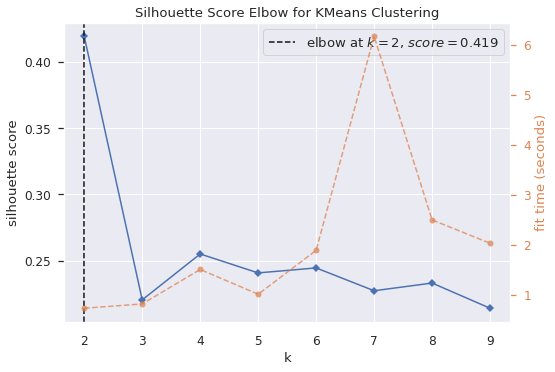

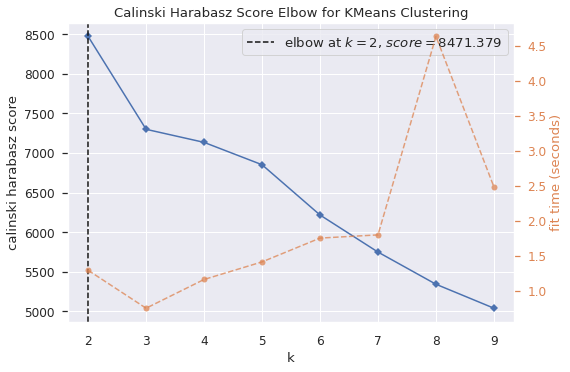

time: 1min 20s (started: 2023-02-19 09:19:04 +00:00)


In [ ]:
#Visualisierung silhouette_score
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10), metric='silhouette', timings= True)
visualizer.fit(data_scaled_df)
visualizer.show()

#-----------------------------------------------------------------

#Visualisierung calinski_harabasz_score
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10), metric='calinski_harabasz', timings= True)
visualizer.fit(data_scaled_df)
visualizer.show()

####Performance Metriken

In [ ]:
#Performance Metriken
performance_kmeans_ohne_pca_silhouette = max(kmeans_ohne_pca_heatmap_df_silhouette['silhouette_score'])
performance_kmeans_ohne_pca_davies = max(kmeans_ohne_pca_heatmap_df_davies['davies_bouldin_score'])
performance_kmeans_ohne_pca_calinski = max(kmeans_ohne_pca_heatmap_df_calinski['calinski_harabasz_score'])

#Cluster
performance_kmeans_ohne_pca_cluster = kmeans_ohne_pca_heatmap_df_silhouette.index[kmeans_ohne_pca_heatmap_df_silhouette['silhouette_score'] == performance_kmeans_ohne_pca_silhouette].tolist()[0]

time: 4.86 ms (started: 2023-02-19 09:20:25 +00:00)


###90% Varianz

####Berechnung

In [ ]:
#Arrays zum speichern der Scores
kmeans_90_silhouette = []
kmeans_90_davies = []
kmeans_90_calinski = []
kmeans_90_cluster = []

time: 791 µs (started: 2023-02-19 09:20:25 +00:00)


In [ ]:
#Berechnung kMeans mit verschiedener Clusteranzahl und Performance Metriken
for k in np.arange(2, k_maxrange):
  #kmeans
  kmeans = KMeans(n_clusters = k)
  kmeans = kmeans.fit(data_pca_90)
  
  #Clusteranzahl hinzufügen
  kmeans_90_cluster.append(len(np.unique(kmeans.labels_)))

  #Performance Metriken berechnen
  kmeans_90_silhouette.append(silhouette_score(data_pca_90, kmeans.labels_))
  kmeans_90_davies.append(davies_bouldin_score(data_pca_90, kmeans.labels_))
  kmeans_90_calinski.append(calinski_harabasz_score(data_pca_90, kmeans.labels_))

time: 57.5 s (started: 2023-02-19 09:20:25 +00:00)


In [ ]:
#DataFrames für die Heatmap erstellen
kmeans_90_heatmap_df_silhouette = pd.DataFrame(kmeans_90_silhouette, index=kmeans_90_cluster, columns=["silhouette_score"])
kmeans_90_heatmap_df_davies = pd.DataFrame(kmeans_90_davies, index=kmeans_90_cluster, columns=["davies_bouldin_score"])
kmeans_90_heatmap_df_calinski = pd.DataFrame(kmeans_90_calinski, index=kmeans_90_cluster, columns=["calinski_harabasz_score"])

time: 5.11 ms (started: 2023-02-19 09:21:22 +00:00)


In [ ]:
#Save Files
savePickle(kmeans_90_heatmap_df_silhouette, "kmeans_90_heatmap_df_silhouette")
savePickle(kmeans_90_heatmap_df_davies, "kmeans_90_heatmap_df_davies")
savePickle(kmeans_90_heatmap_df_calinski, "kmeans_90_heatmap_df_calinski")

time: 889 ms (started: 2023-02-19 09:21:22 +00:00)


####Visualisierung

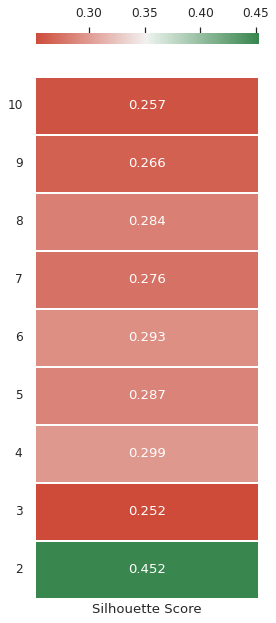

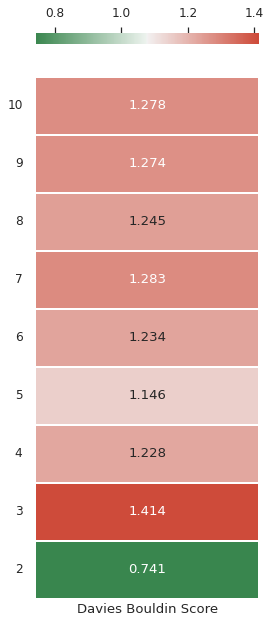

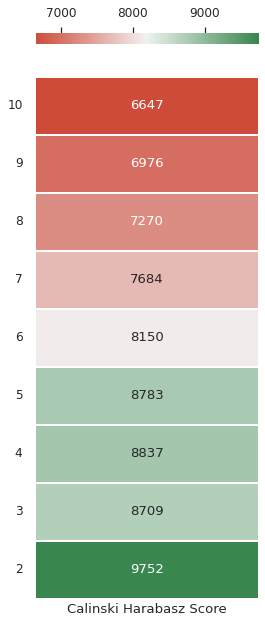

time: 1.28 s (started: 2023-02-19 09:21:23 +00:00)


In [ ]:
#Farbskala einstellen
cmp = sns.diverging_palette(135, 16, as_cmap=True)
cmp_r = sns.diverging_palette(16, 135, as_cmap=True)
sns.set(font_scale=1.1)

#Visualisierung silhouette_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_90_heatmap_df_silhouette,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.3f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.tick_params(rotation=0)
ax.invert_yaxis()
ax.set_xlabel("Silhouette Score")

#-----------------------------------------------------------------

#Visualisierung davies_bouldin_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_90_heatmap_df_davies,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp,
                 fmt = '0.3f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.invert_yaxis()
ax.tick_params(rotation=0)
ax.set_xlabel("Davies Bouldin Score")

#-----------------------------------------------------------------

#Visualisierung calinski_harabasz_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_90_heatmap_df_calinski,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.0f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.tick_params(rotation=0)
ax.invert_yaxis()
ax.set_xlabel("Calinski Harabasz Score")

plt.show()

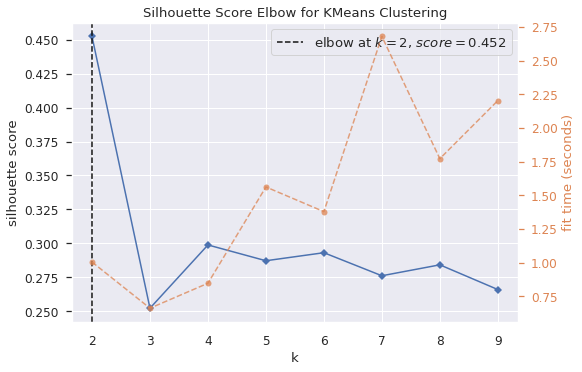

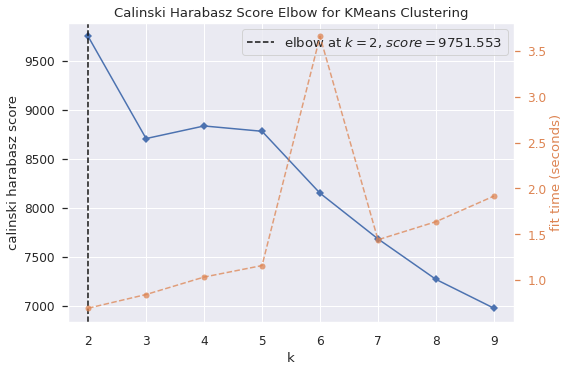

time: 1min 7s (started: 2023-02-19 09:21:25 +00:00)


In [ ]:
#https://towardsdatascience.com/cheat-sheet-to-implementing-7-methods-for-selecting-optimal-number-of-clusters-in-python-898241e1d6ad

#Visualisierung silhouette_score
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10), metric='silhouette', timings= True)
visualizer.fit(data_pca_90)
visualizer.show()

#-------------------------------------------------------------------------------

#Visualisierung calinski_harabasz_score
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10), metric='calinski_harabasz', timings= True)
visualizer.fit(data_pca_90)
visualizer.show()

####Performance Metriken

In [ ]:
#Performance Metriken
performance_kmeans_90_silhouette = max(kmeans_90_heatmap_df_silhouette['silhouette_score'])
performance_kmeans_90_davies = max(kmeans_90_heatmap_df_davies['davies_bouldin_score'])
performance_kmeans_90_calinski = max(kmeans_90_heatmap_df_calinski['calinski_harabasz_score'])

#Cluster
performance_kmeans_90_cluster = kmeans_90_heatmap_df_silhouette.index[kmeans_90_heatmap_df_silhouette['silhouette_score'] == performance_kmeans_90_silhouette].tolist()[0]

time: 5.14 ms (started: 2023-02-19 09:22:33 +00:00)


###70% Varianz

####Berechnung

In [ ]:
#Arrays zum speichern der Scores
kmeans_70_silhouette = []
kmeans_70_davies = []
kmeans_70_calinski = []
kmeans_70_cluster = []

time: 1.1 ms (started: 2023-02-19 09:22:33 +00:00)


In [ ]:
#Berechnung kmeans mit verschiedener Clusteranzahl und Performance Metriken
for k in np.arange(2, k_maxrange):
  #kmeans
  kmeans = KMeans(n_clusters = k)
  kmeans = kmeans.fit(data_pca_70)
  
  #Clusteranzahl hinzufügen
  kmeans_70_cluster.append(len(np.unique(kmeans.labels_)))

  #Performance Metriken berechnen
  kmeans_70_silhouette.append(silhouette_score(data_pca_70, kmeans.labels_))
  kmeans_70_davies.append(davies_bouldin_score(data_pca_70, kmeans.labels_))
  kmeans_70_calinski.append(calinski_harabasz_score(data_pca_70, kmeans.labels_))

time: 57.4 s (started: 2023-02-19 09:22:33 +00:00)


In [ ]:
#DataFrames erstellen zum plotten
kmeans_70_heatmap_df_silhouette = pd.DataFrame(kmeans_70_silhouette, index=kmeans_70_cluster, columns=["silhouette_score"])
kmeans_70_heatmap_df_davies = pd.DataFrame(kmeans_70_davies, index=kmeans_70_cluster, columns=["davies_bouldin_score"])
kmeans_70_heatmap_df_calinski = pd.DataFrame(kmeans_70_calinski, index=kmeans_70_cluster, columns=["calinski_harabasz_score"])

time: 2.99 ms (started: 2023-02-19 09:23:30 +00:00)


In [ ]:
#Save Files
savePickle(kmeans_70_heatmap_df_silhouette, "kmeans_70_heatmap_df_silhouette")
savePickle(kmeans_70_heatmap_df_davies, "kmeans_70_heatmap_df_davies")
savePickle(kmeans_70_heatmap_df_calinski, "kmeans_70_heatmap_df_calinski")

time: 896 ms (started: 2023-02-19 09:23:30 +00:00)


####Visualisierung

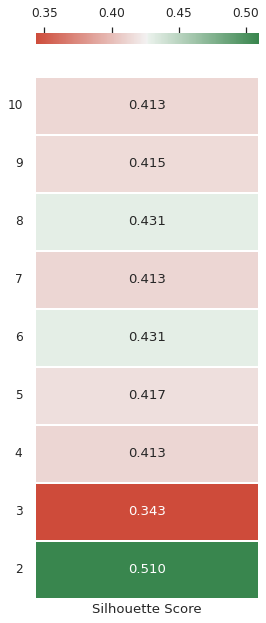

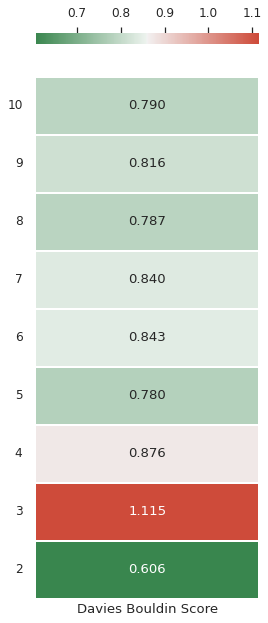

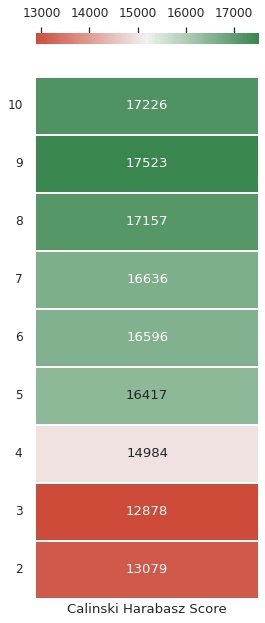

time: 1.66 s (started: 2023-02-19 09:23:31 +00:00)


In [ ]:
#Farbskala einstellen
cmp = sns.diverging_palette(135, 16, as_cmap=True)
cmp_r = sns.diverging_palette(16, 135, as_cmap=True)
sns.set(font_scale=1.1)

#Visualisierung silhouette_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_70_heatmap_df_silhouette,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.3f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.tick_params(rotation=0)
ax.invert_yaxis()
ax.set_xlabel("Silhouette Score")

#-----------------------------------------------------------------

#Visualisierung davies_bouldin_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_70_heatmap_df_davies,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp,
                 fmt = '0.3f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.invert_yaxis()
ax.tick_params(rotation=0)
ax.set_xlabel("Davies Bouldin Score")

#-----------------------------------------------------------------

#Visualisierung calinski_harabasz_score
plt.figure(figsize = size)
ax = sns.heatmap(kmeans_70_heatmap_df_calinski,
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.0f',
                 cbar_kws = dict(use_gridspec=False, location="top"),
                 xticklabels=False
                 )

ax.tick_params(rotation=0)
ax.invert_yaxis()
ax.set_xlabel("Calinski Harabasz Score")

plt.show()

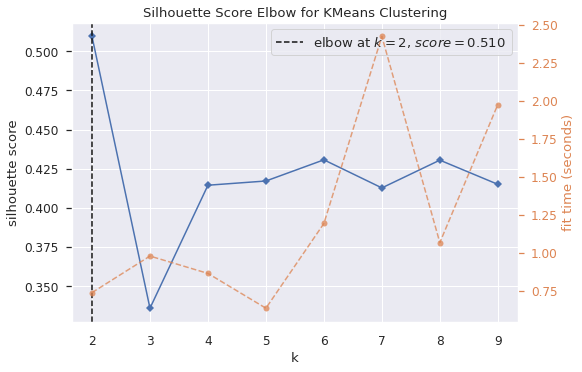

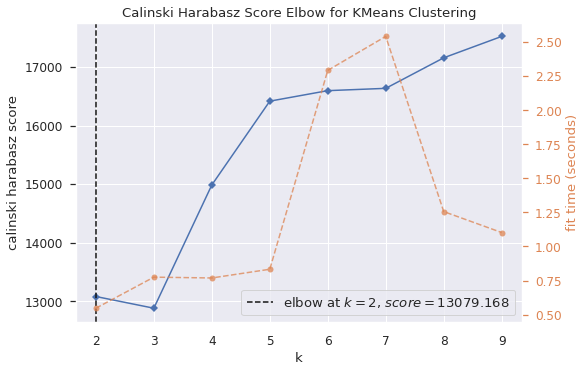

time: 1min 3s (started: 2023-02-19 09:23:33 +00:00)


In [ ]:
#Visualisierung silhouette_score
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10), metric='silhouette', timings= True)
visualizer.fit(data_pca_70)
visualizer.show()

#-----------------------------------------------------------------

#Visualisierung calinski_harabasz_score
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10), metric='calinski_harabasz', timings= True)
visualizer.fit(data_pca_70)
visualizer.show()

####Performance Metriken

In [ ]:
#Performance Metriken
performance_kmeans_70_silhouette = max(kmeans_70_heatmap_df_silhouette['silhouette_score'])
performance_kmeans_70_davies = max(kmeans_70_heatmap_df_davies['davies_bouldin_score'])
performance_kmeans_70_calinski = max(kmeans_70_heatmap_df_calinski['calinski_harabasz_score'])

#Cluster
performance_kmeans_70_cluster = kmeans_70_heatmap_df_silhouette.index[kmeans_70_heatmap_df_silhouette['silhouette_score'] == performance_kmeans_70_silhouette].tolist()[0]

time: 2.87 ms (started: 2023-02-19 09:24:37 +00:00)


#Clustering mit dem DBSCAN Verfahren

##Nearest Neighbors

###Mit 100% Varianz

In [ ]:
#calculate the distance from each point to its closest neighbor
nN_ohne_pca = NearestNeighbors(n_neighbors=2)

#fit the nearest neighbor
nN_ohne_pca = nN_ohne_pca.fit(data_scaled_df)

#returns two arrays: distance to the closest n_neighbors point and index for each point
distances_ohne_pca, indices_ohne_pca = nN_ohne_pca.kneighbors(data_scaled_df)

#sort the distance
distances_ohne_pca = np.sort(distances_ohne_pca, axis=0)
distances_ohne_pca = distances_ohne_pca[:,1]

time: 13.9 s (started: 2023-02-18 21:41:38 +00:00)


In [ ]:
#Visualisierung
# plt.figure(figsize=(10,7))
# plt.grid(True)
# plt.plot(nN_ohne_pca)
# plt.xlim(0)
# plt.ylim(0)

time: 485 µs (started: 2023-02-18 21:41:52 +00:00)


Hier kann man ablesen wie der Parameter eps für den DBScan gewählt werden sollte, genau da wo sich die Steigung der Kurve langsam der 0 nähert (~0.4 und ~0.7).


###Mit 90% Varianz

In [ ]:
#calculate the distance from each point to its closest neighbor
nN_90 = NearestNeighbors(n_neighbors=2)

#fit the nearest neighbor
nN_90 = nN_90.fit(data_pca_90)

#returns two arrays: distance to the closest n_neighbors point and index for each point
distances_90, indices_90 = nN_90.kneighbors(data_pca_90)

#sort the distance
distances_90 = np.sort(distances_90, axis=0)
distances_90 = distances_90[:,1]

time: 1.25 s (started: 2023-02-18 21:41:52 +00:00)


In [ ]:
#plot
# plt.figure(figsize=(10,7))
# plt.grid(True)
# plt.plot(nN_90)
# plt.xlim(0)
# plt.ylim(0)

time: 603 µs (started: 2023-02-18 21:41:53 +00:00)


Hier kann man ablesen wie der Parameter eps für den DBScan gewählt werden sollte (~0,15 und ~0,4).


###Mit 70% Varianz

In [ ]:
#calculate the distance from each point to its closest neighbor
nN_70 = NearestNeighbors(n_neighbors=2)

#fit the nearest neighbor
nN_70 = nN_70.fit(data_pca_70)

#returns two arrays: distance to the closest n_neighbors point and index for each point
distances_70, indices_70 = nN_70.kneighbors(data_pca_70)

#sort the distance
distances_70 = np.sort(distances_70, axis=0)
distances_70 = distances_70[:,1]

time: 117 ms (started: 2023-02-18 21:41:53 +00:00)


In [ ]:
#plot
# plt.figure(figsize=(10,7))
# plt.grid(True)
# plt.plot(distances_70)
# plt.xlim(0)
# plt.ylim(0)

time: 586 µs (started: 2023-02-18 21:41:53 +00:00)


Hier kann man ablesen wie der Parameter eps für den DBScan gewählt werden sollte, genau da wo sich die Steigung der Kurve der 0 nähert (~0.1).


###Visualisierung aller 3 Varianten in einem Diagramm

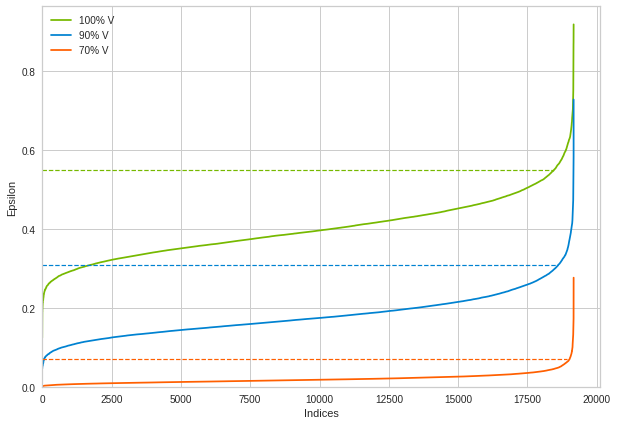

time: 447 ms (started: 2023-02-18 21:41:53 +00:00)


In [ ]:
plt.figure(figsize=(10, 7))

plt.xlabel('Indices')
plt.ylabel('Epsilon')

plt.plot(distances_ohne_pca, label = "100% V", ls="-", color="#76B900")
plt.plot(distances_90, label = "90% V", ls="-", color="#0082D1")
plt.plot(distances_70, label = "70% V", ls="-", color="#FF5F00")

plt.axhline(y=0.55, xmax=0.915, color="#76B900", ls="--", linewidth=1.2)
plt.axhline(y=0.30, xmax=0.925, color="#0082D1", ls="--", linewidth=1.2)
plt.axhline(y=0.07, xmax=0.940, color="#FF5F00", ls="--", linewidth=1.2)

plt.xlim(0)
plt.ylim(0)
plt.legend()

plt.show()

In [ ]:
#Range setzen für Grid Search
eps_100 = 0.55
eps_90 = 0.3
eps_70 = 0.07
schritte = 0.1

time: 712 µs (started: 2023-02-19 08:13:13 +00:00)


##DBScan Clustering mit 100% Varianz

####Berechnung

In [ ]:
#eps Wert aus Nearest Neighbor 90% Methode 0.4 und 0.7
#min_samples rule of thumb 1: 2*dim = 2*59 = 118
#min_samples rule of thumb2: min_samples ≥ D + 1 = min_samples ≥ 59 + 1 = 60
db_ohne_pca = DBSCAN(eps=0.4, min_samples=10).fit(data_scaled_df)

time: 6.78 s (started: 2023-02-16 14:08:35 +00:00)


In [ ]:
#Daten kopieren
data_scaled_df_dbscan = data_scaled_df.copy()

#Spalten hinzufügen
data_scaled_df_dbscan['clusters'] = db_ohne_pca.labels_
data_scaled_df_dbscan['player_names'] = player_names
data_scaled_df_dbscan.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,clusters,names
0,1.000000,0.956522,0.402034,0.914163,0.473684,0.294118,0.377049,0.000622,0.0,0.295918,0.2,0.233945,0.000463,0.333333,0.75,0.75,1.00,0.386319,0.826087,0.973684,0.970588,1.000000,0.259740,0.590164,0.897727,1.000000,0.738636,0.965517,0.977011,1.000000,0.988636,1.000000,0.976190,1.000000,0.927711,0.792683,0.935897,1.000000,0.987654,0.880000,0.630137,0.705882,0.641026,1.000000,0.400000,0.420455,0.968085,1.000000,0.790698,1.000000,0.179775,0.340909,0.218391,0.044944,0.100000,0.142857,0.133333,0.068182,0.428799,-1,L. Messi
1,0.978261,0.934783,0.615962,0.771102,0.421053,0.588235,0.524590,0.000173,0.0,0.081633,0.2,0.165138,0.000318,0.296296,0.75,0.75,1.00,0.527958,0.724638,0.973684,0.794118,0.867647,0.389610,0.868852,0.738636,1.000000,0.965909,0.896552,0.988506,0.880435,0.829545,0.900000,0.726190,0.909091,0.759036,0.780488,0.756410,0.985507,0.827160,0.933333,0.863014,0.752941,0.858974,0.922222,0.835294,0.522727,0.989362,0.835294,0.965116,0.904762,0.348315,0.420455,0.160920,0.146067,0.044444,0.109890,0.066667,0.090909,0.428799,-1,R. Lewandowski
2,0.956522,0.913043,0.231923,0.771102,0.526316,0.627451,0.557377,0.000086,0.0,0.061224,0.2,0.169725,0.000327,0.222222,0.75,1.00,1.00,0.222992,0.855072,1.000000,0.808824,0.897059,0.259740,0.754098,0.920455,1.000000,0.965909,0.839080,0.954023,0.913043,0.852273,0.888889,0.809524,0.909091,0.855422,0.890244,0.871795,1.000000,0.728395,0.986667,1.000000,0.764706,0.743590,0.988889,0.623529,0.295455,0.989362,0.776471,0.941860,0.988095,0.224719,0.306818,0.218391,0.056180,0.100000,0.142857,0.133333,0.102273,0.428799,-1,Cristiano Ronaldo
3,0.956522,0.913043,0.664933,0.771102,0.342105,0.392157,0.311475,0.000622,0.0,0.091837,0.4,0.243119,0.119494,0.428439,1.00,1.00,1.00,0.639074,0.913043,0.855263,0.897059,0.985294,0.298701,0.557377,0.897727,0.870968,0.659091,0.908046,0.954023,0.989130,0.931818,0.922222,0.857143,0.988636,0.951807,0.902439,1.000000,0.927536,0.851852,0.800000,0.575342,0.811765,0.435897,0.855556,0.623529,0.386364,0.893617,0.941176,1.000000,0.964286,0.348315,0.306818,0.275862,0.078652,0.077778,0.142857,0.144444,0.102273,0.428799,-1,Neymar Jr
4,0.956522,0.913043,0.646891,1.000000,0.368421,0.509804,0.344262,0.000078,0.0,0.163265,0.4,0.027523,0.000064,0.222222,1.00,0.75,0.75,0.621671,0.695652,0.894737,1.000000,0.897059,0.649351,0.803279,1.000000,0.860215,0.568182,1.000000,0.908046,0.913043,0.897727,0.877778,1.000000,0.943182,0.746988,0.743902,0.782051,0.956522,0.777778,0.946667,0.561644,0.905882,0.705128,0.966667,0.776471,0.715909,0.914894,0.988235,0.883721,0.916667,0.719101,0.681818,0.551724,0.146067,0.122222,0.032967,0.088889,0.125000,0.428799,-1,K. De Bruyne


time: 96.4 ms (started: 2023-02-16 14:08:42 +00:00)


In [ ]:
#Speichern
savePickle(db_ohne_pca, 'db_ohne_pca')
saveCSV(data_scaled_df_dbscan, 'data_scaled_df_dbscan')

time: 11.7 ms (started: 2023-02-16 14:08:42 +00:00)


####Visualisierung

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


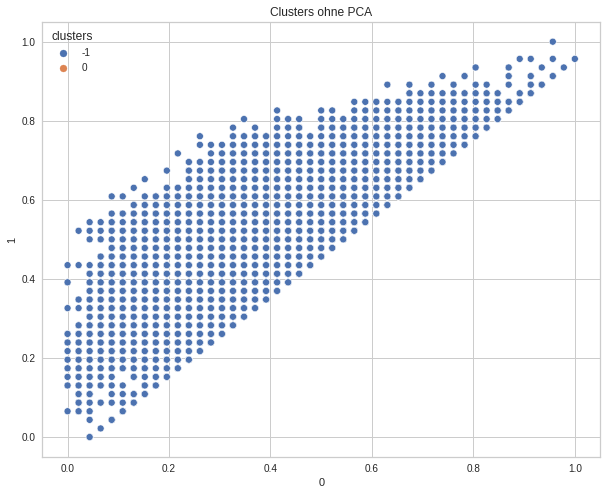

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


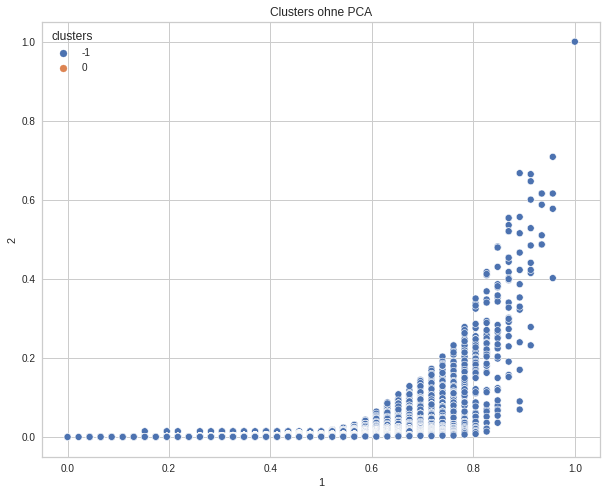

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


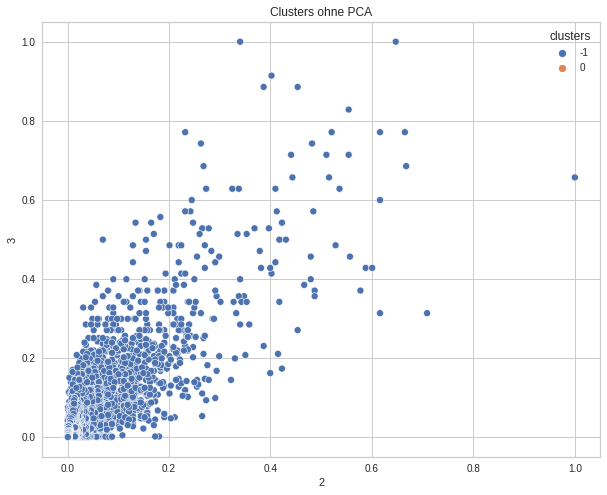

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


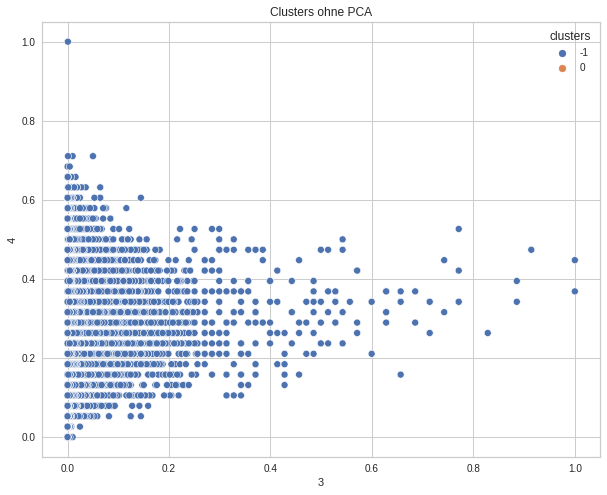

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


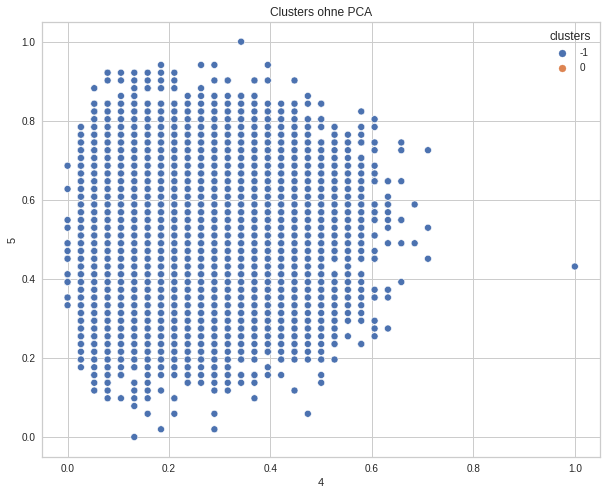

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


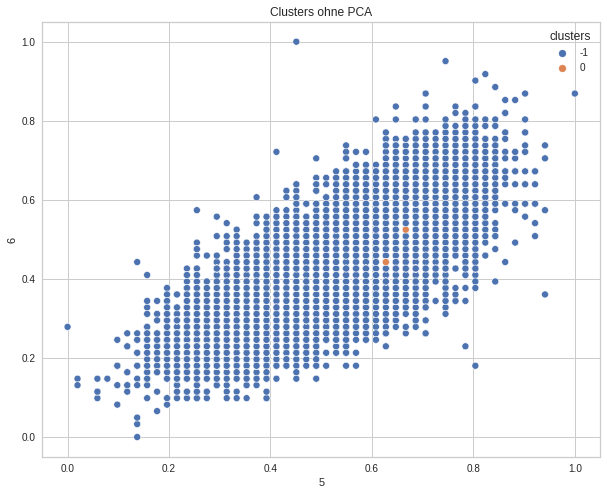

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


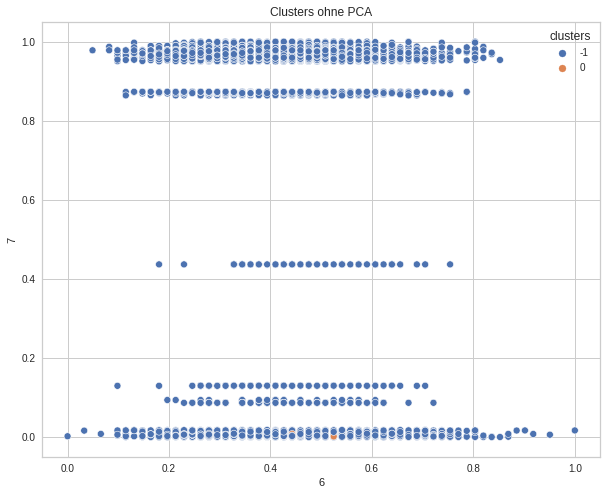

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


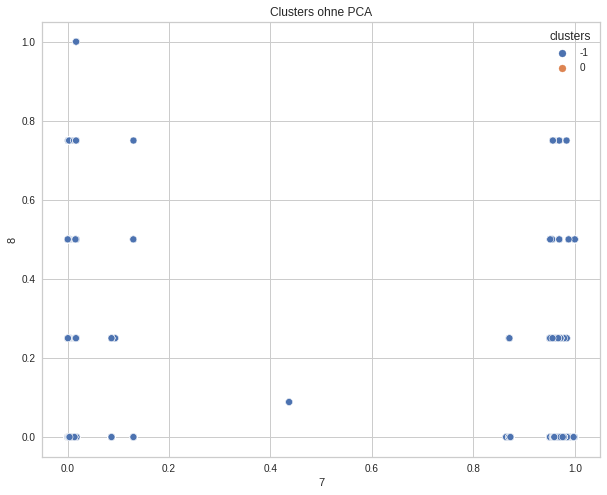

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


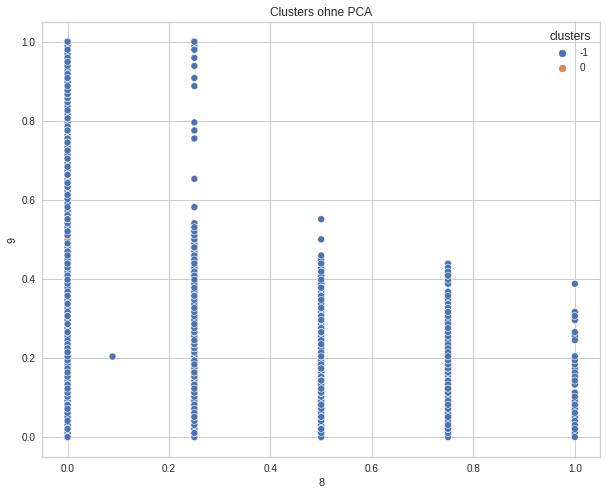

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


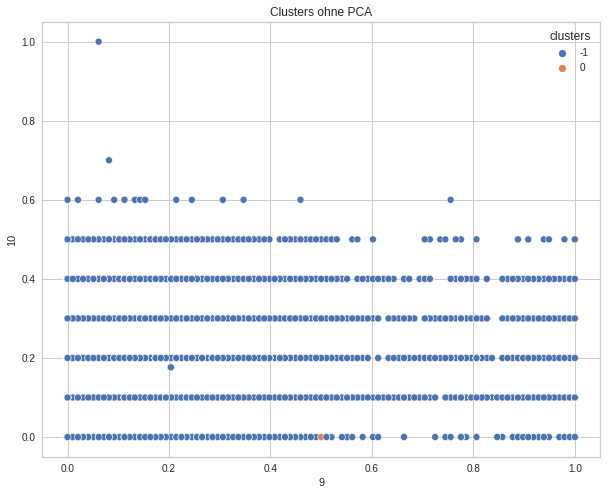

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


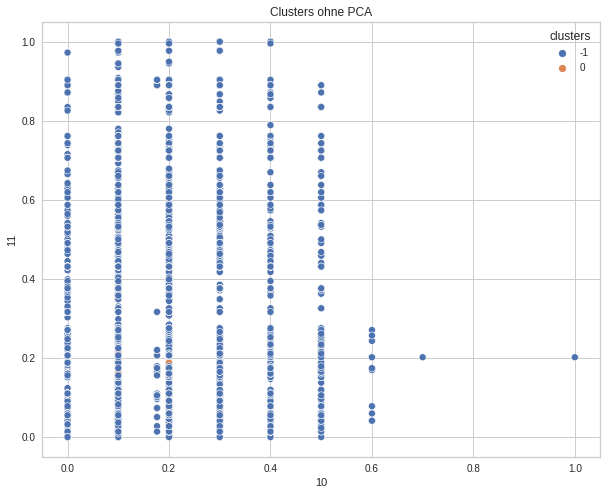

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


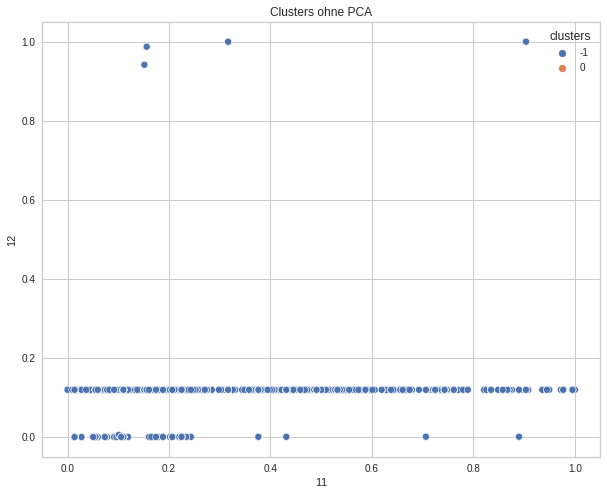

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


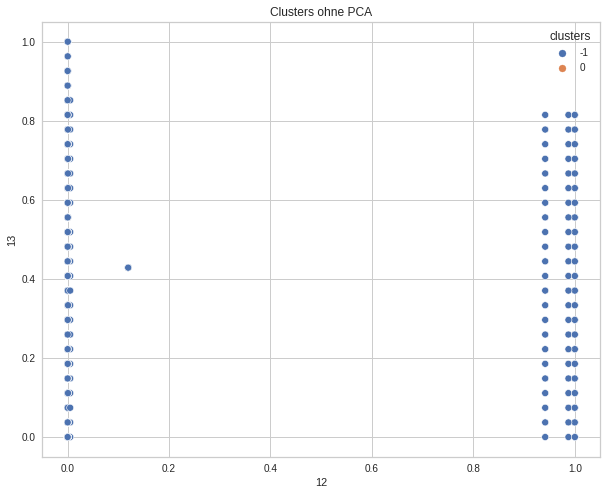

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


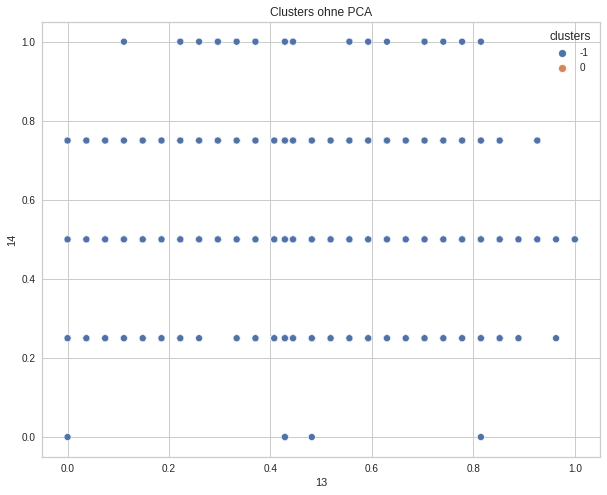

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


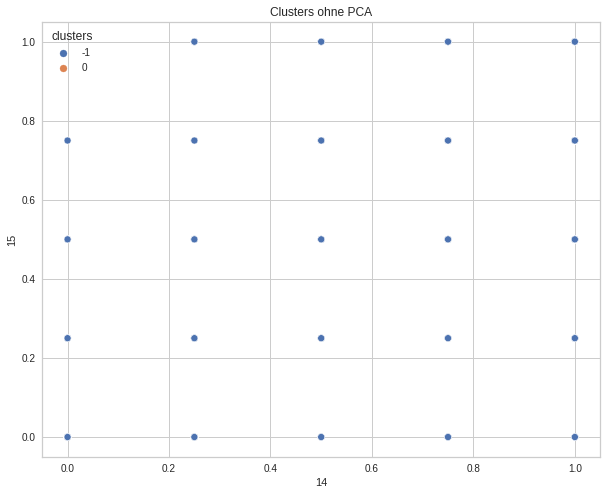

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


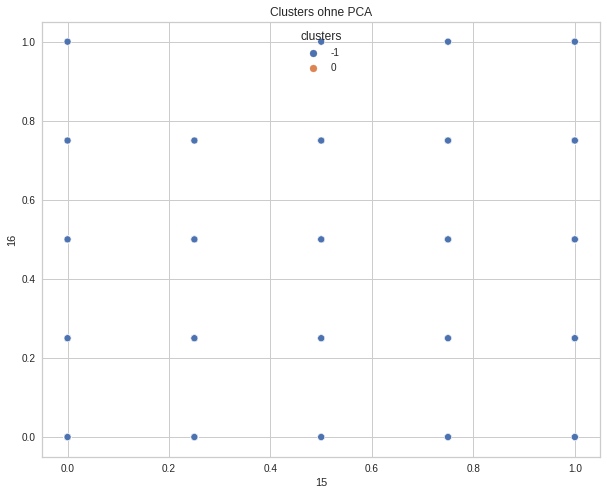

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


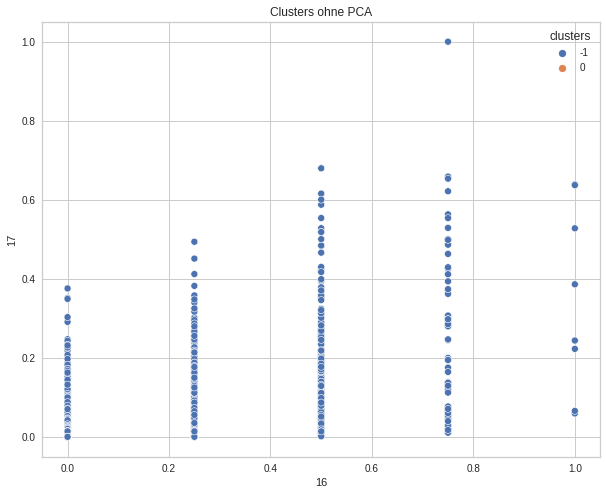

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


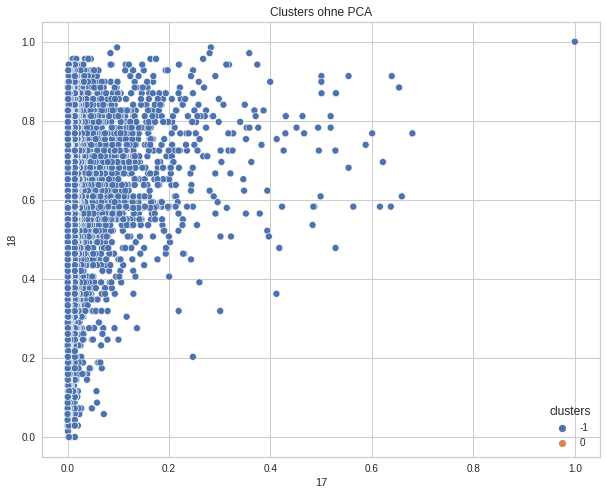

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


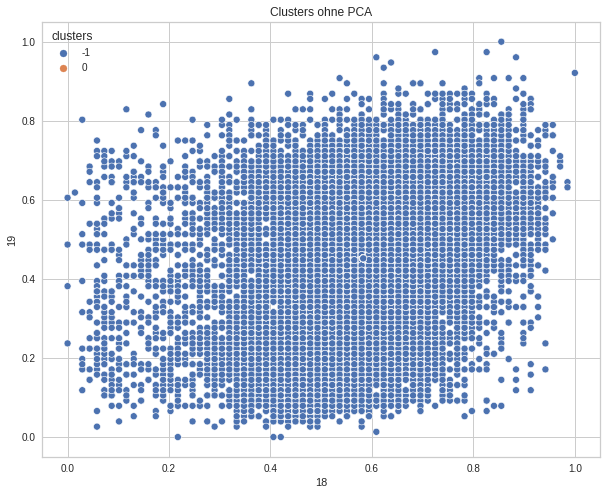

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


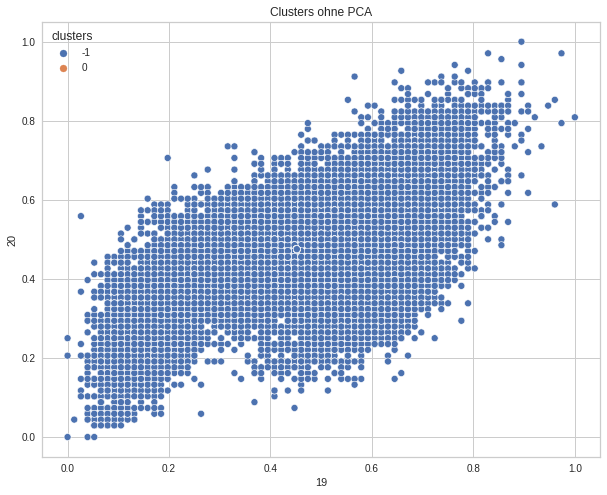

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


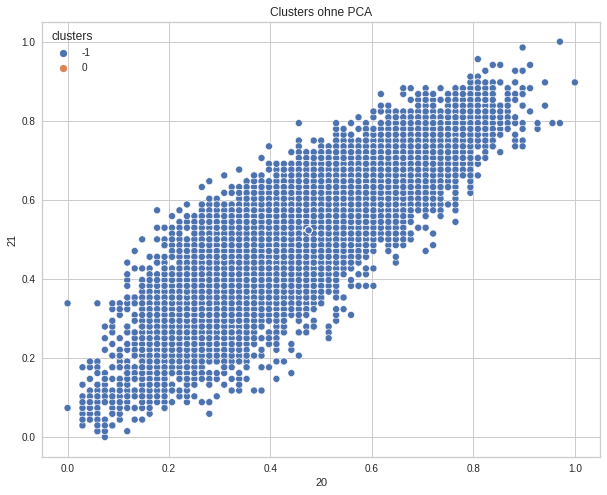

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


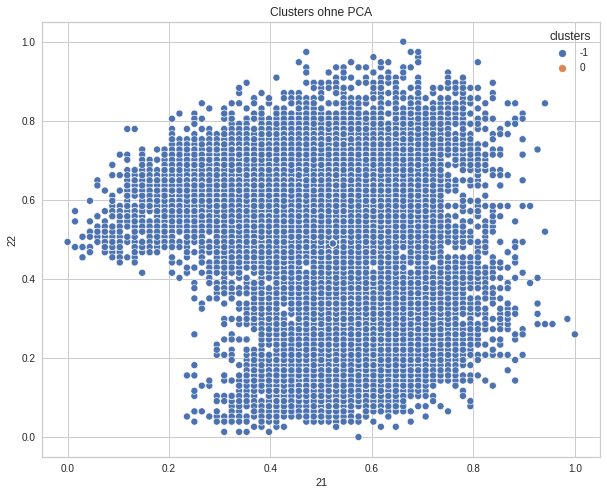

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


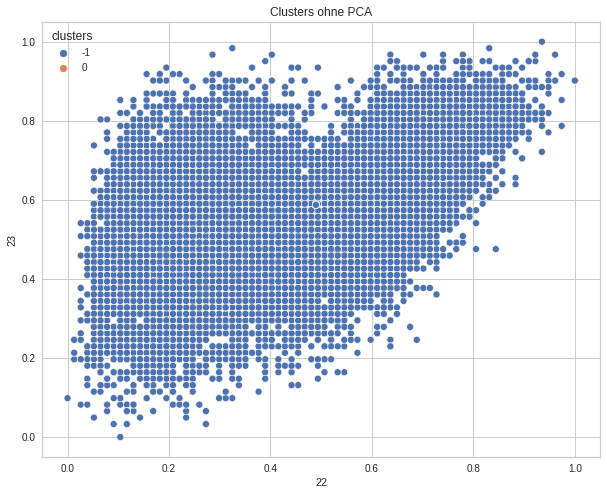

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


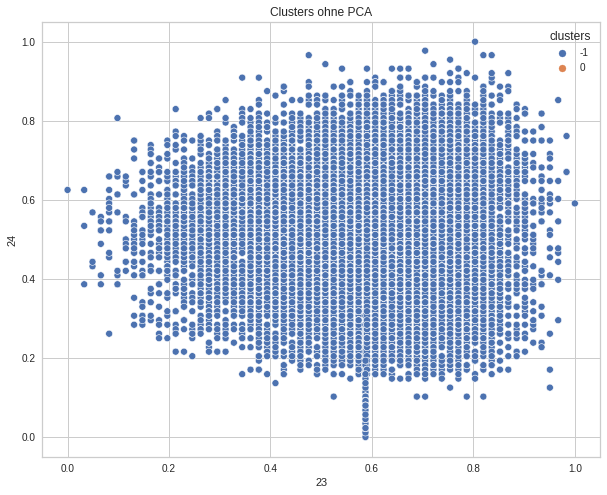

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


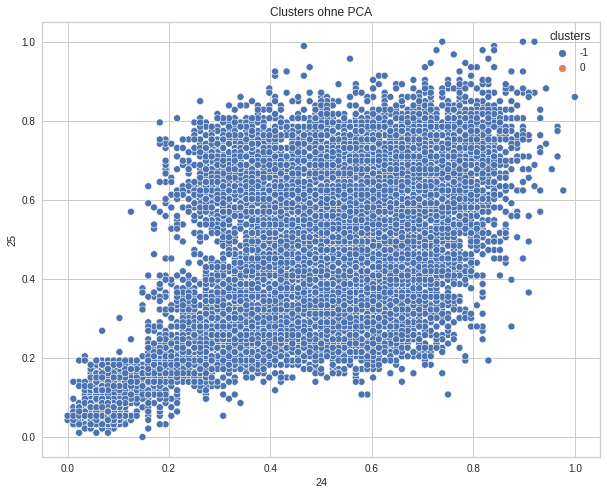

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


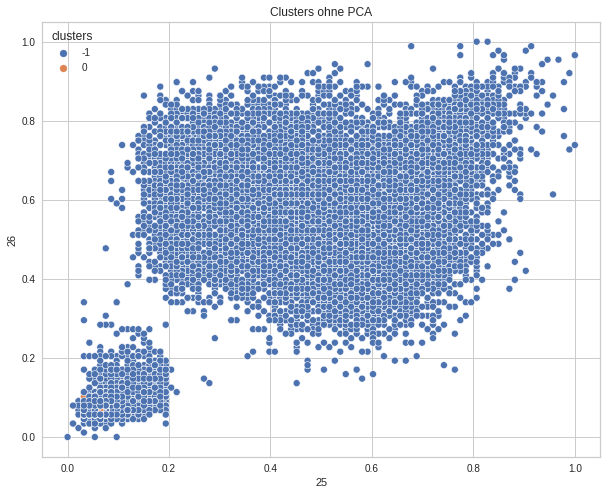

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


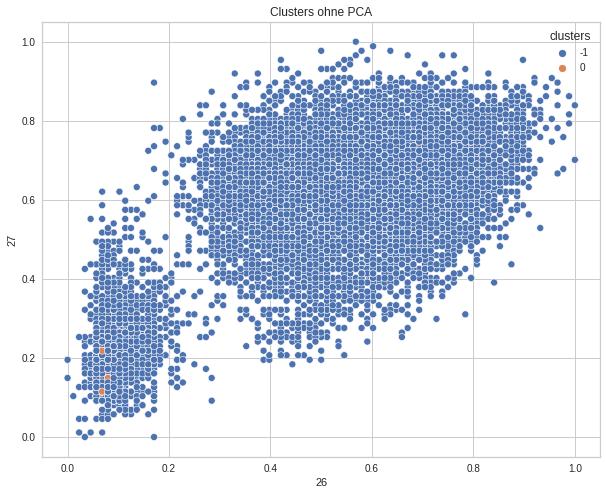

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


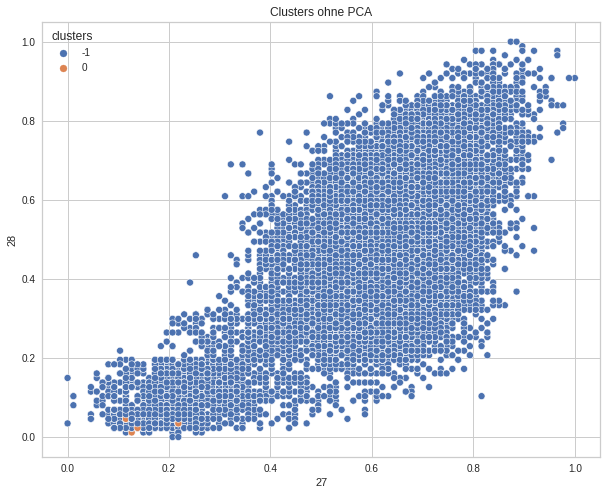

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


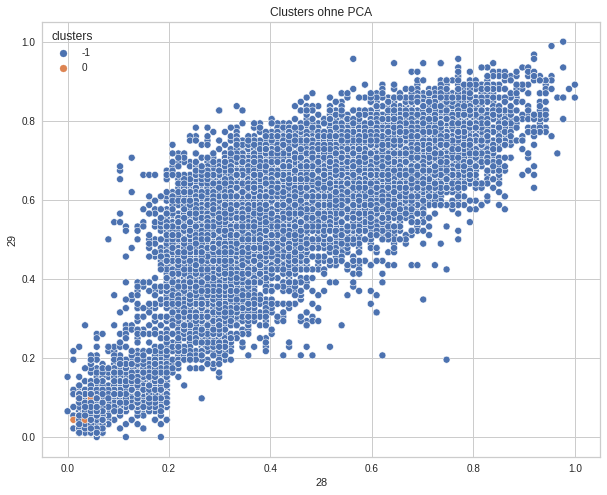

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


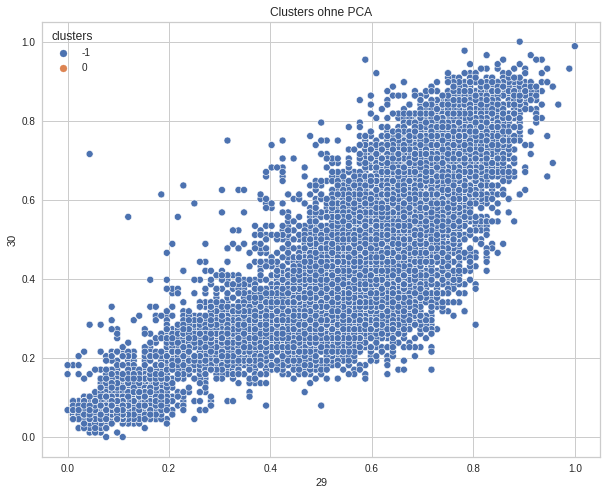

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


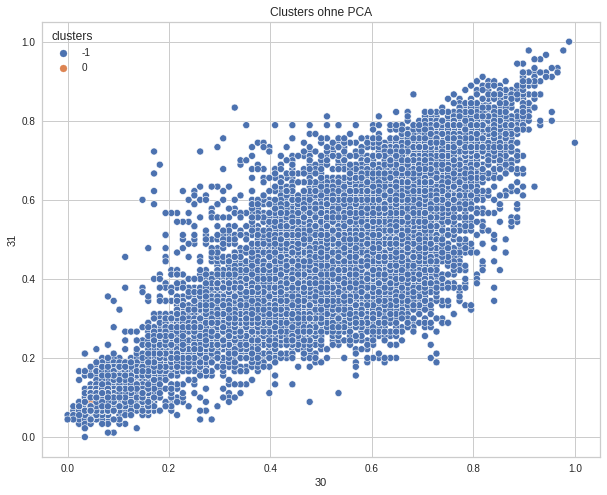

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


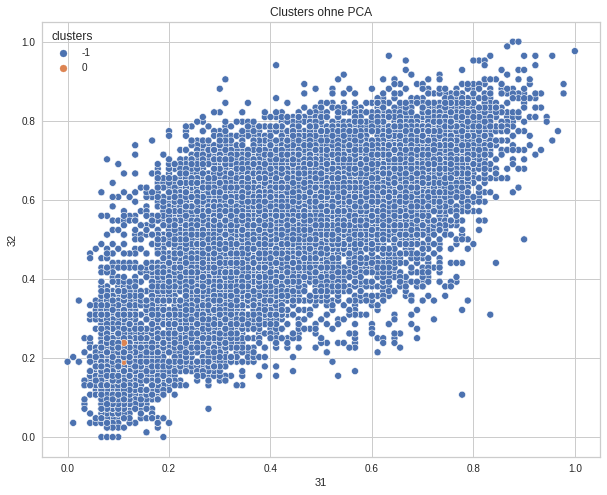

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


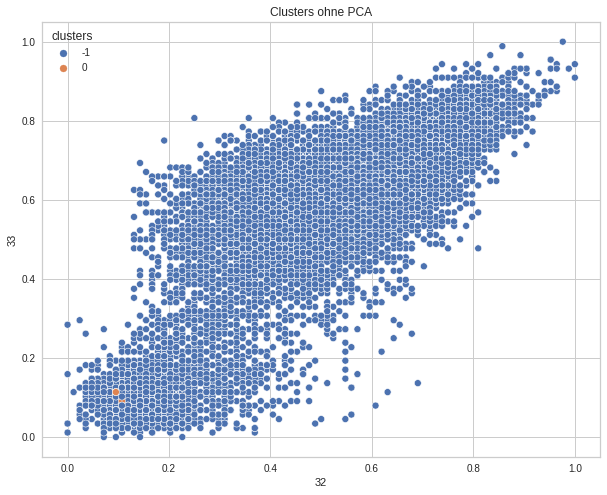

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


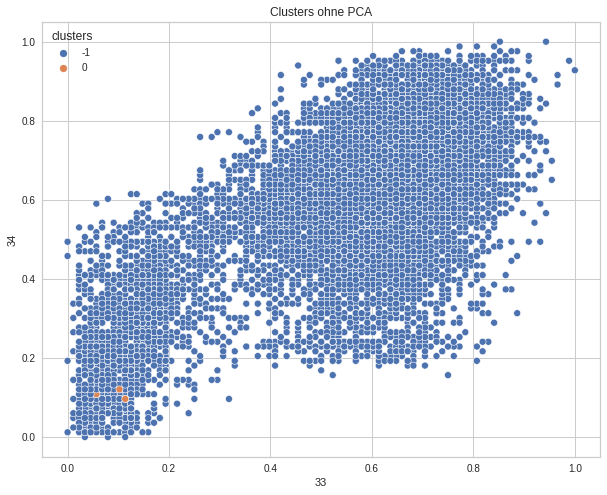

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


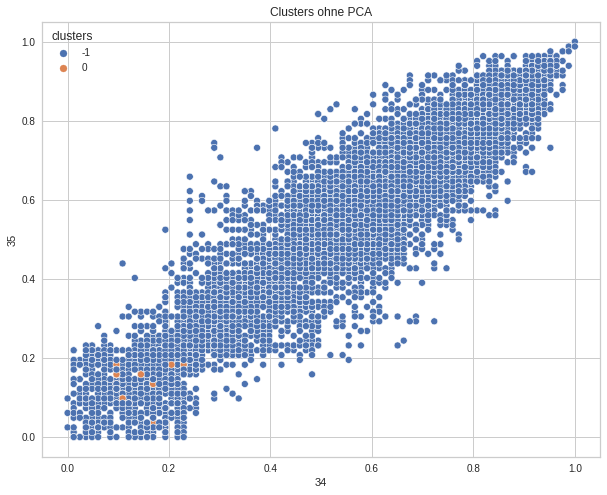

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


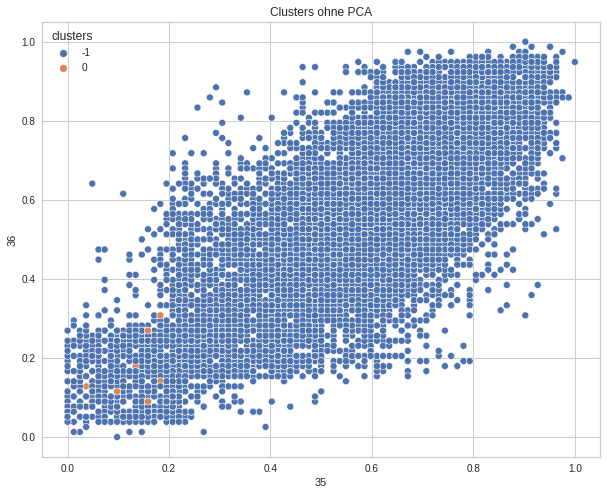

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


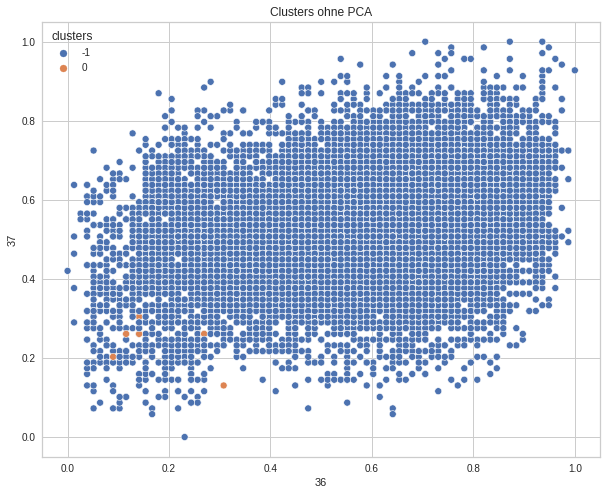

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


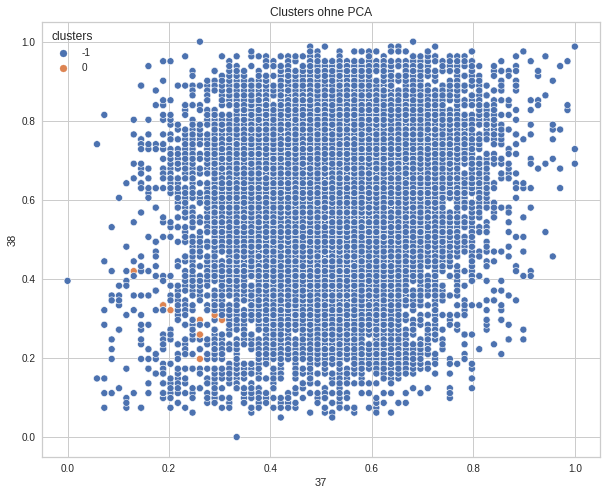

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


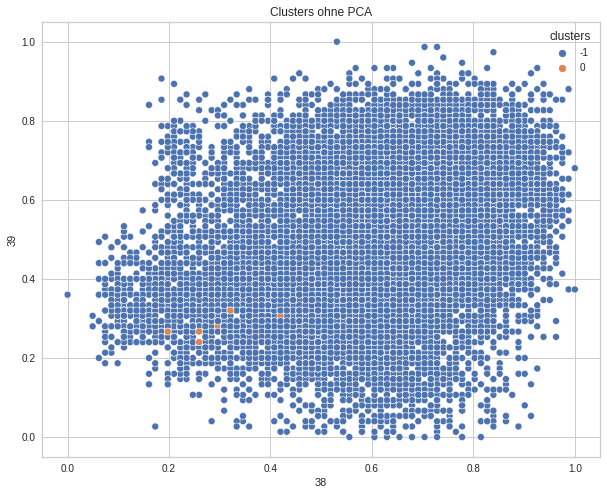

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


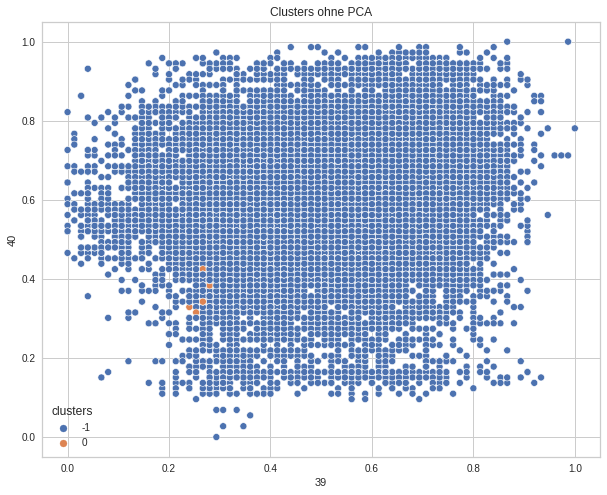

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


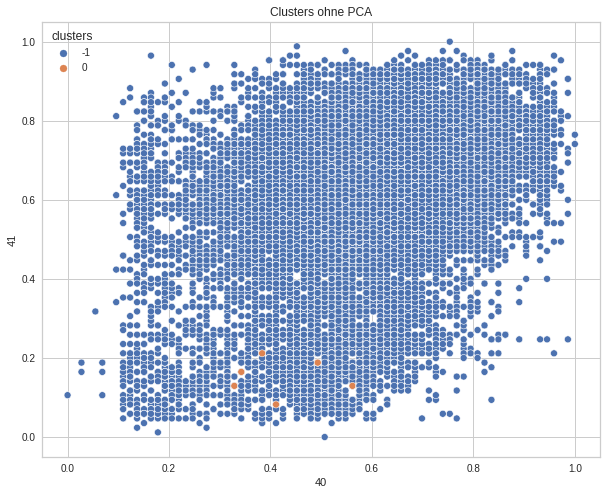

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


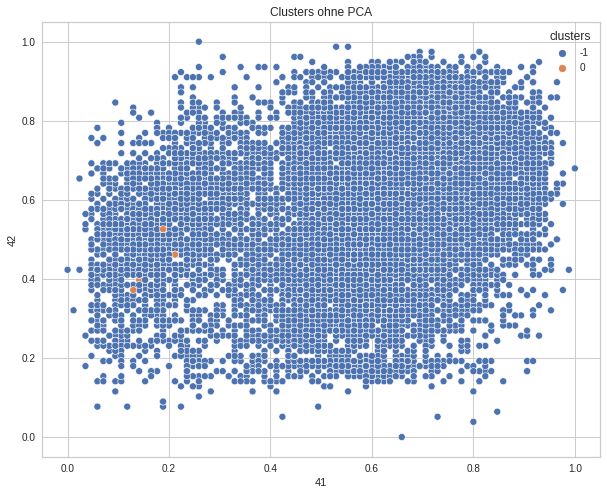

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


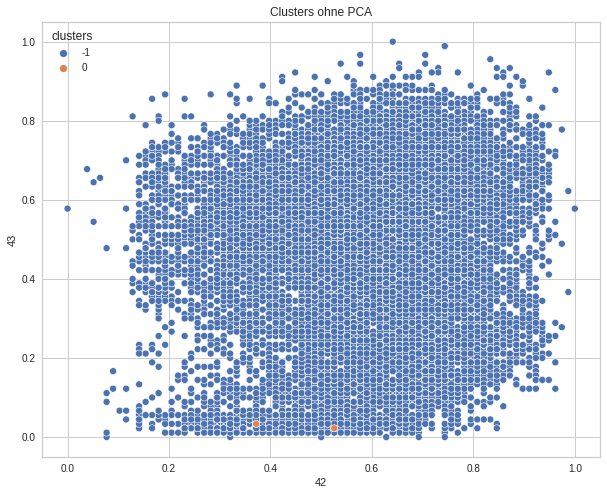

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


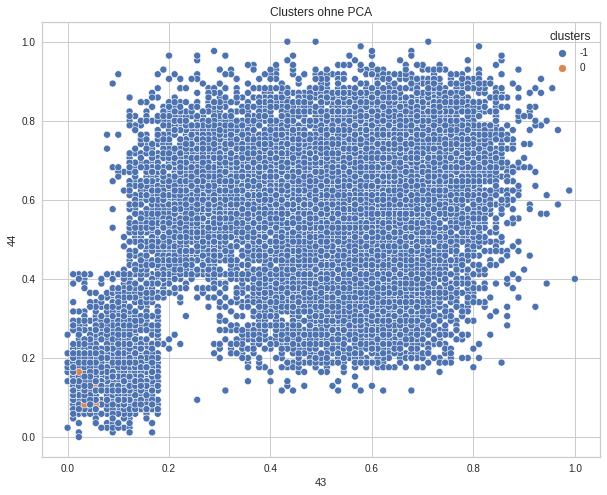

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


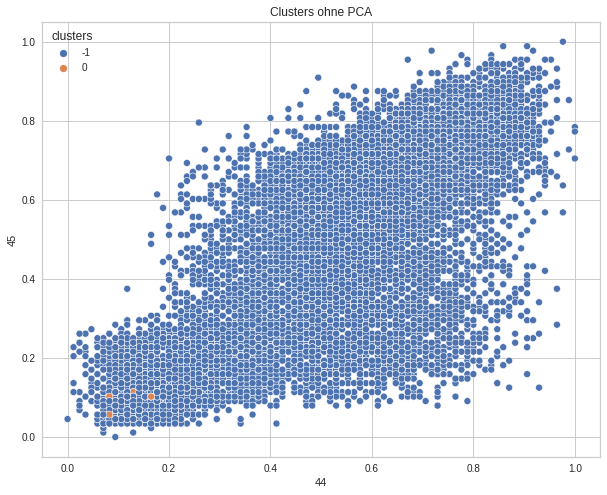

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


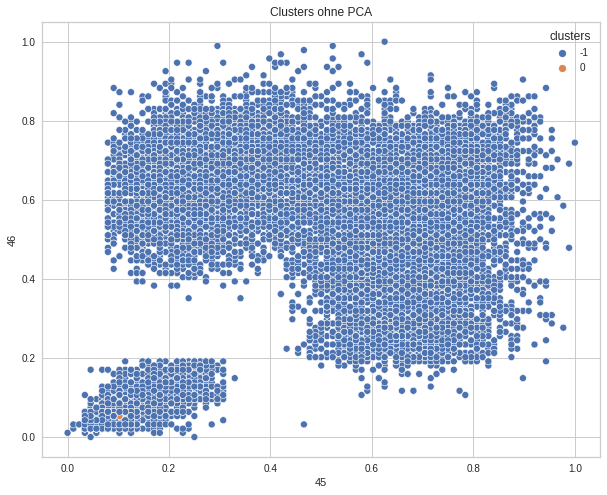

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


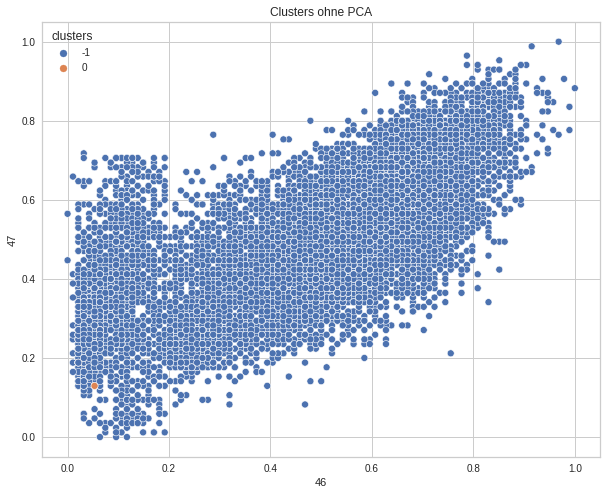

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


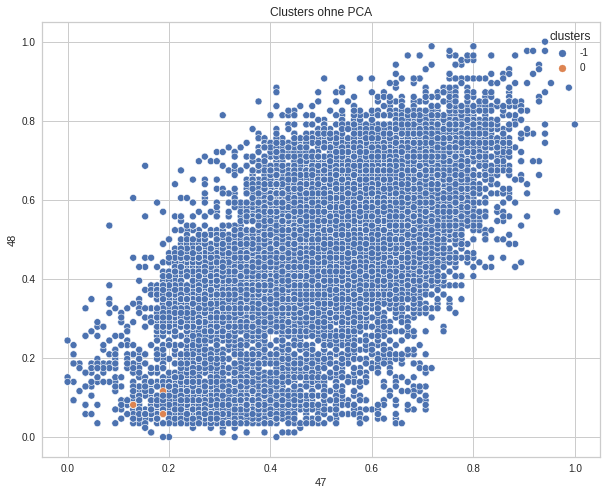

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


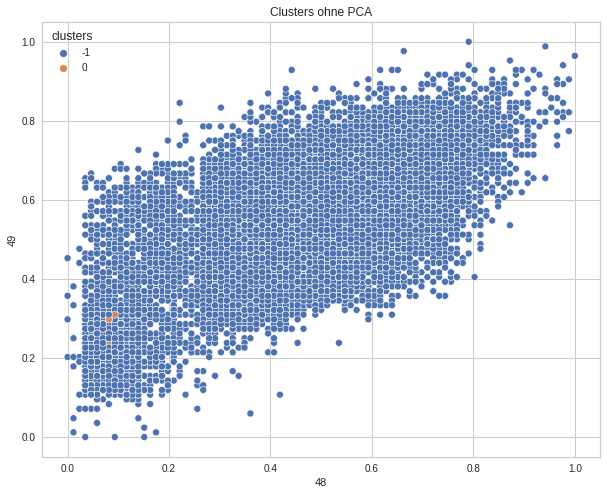

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


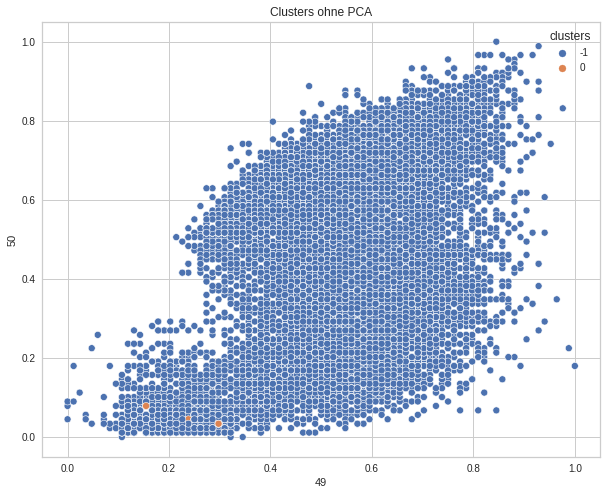

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


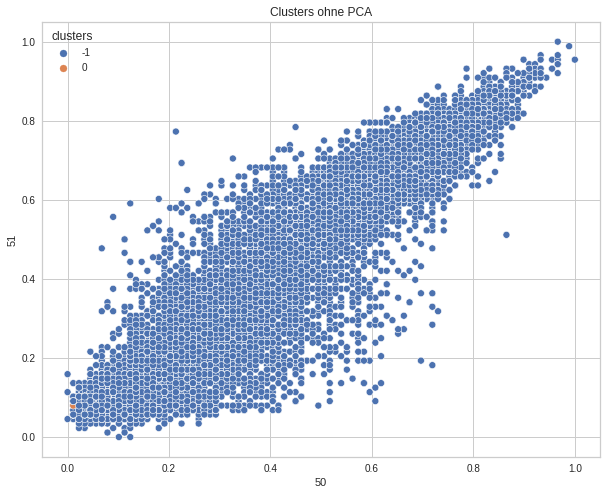

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


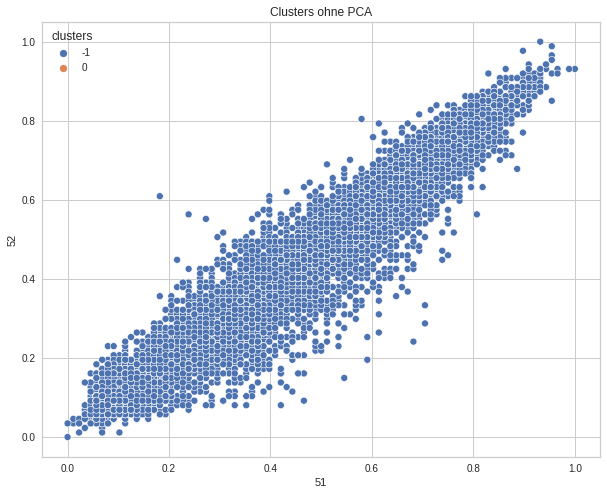

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


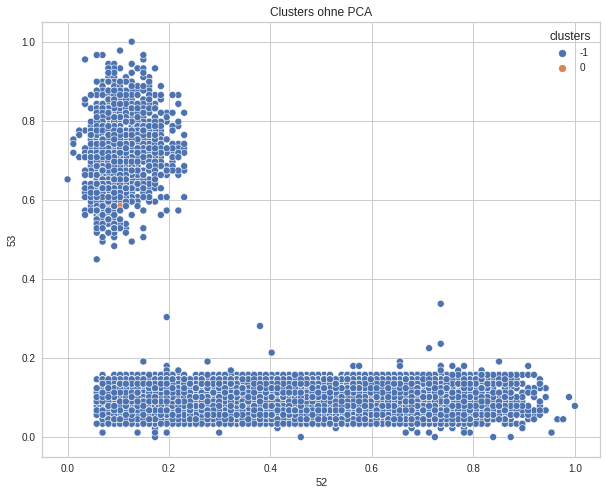

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


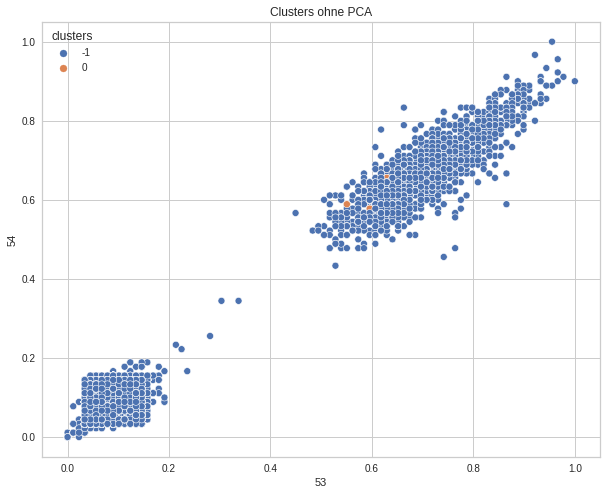

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


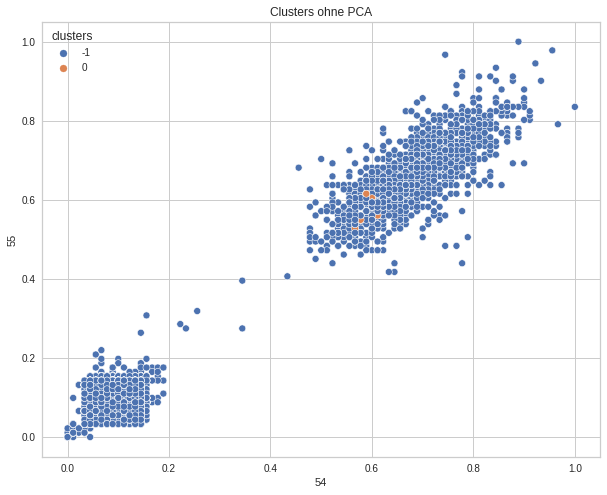

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


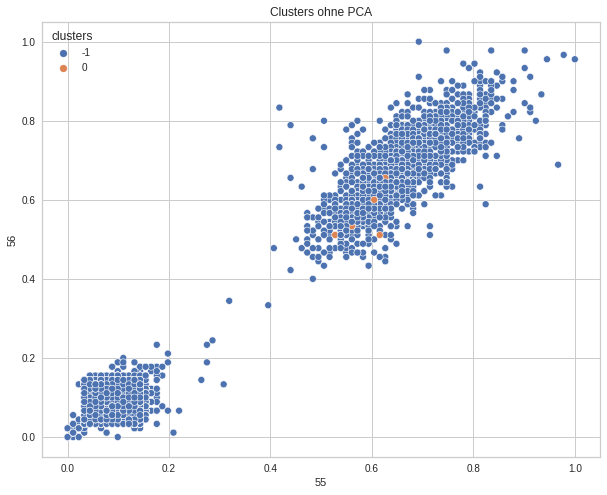

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


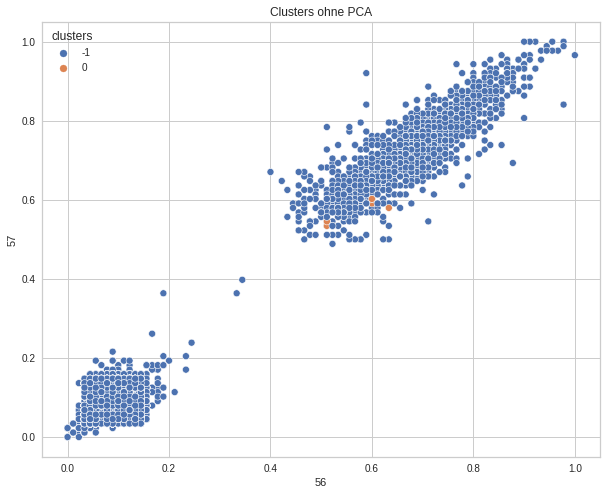

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


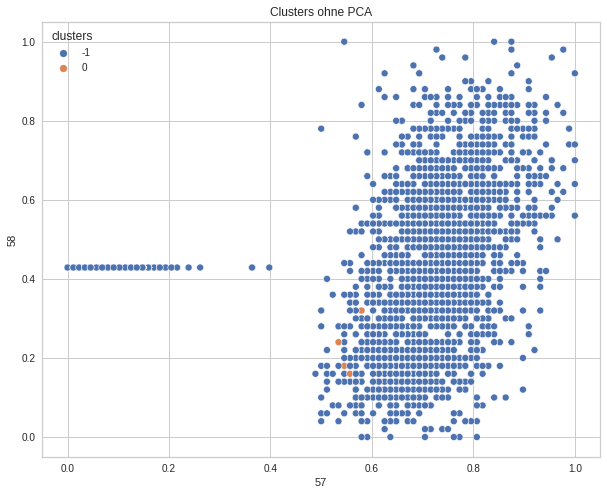

time: 1min 33s (started: 2023-02-16 14:08:42 +00:00)


In [ ]:
#Nicht alle Spaltenkombinationen werden geplottet
for i in range(0, len(data_scaled_df_dbscan.columns)-3):
  #Spalten für das Diagramm wählen
  x_axis = data_scaled_df_dbscan[i] #component/column x in table
  y_axis = data_scaled_df_dbscan[i+1] #component/column y in table

  #Diagramm Settings
  plt.figure(figsize=(10,8))
  sns.scatterplot(x_axis, y_axis, hue=data_scaled_df_dbscan['clusters'], palette ="deep")
  plt.title('Clusters ohne PCA')

  #Anzeigen
  plt.show()

##DBScan Clustering mit 90% Varianz

####Berechnung

In [ ]:
#eps Wert aus Nearest Neighbor 90% Methode 0.15 und 0.45
#min_samples rule of thumb 1: 2*dim = 2*13 = 26
#min_samples rule of thumb 2: min_samples ≥ D + 1 = min_samples ≥ 13 + 1 = 14
db_90 = DBSCAN(eps=0.45, min_samples=26).fit(data_pca_90)

time: 5.59 s (started: 2023-02-16 14:10:15 +00:00)


In [ ]:
#Daten kopieren
data_pca_90_dbscan = data_pca_90.copy()

#Spalten hinzufügen
data_pca_90_dbscan['clusters'] = db_90.labels_
data_pca_90_dbscan['player_names'] = player_names

#Spalten umbenennen
data_pca_90_dbscan.columns = [f"pca_{i+1}" for i in range(pca_90.n_components_)] + ['clusters', 'player_names']

time: 51.4 ms (started: 2023-02-16 14:18:07 +00:00)


In [ ]:
#Speichern
savePickle(db_90, 'db_90')
saveCSV(data_pca_90_dbscan, 'data_pca_90_dbscan')

time: 12.6 ms (started: 2023-02-16 14:10:21 +00:00)


####Visualisierung

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


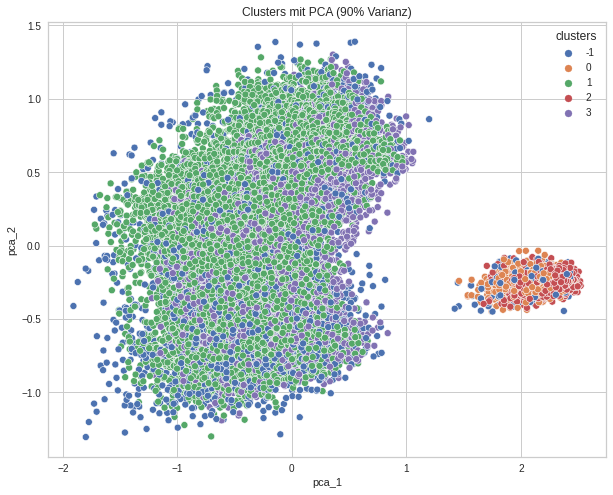

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


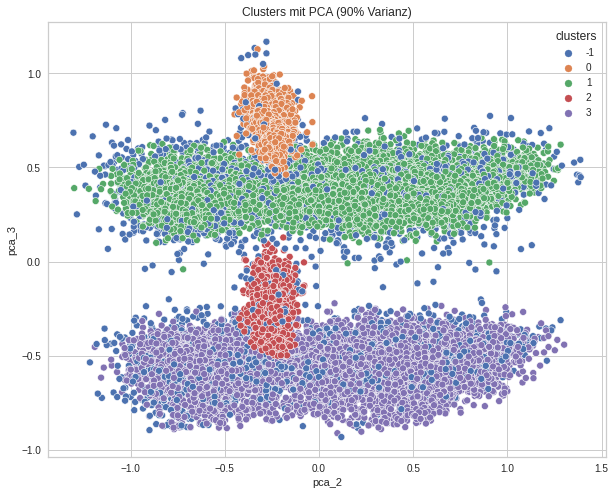

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


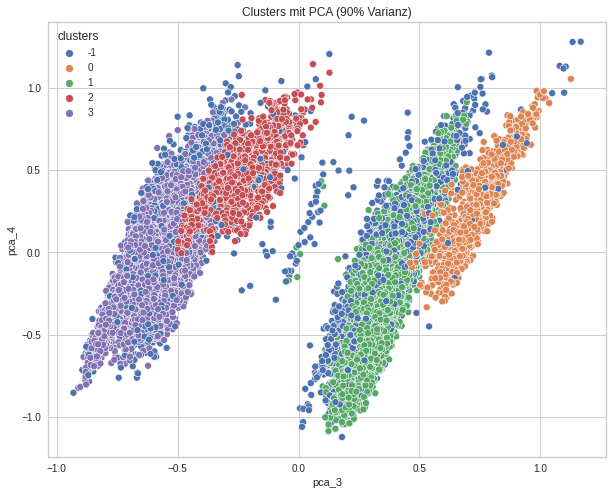

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


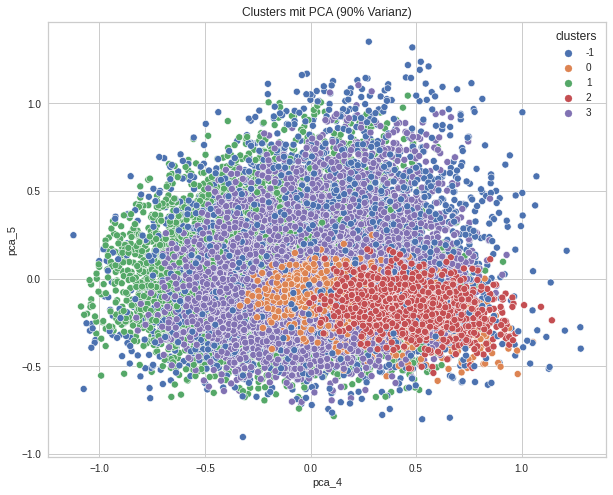

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


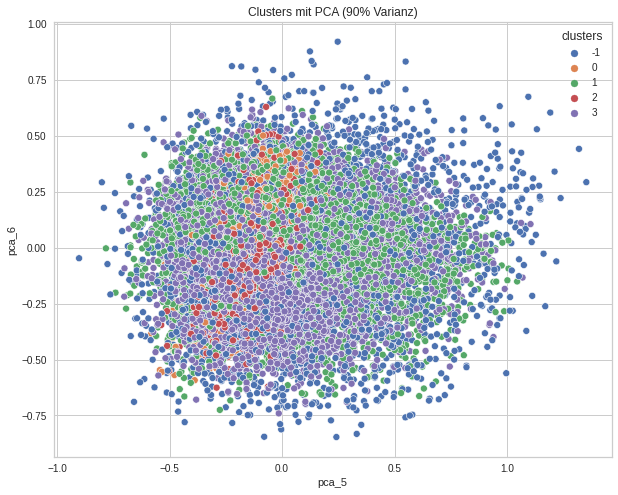

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


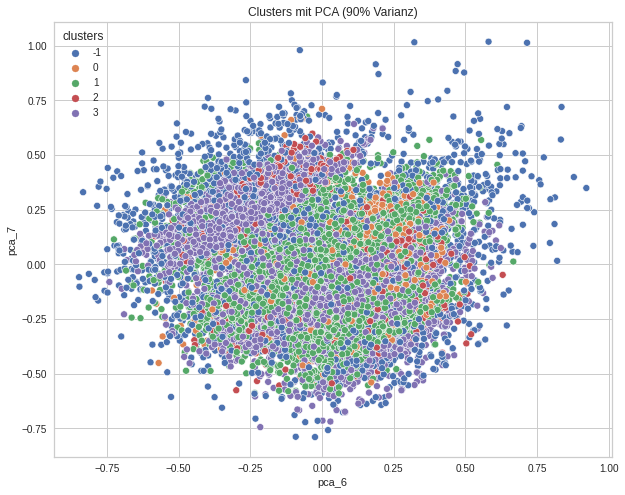

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


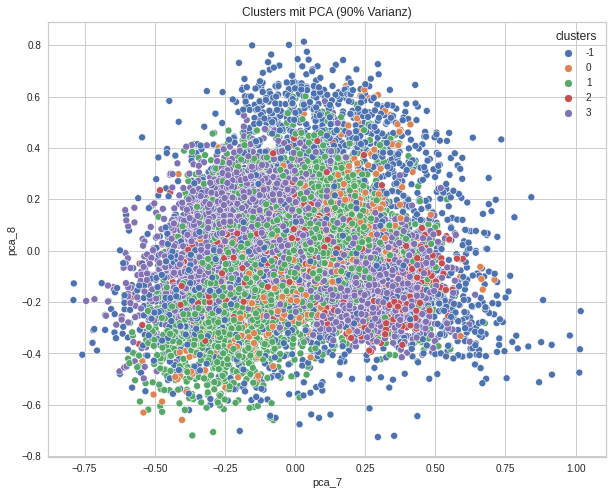

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


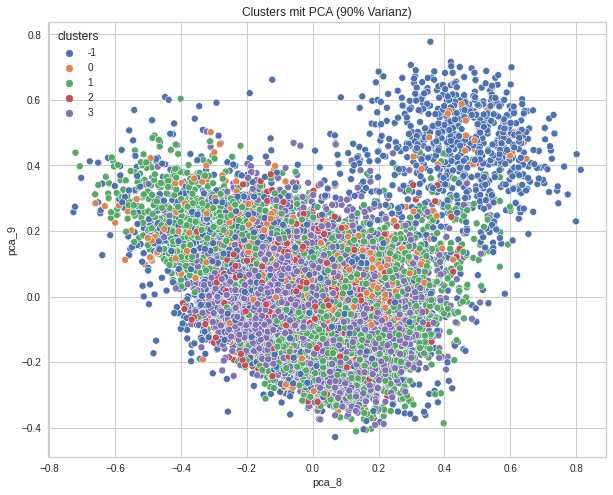

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


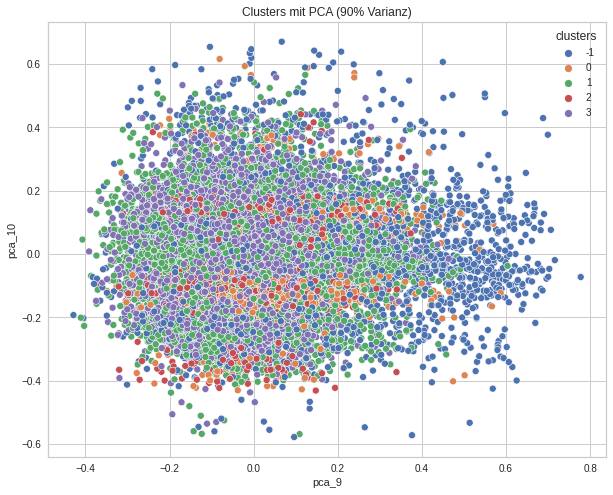

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


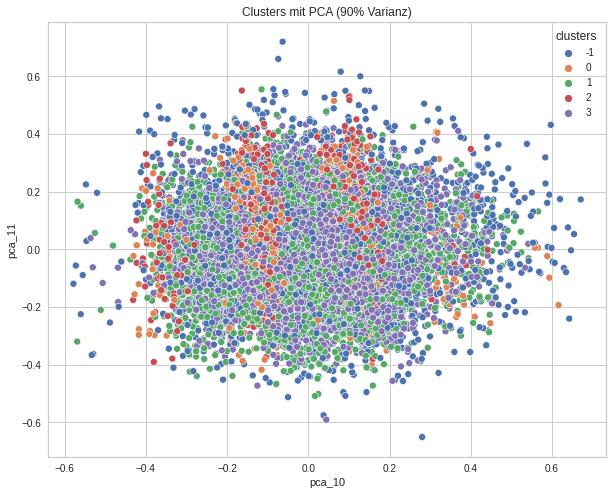

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


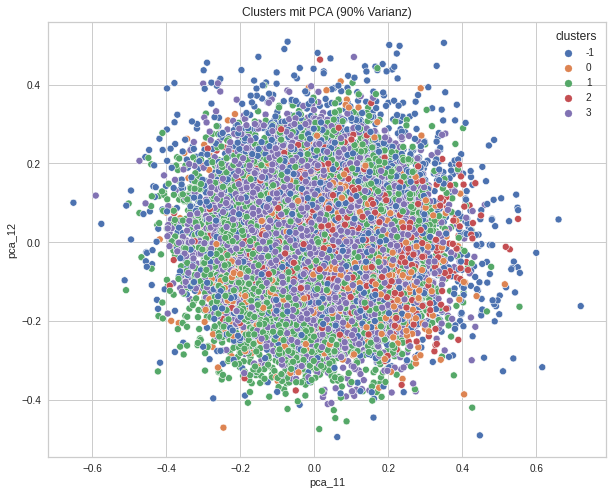

time: 11.8 s (started: 2023-02-16 14:18:14 +00:00)


In [ ]:
#Nicht alle Spaltenkombinationen werden geplottet
for i in range(1, pca_90.n_components_-1):
  #Spalten für das Diagramm wählen
  x_axis = data_pca_90_dbscan['pca_'+ str(i)] #component/column x in table
  y_axis = data_pca_90_dbscan['pca_'+ str(i+1)] #component/column y in table

  #Diagramm Settings
  plt.figure(figsize=(10,8))
  sns.scatterplot(x_axis, y_axis, hue=data_pca_90_dbscan['clusters'], palette ="deep")
  plt.title('Clusters mit PCA (90% Varianz)')

  #Anzeigen
  plt.show()

##DBScan Clustering mit 70% Varianz

####Berechnung

In [ ]:
#eps Wert aus Nearest Neighbor 90% Methode 0.1
#min_samples rule of thumb 1: 2*dim = 2*4 = 8
#min_samples rule of thumb2: min_samples ≥ D + 1 = min_samples ≥ 4 + 1 = 5
db_70 = DBSCAN(eps=0.15, min_samples=8).fit(data_pca_70)

time: 724 ms (started: 2023-02-16 14:21:23 +00:00)


In [ ]:
#Daten kopieren
data_pca_70_dbscan = data_pca_70.copy()

#Spalten hinzufügen
data_pca_70_dbscan['clusters'] = db_70.labels_
data_pca_70_dbscan['player_names'] = player_names
data_pca_70_dbscan.columns = [f"pca_{i+1}" for i in range(pca_70.n_components_)] + ['clusters', 'player_names']

time: 6.24 ms (started: 2023-02-16 14:21:26 +00:00)


In [ ]:
#Speichern
savePickle(db_70, 'db_70')
saveCSV(data_pca_70_dbscan, 'data_pca_70_dbscan')

time: 21.3 ms (started: 2023-02-16 14:21:25 +00:00)


####Visualisierung

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


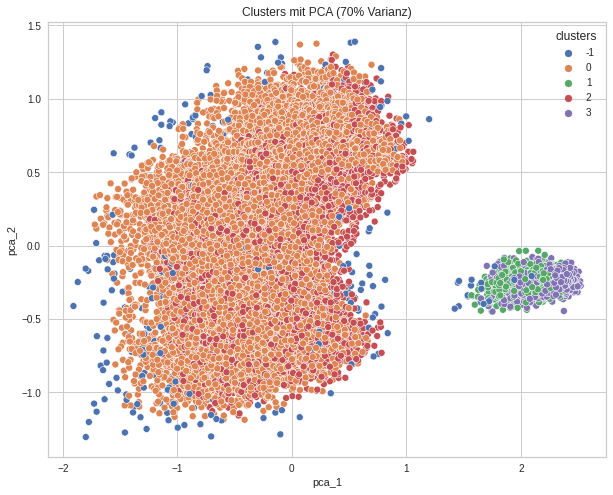

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


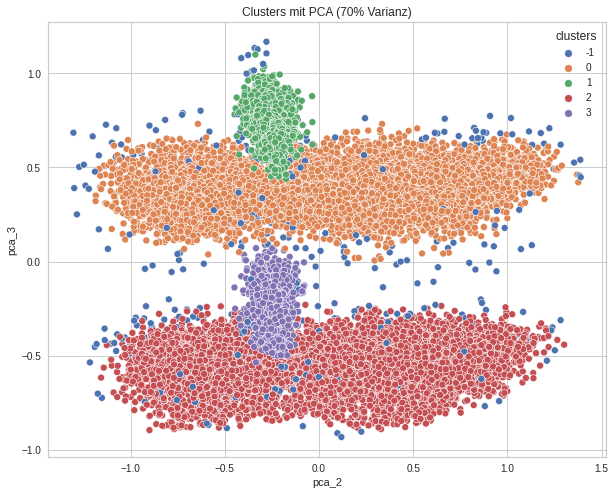

time: 1.98 s (started: 2023-02-16 14:21:31 +00:00)


In [ ]:
#Nicht alle Spaltenkombinationen werden geplottet
for i in range(1, pca_70.n_components_-1):
  #Spalten für das Diagramm wählen
  x_axis = data_pca_70_dbscan['pca_'+ str(i)] #component/column x in table
  y_axis = data_pca_70_dbscan['pca_'+ str(i+1)] #component/column y in table

  #Diagramm Settings
  plt.figure(figsize=(10,8))
  sns.scatterplot(x_axis, y_axis, hue=data_pca_70_dbscan['clusters'], palette ="deep")
  plt.title('Clusters mit PCA (70% Varianz)')

  #Anzeigen
  plt.show()

##Grid Search

###100% Varianz

#### Berechnung

In [ ]:
#Arrays zum speichern der Scores
dbscan_ohne_pca_silhouette = []
dbscan_ohne_pca_davies = []
dbscan_ohne_pca_calinski = []
dbscan_ohne_pca_cluster = []

time: 881 µs (started: 2023-02-18 21:41:54 +00:00)


In [ ]:
#Parameter für die Schleife festlegen
ms_min = len(data_original.columns)-2
ms_max = len(data_original.columns)*2

eps_range = np.arange(eps_100-0.2, eps_100+0.2, schritte)
min_sample_range = np.arange(ms_min, ms_max, 1)

time: 1.77 ms (started: 2023-02-18 21:41:54 +00:00)


In [ ]:
print(ms_min, ms_max)

1 6
time: 853 µs (started: 2023-02-18 23:28:53 +00:00)


In [ ]:
for i in eps_range:
  for j in min_sample_range:

    #DBScan
    dbscan = DBSCAN(eps=i, min_samples=j).fit(data_scaled)

    #Speichern
    filename = 'dbscan_ohnepca_' + str(i) + '_' + str(j)
    savePickle(dbscan, filename)

    #Cluster
    dbscan_ohne_pca_cluster.append(len(np.unique(dbscan.labels_)))

    #Performance Metriken in Arrays speichern
    if (len(np.unique(dbscan.labels_))>1):
      dbscan_ohne_pca_silhouette.append(silhouette_score(data_scaled, dbscan.labels_))
      dbscan_ohne_pca_davies.append(davies_bouldin_score(data_scaled, dbscan.labels_))
      dbscan_ohne_pca_calinski.append(calinski_harabasz_score(data_scaled, dbscan.labels_))
    else:
      dbscan_ohne_pca_silhouette.append(np.nan)
      dbscan_ohne_pca_davies.append(np.nan)
      dbscan_ohne_pca_calinski.append(np.nan)

time: 40min 21s (started: 2023-02-18 21:41:54 +00:00)


In [ ]:
#Reshape
dbscan_ohne_pca_silhouette = np.asarray(dbscan_ohne_pca_silhouette).reshape(len(eps_range), len(min_sample_range))
dbscan_ohne_pca_davies = np.asarray(dbscan_ohne_pca_davies).reshape(len(eps_range), len(min_sample_range))
dbscan_ohne_pca_calinski = np.asarray(dbscan_ohne_pca_calinski).reshape(len(eps_range), len(min_sample_range))
dbscan_ohne_pca_cluster = np.asarray(dbscan_ohne_pca_cluster).reshape(len(eps_range), len(min_sample_range))

time: 2.98 ms (started: 2023-02-18 22:22:15 +00:00)


In [ ]:
#DataFrames erstellen
dbscan_ohne_pca_heatmap_df_silhouette = pd.DataFrame(dbscan_ohne_pca_silhouette, columns = list(min_sample_range), index = list(eps_range))
dbscan_ohne_pca_heatmap_df_davies = pd.DataFrame(dbscan_ohne_pca_davies, columns = list(min_sample_range), index = list(eps_range))
dbscan_ohne_pca_heatmap_df_calinski = pd.DataFrame(dbscan_ohne_pca_calinski, columns = list(min_sample_range), index = list(eps_range))
dbscan_ohne_pca_heatmap_df_cluster = pd.DataFrame(dbscan_ohne_pca_cluster, columns = list(min_sample_range), index = list(eps_range))

time: 25.3 ms (started: 2023-02-18 22:22:15 +00:00)


In [ ]:
#Speichern
savePickle(dbscan_ohne_pca_heatmap_df_silhouette, "dbscan_ohne_pca_heatmap_df_silhouette")
savePickle(dbscan_ohne_pca_heatmap_df_davies, "dbscan_ohne_pca_heatmap_df_davies")
savePickle(dbscan_ohne_pca_heatmap_df_calinski, "dbscan_ohne_pca_heatmap_df_calinski")
savePickle(dbscan_ohne_pca_heatmap_df_cluster, "dbscan_ohne_pca_heatmap_df_cluster")

time: 1.07 s (started: 2023-02-18 22:22:15 +00:00)


#### Visualisierung

In [ ]:
fsize_width = 30
fsize_height = 5
sns.set(font_scale=0.8)

time: 5.02 ms (started: 2023-02-19 01:39:28 +00:00)


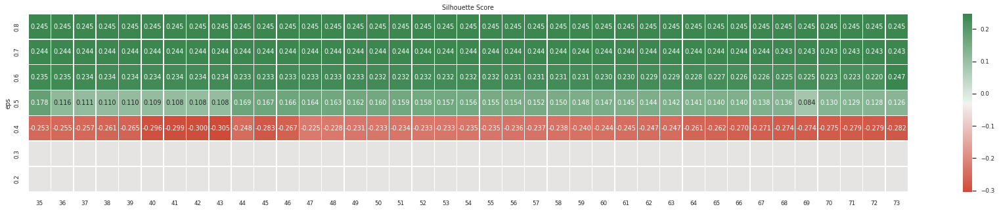

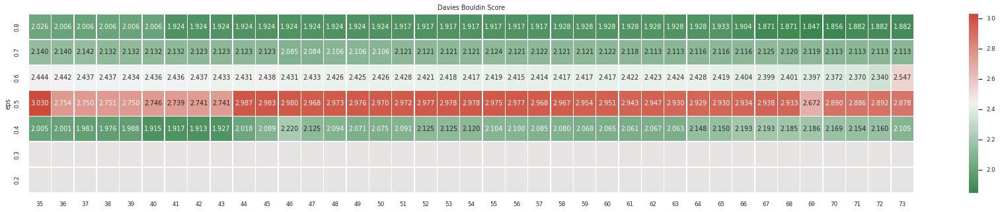

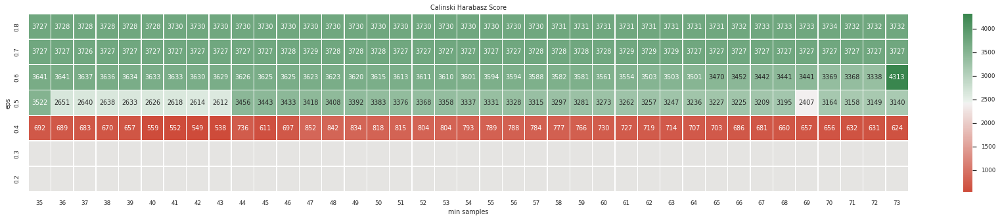

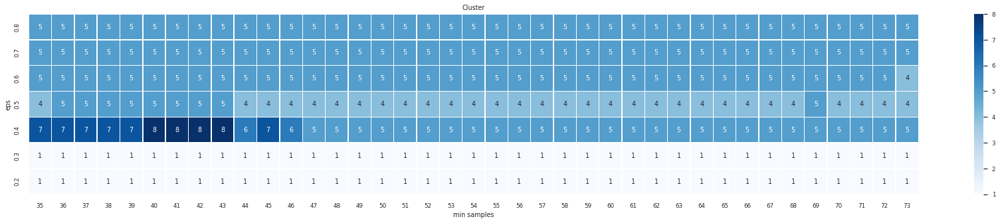

time: 5.34 s (started: 2023-02-19 01:39:32 +00:00)


In [ ]:
#Farbskala einstellen
cmp = sns.diverging_palette(135, 16, as_cmap=True)
cmp_r = sns.diverging_palette(16, 135, as_cmap=True)

#Nicht vorhandene Werte ausgrauen
mask_silhouette = dbscan_ohne_pca_heatmap_df_silhouette.isnull()
mask_davies = dbscan_ohne_pca_heatmap_df_davies.isnull()
mask_calinski = dbscan_ohne_pca_heatmap_df_calinski.isnull()


#Visualisierung silhouette_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_ohne_pca_heatmap_df_silhouette,
                 yticklabels = dbscan_ohne_pca_heatmap_df_silhouette.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.3f',
                 mask = mask_silhouette
                 )

ax.set_facecolor('#E5E4E2')
ax.invert_yaxis()
#ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Silhouette Score")

#-------------------------------------------------------------------------------

#Visualisierung davies_bouldin_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_ohne_pca_heatmap_df_davies,
                 yticklabels = dbscan_ohne_pca_heatmap_df_davies.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp,
                 fmt = '0.3f',
                 mask = mask_davies
                 )

ax.set_facecolor('#E5E4E2')
ax.invert_yaxis()
#ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Davies Bouldin Score")

#-------------------------------------------------------------------------------

#Visualisierung calinski_harabasz_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_ohne_pca_heatmap_df_calinski,
                 yticklabels = dbscan_ohne_pca_heatmap_df_calinski.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.0f',
                 mask = mask_calinski
                 )

ax.set_facecolor('#E5E4E2')
ax.invert_yaxis()
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Calinski Harabasz Score")


#-------------------------------------------------------------------------------

plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_ohne_pca_heatmap_df_cluster,
                 yticklabels = dbscan_ohne_pca_heatmap_df_cluster.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = 'Blues'
                 )

ax.invert_yaxis()
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Cluster")

#-------------------------------------------------------------------------------

plt.show()

####Performance Metriken

In [ ]:
#For Silhouette Score
#get max value
max_value_silhouette_dbscan_ohne_pca = dbscan_ohne_pca_heatmap_df_silhouette.max().max()

#get samples value
df = pd.DataFrame(dbscan_ohne_pca_heatmap_df_silhouette.max())
samples_silhouette_dbscan_ohne_pca = df.index[df[0] == max_value_silhouette_dbscan_ohne_pca].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_ohne_pca_heatmap_df_silhouette[:][samples_silhouette_dbscan_ohne_pca])
eps_silhouette_dbscan_ohne_pca = df.index[df[samples_silhouette_dbscan_ohne_pca] == max_value_silhouette_dbscan_ohne_pca].tolist()[0]

#get cluster
cluster_silhouette_dbscan_ohne_pca = dbscan_ohne_pca_heatmap_df_cluster[samples_silhouette_dbscan_ohne_pca][eps_silhouette_dbscan_ohne_pca]

print('max_value:\t', max_value_silhouette_dbscan_ohne_pca)
print('samples:\t', samples_silhouette_dbscan_ohne_pca)
print('eps:\t\t', eps_silhouette_dbscan_ohne_pca)
print('cluster:\t', cluster_silhouette_dbscan_ohne_pca)

max_value:	 0.24728593019533454
samples:	 73
eps:		 0.6000000000000001
cluster:	 4
time: 14.2 ms (started: 2023-02-18 22:22:21 +00:00)


In [ ]:
#For Davies B. Score
#get min value
min_value_davies_dbscan_ohne_pca = dbscan_ohne_pca_heatmap_df_davies.min().min()

#get samples value
df = pd.DataFrame(dbscan_ohne_pca_heatmap_df_davies.min())
samples_davies_dbscan_ohne_pca = df.index[df[0] == min_value_davies_dbscan_ohne_pca].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_ohne_pca_heatmap_df_davies[:][samples_davies_dbscan_ohne_pca])
eps_davies_dbscan_ohne_pca = df.index[df[samples_davies_dbscan_ohne_pca] == min_value_davies_dbscan_ohne_pca].tolist()[0]

#get cluster
cluster_davies_dbscan_ohne_pca = dbscan_ohne_pca_heatmap_df_cluster[samples_davies_dbscan_ohne_pca][eps_davies_dbscan_ohne_pca]

print('min_value:\t', min_value_davies_dbscan_ohne_pca)
print('samples:\t', samples_davies_dbscan_ohne_pca)
print('eps:\t\t', eps_davies_dbscan_ohne_pca)
print('cluster:\t', cluster_silhouette_dbscan_ohne_pca)

min_value:	 1.8466566503074522
samples:	 69
eps:		 0.8000000000000003
cluster:	 4
time: 11.4 ms (started: 2023-02-18 22:22:21 +00:00)


In [ ]:
#For Calinski H. Score
#get max value
max_value_calinski_dbscan_ohne_pca = dbscan_ohne_pca_heatmap_df_calinski.max().max()

#get samples value
df = pd.DataFrame(dbscan_ohne_pca_heatmap_df_calinski.max())
samples_calinski_dbscan_ohne_pca = df.index[df[0] == max_value_calinski_dbscan_ohne_pca].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_ohne_pca_heatmap_df_calinski[:][samples_calinski_dbscan_ohne_pca])
eps_calinski_dbscan_ohne_pca = df.index[df[samples_calinski_dbscan_ohne_pca] == max_value_calinski_dbscan_ohne_pca].tolist()[0]

#get cluster
cluster_calinski_dbscan_ohne_pca = dbscan_ohne_pca_heatmap_df_cluster[samples_calinski_dbscan_ohne_pca][eps_calinski_dbscan_ohne_pca]

print('max_value:\t', max_value_calinski_dbscan_ohne_pca)
print('samples:\t', samples_calinski_dbscan_ohne_pca)
print('eps:\t\t', eps_calinski_dbscan_ohne_pca)
print('cluster:\t', cluster_calinski_dbscan_ohne_pca)

max_value:	 4312.914706658353
samples:	 73
eps:		 0.6000000000000001
cluster:	 4
time: 8.45 ms (started: 2023-02-18 22:22:21 +00:00)


### 90% Varianz

#### Berechnung

In [ ]:
#Arrays zum speichern der Scores
dbscan_90_silhouette = []
dbscan_90_davies = []
dbscan_90_calinski = []
dbscan_90_cluster = []

time: 970 µs (started: 2023-02-18 22:22:21 +00:00)


In [ ]:
#Parameter für die Schleife festlegen
ms_min = len(data_pca_90.columns)-2
ms_max = len(data_pca_90.columns)*2

eps_range = np.arange(eps_90-0.2, eps_90+0.2, schritte)
min_sample_range = np.arange(ms_min, ms_max, 1)

time: 1.84 ms (started: 2023-02-18 22:22:21 +00:00)


In [ ]:
#DBSCAN Berechnung
for i in eps_range:
  for j in min_sample_range:

    #DBScan
    dbscan = DBSCAN(eps=i, min_samples=j).fit(data_pca_90)

    #Cluster
    dbscan_90_cluster.append(len(np.unique(dbscan.labels_)))

    #Speichern
    filename = 'dbscan_90_' + str(i) + '_' + str(j)
    savePickle(dbscan, filename)

    #Performance Metriken in Arrays speichern
    if (len(np.unique(dbscan.labels_))>1):
      dbscan_90_silhouette.append(silhouette_score(data_pca_90, dbscan.labels_))
      dbscan_90_davies.append(davies_bouldin_score(data_pca_90, dbscan.labels_))
      dbscan_90_calinski.append(calinski_harabasz_score(data_pca_90, dbscan.labels_))
    else:
      dbscan_90_silhouette.append(np.nan)
      dbscan_90_davies.append(np.nan)
      dbscan_90_calinski.append(np.nan)

time: 7min 52s (started: 2023-02-18 22:22:21 +00:00)


In [ ]:
#Reshape
dbscan_90_silhouette = np.asarray(dbscan_90_silhouette).reshape(len(eps_range), len(min_sample_range))
dbscan_90_davies = np.asarray(dbscan_90_davies).reshape(len(eps_range), len(min_sample_range))
dbscan_90_calinski = np.asarray(dbscan_90_calinski).reshape(len(eps_range), len(min_sample_range))
dbscan_90_cluster = np.asarray(dbscan_90_cluster).reshape(len(eps_range), len(min_sample_range))

time: 8.37 ms (started: 2023-02-18 22:30:13 +00:00)


In [ ]:
#DataFrames zum plotten erstellen
dbscan_90_heatmap_df_silhouette = pd.DataFrame(dbscan_90_silhouette, columns = list(min_sample_range), index = list(eps_range))
dbscan_90_heatmap_df_davies = pd.DataFrame(dbscan_90_davies, columns = list(min_sample_range), index = list(eps_range))
dbscan_90_heatmap_df_calinski = pd.DataFrame(dbscan_90_calinski, columns = list(min_sample_range), index = list(eps_range))
dbscan_90_heatmap_df_cluster = pd.DataFrame(dbscan_90_cluster, columns = list(min_sample_range), index = list(eps_range))

time: 15.8 ms (started: 2023-02-18 22:30:13 +00:00)


In [ ]:
#Speichern
savePickle(dbscan_90_heatmap_df_silhouette, "dbscan_90_heatmap_df_silhouette")
savePickle(dbscan_90_heatmap_df_davies, "dbscan_90_heatmap_df_davies")
savePickle(dbscan_90_heatmap_df_calinski, "dbscan_90_heatmap_df_calinski")
savePickle(dbscan_90_heatmap_df_cluster, "dbscan_90_heatmap_df_cluster")

time: 1.29 s (started: 2023-02-18 22:30:13 +00:00)


#### Visualisierung

In [ ]:
sns.set(font_scale=0.8)

time: 1.98 ms (started: 2023-02-19 01:41:04 +00:00)


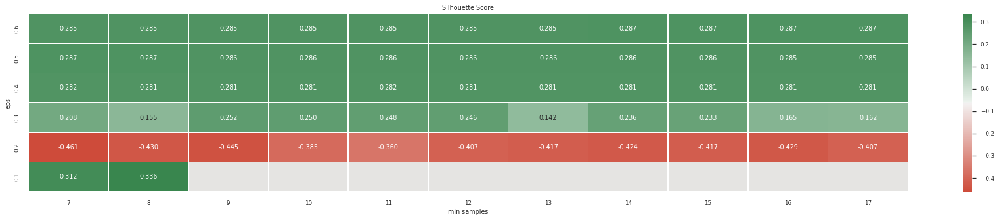

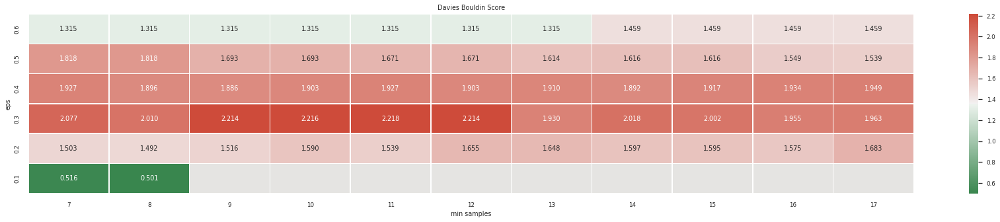

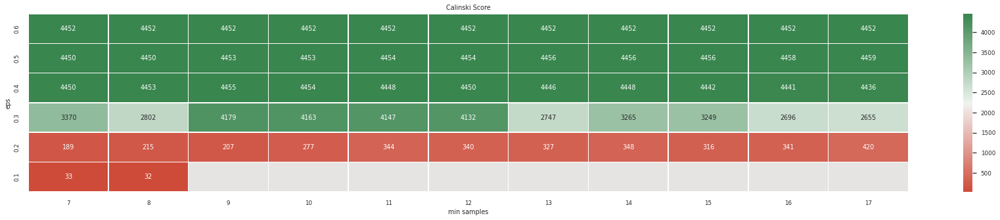

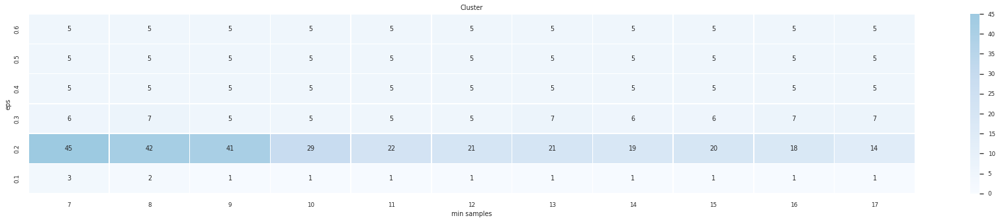

time: 5.86 s (started: 2023-02-19 01:41:28 +00:00)


In [ ]:
#Farbskala einstellen
cmp = sns.diverging_palette(135, 16, as_cmap=True)
cmp_r = sns.diverging_palette(16, 135, as_cmap=True)

#Nicht vorhandene Werte ausgrauen
mask_silhouette = dbscan_90_heatmap_df_silhouette.isnull()
mask_davies = dbscan_90_heatmap_df_davies.isnull()
mask_calinski = dbscan_90_heatmap_df_calinski.isnull()


#Visualisierung silhouette_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_90_heatmap_df_silhouette,
                 yticklabels = dbscan_90_heatmap_df_silhouette.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.3f',
                 mask = mask_silhouette
                 )

ax.invert_yaxis()
ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Silhouette Score")

#-------------------------------------------------------------------------------

#Visualisierung davies_bouldin_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_90_heatmap_df_davies,
                 yticklabels = dbscan_90_heatmap_df_davies.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp,
                 fmt = '0.3f'
                 )

ax.invert_yaxis()
ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Davies Bouldin Score")

#-------------------------------------------------------------------------------

#Visualisierung calinski_harabasz_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_90_heatmap_df_calinski,
                 yticklabels = dbscan_90_heatmap_df_calinski.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.0f'
                 )

ax.invert_yaxis()
ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Calinski Score")

#-------------------------------------------------------------------------------

plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_90_heatmap_df_cluster,
                 yticklabels = dbscan_90_heatmap_df_cluster.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = 'Blues',
                 fmt = '0.0f',
                 center = 60,
                 vmin=0
                 )

ax.invert_yaxis()
ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Cluster")

#-------------------------------------------------------------------------------

plt.show()

####Performance Metriken

In [ ]:
#For Silhouette Score
#get max value
max_value_silhouette_dbscan_90 = dbscan_90_heatmap_df_silhouette.max().max()

#get samples value
df = pd.DataFrame(dbscan_90_heatmap_df_silhouette.max())
samples_silhouette_dbscan_90 = df.index[df[0] == max_value_silhouette_dbscan_90].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_90_heatmap_df_silhouette[:][samples_silhouette_dbscan_90])
eps_silhouette_dbscan_90 = df.index[df[samples_silhouette_dbscan_90] == max_value_silhouette_dbscan_90].tolist()[0]

#get cluster
cluster_silhouette_dbscan_90 = dbscan_90_heatmap_df_cluster[samples_silhouette_dbscan_90][eps_silhouette_dbscan_90]

print('max value silhouette:\t', max_value_silhouette_dbscan_90)
print('samples:\t\t', samples_silhouette_dbscan_90)
print('eps:\t\t\t', eps_silhouette_dbscan_90)
print('cluster:\t\t', cluster_silhouette_dbscan_90)

max value silhouette:	 0.3363741131048714
samples:		 8
eps:			 0.1
cluster:		 2
time: 11.8 ms (started: 2023-02-18 22:30:17 +00:00)


In [ ]:
#For Davies B. Score
#get min value
min_value_davies_dbscan_90 = dbscan_90_heatmap_df_davies.min().min()

#get samples value
df = pd.DataFrame(dbscan_90_heatmap_df_davies.min())
samples_davies_dbscan_90 = df.index[df[0] == min_value_davies_dbscan_90].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_90_heatmap_df_davies[:][samples_davies_dbscan_90])
eps_davies_dbscan_90 = df.index[df[samples_davies_dbscan_90] == min_value_davies_dbscan_90].tolist()[0]

#get cluster
cluster_davies_dbscan_90 = dbscan_90_heatmap_df_cluster[samples_davies_dbscan_90][eps_davies_dbscan_90]

print('min_value_davies:\t', min_value_davies_dbscan_90)
print('samples:\t\t', samples_davies_dbscan_90)
print('eps:\t\t\t', eps_davies_dbscan_90)
print('cluster:\t\t', cluster_davies_dbscan_90)

min_value_davies:	 0.500667763535362
samples:		 8
eps:			 0.1
cluster:		 2
time: 5.91 ms (started: 2023-02-18 22:30:17 +00:00)


In [ ]:
#For Calinski H. Score
#get max value
max_value_calinski_dbscan_90 = dbscan_90_heatmap_df_calinski.max().max()

#get samples value
df = pd.DataFrame(dbscan_90_heatmap_df_calinski.max())
samples_calinski_dbscan_90 = df.index[df[0] == max_value_calinski_dbscan_90].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_90_heatmap_df_calinski[:][samples_calinski_dbscan_90])
eps_calinski_dbscan_90 = df.index[df[samples_calinski_dbscan_90] == max_value_calinski_dbscan_90].tolist()[0]

#get cluster
cluster_calinski_dbscan_90 = dbscan_90_heatmap_df_cluster[samples_calinski_dbscan_90][eps_calinski_dbscan_90]

print('max value calinski score:\t', max_value_calinski_dbscan_90)
print('samples:\t\t\t', samples_calinski_dbscan_90)
print('eps:\t\t\t\t', eps_calinski_dbscan_90)
print('cluster:\t\t\t', cluster_calinski_dbscan_90)

max value calinski score:	 4459.177279658986
samples:			 17
eps:				 0.5
cluster:			 5
time: 5.64 ms (started: 2023-02-18 22:30:17 +00:00)


###70% Varianz

#### Berechnung

In [ ]:
#Arrays zum speichern der Scores
dbscan_70_silhouette = []
dbscan_70_davies = []
dbscan_70_calinski = []
dbscan_70_cluster = []

time: 872 µs (started: 2023-02-18 22:30:17 +00:00)


In [ ]:
#Parameter für die Schleife festlegen
ms_min = len(data_pca_70.columns)-1
ms_max = len(data_pca_70.columns)*2

eps_range = np.arange(eps_70, eps_70+0.2, 0.05)
min_sample_range = np.arange(ms_min, ms_max, 1)

time: 915 µs (started: 2023-02-18 22:30:17 +00:00)


In [ ]:
#DBSCAN Berechnung
for i in eps_range:
  for j in min_sample_range:

    #DBScan
    dbscan = DBSCAN(eps=i, min_samples=j).fit(data_pca_70)

    #Cluster
    dbscan_70_cluster.append(len(np.unique(dbscan.labels_)))

    #Speichern
    filename = 'dbscan_70_' + str(i) + '_' + str(j)
    savePickle(dbscan, filename)

    #Performance Metriken in Arrays speichern
    if (len(np.unique(dbscan.labels_))>1):
      dbscan_70_silhouette.append(silhouette_score(data_pca_70, dbscan.labels_))
      dbscan_70_davies.append(davies_bouldin_score(data_pca_70, dbscan.labels_))
      dbscan_70_calinski.append(calinski_harabasz_score(data_pca_70, dbscan.labels_))
    else:
      dbscan_70_silhouette.append(np.nan)
      dbscan_70_davies.append(np.nan)
      dbscan_70_calinski.append(np.nan)

time: 1min 57s (started: 2023-02-18 22:30:17 +00:00)


In [ ]:
#Reshape
dbscan_70_silhouette = np.asarray(dbscan_70_silhouette).reshape(len(eps_range), len(min_sample_range))
dbscan_70_davies = np.asarray(dbscan_70_davies).reshape(len(eps_range), len(min_sample_range))
dbscan_70_calinski = np.asarray(dbscan_70_calinski).reshape(len(eps_range), len(min_sample_range))
dbscan_70_cluster = np.asarray(dbscan_70_cluster).reshape(len(eps_range), len(min_sample_range))

time: 1.74 ms (started: 2023-02-18 22:32:15 +00:00)


In [ ]:
#DataFrames zum plotten erstellen
dbscan_70_heatmap_df_silhouette = pd.DataFrame(dbscan_70_silhouette, columns = list(min_sample_range), index = list(eps_range))
dbscan_70_heatmap_df_davies = pd.DataFrame(dbscan_70_davies, columns = list(min_sample_range), index = list(eps_range))
dbscan_70_heatmap_df_calinski = pd.DataFrame(dbscan_70_calinski, columns = list(min_sample_range), index = list(eps_range))
dbscan_70_heatmap_df_cluster = pd.DataFrame(dbscan_70_cluster, columns = list(min_sample_range), index = list(eps_range))

time: 3.59 ms (started: 2023-02-18 22:32:15 +00:00)


In [ ]:
#Speichern
savePickle(dbscan_70_heatmap_df_silhouette, "dbscan_70_heatmap_df_silhouette")
savePickle(dbscan_70_heatmap_df_davies, "dbscan_70_heatmap_df_davies")
savePickle(dbscan_70_heatmap_df_calinski, "dbscan_70_heatmap_df_calinski")
savePickle(dbscan_70_heatmap_df_cluster, "dbscan_70_heatmap_df_cluster")

time: 1.27 s (started: 2023-02-18 22:32:15 +00:00)


#### Visualisierung

In [ ]:
sns.set(font_scale=0.8)

time: 1.89 ms (started: 2023-02-19 01:50:16 +00:00)


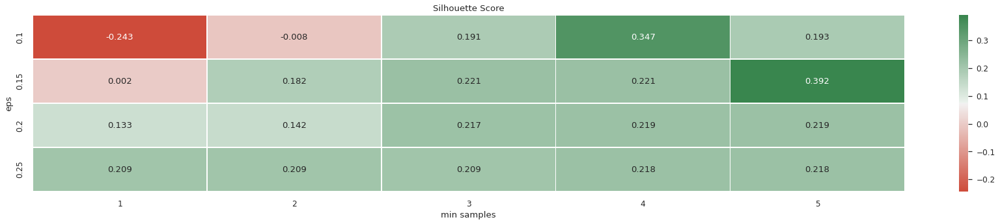

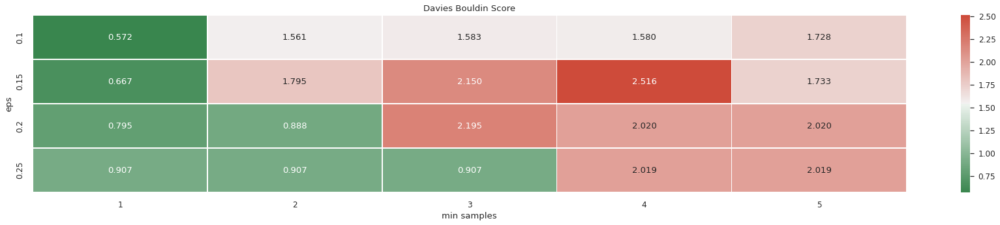

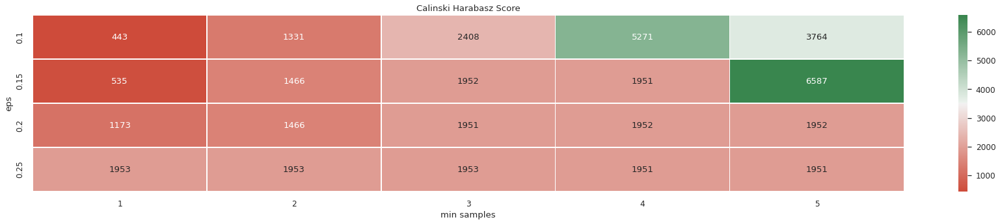

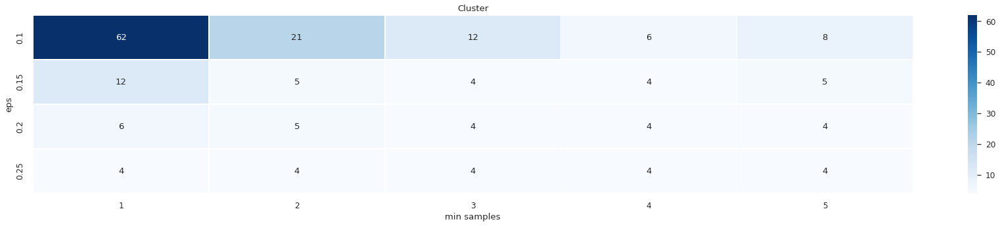

time: 1.41 s (started: 2023-02-19 01:50:19 +00:00)


In [ ]:
#Farbskala einstellen
cmp = sns.diverging_palette(135, 16, as_cmap=True)
cmp_r = sns.diverging_palette(16, 135, as_cmap=True)
sns.set(font_scale=1.1)

#Nicht vorhandene Werte ausgrauen
mask_silhouette = dbscan_70_heatmap_df_silhouette.isnull()
mask_davies = dbscan_70_heatmap_df_davies.isnull()
mask_calinski = dbscan_70_heatmap_df_calinski.isnull()


#Visualisierung silhouette_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_70_heatmap_df_silhouette,
                 yticklabels = dbscan_70_heatmap_df_silhouette.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.3f',
                 mask = mask_silhouette
                 )

ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Silhouette Score")

#-------------------------------------------------------------------------------

#Visualisierung davies_bouldin_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_70_heatmap_df_davies,
                 yticklabels = dbscan_70_heatmap_df_davies.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp,
                 fmt = '0.3f'
                 )

ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title('Davies Bouldin Score')

#-------------------------------------------------------------------------------

#Visualisierung calinski_harabasz_score
plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_70_heatmap_df_calinski,
                 yticklabels = dbscan_70_heatmap_df_calinski.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = cmp_r,
                 fmt = '0.0f'
                 )

ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title('Calinski Harabasz Score')

#-------------------------------------------------------------------------------

plt.figure(figsize = (fsize_width,fsize_height))
ax = sns.heatmap(dbscan_70_heatmap_df_cluster,
                 yticklabels = dbscan_70_heatmap_df_cluster.index.values.round(2),
                 annot = True,
                 linewidths= .5,
                 cmap = 'Blues'
                 )

ax.set_facecolor('#E5E4E2')
ax.set_xlabel("min samples")
ax.set_ylabel('eps')
plt.title("Cluster")

#-------------------------------------------------------------------------------

plt.show()

####Performance Metriken

In [ ]:
#For Silhouette Score
#get max value
max_value_silhouette_dbscan_70 = dbscan_70_heatmap_df_silhouette.max().max()

#get samples value
df = pd.DataFrame(dbscan_70_heatmap_df_silhouette.max())
samples_silhouette_dbscan_70 = df.index[df[0] == max_value_silhouette_dbscan_70].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_70_heatmap_df_silhouette[:][samples_silhouette_dbscan_70])
eps_silhouette_dbscan_70 = df.index[df[samples_silhouette_dbscan_70] == max_value_silhouette_dbscan_70].tolist()[0]

#get cluster
cluster_silhouette_dbscan_70 = dbscan_70_heatmap_df_cluster[samples_silhouette_dbscan_70][eps_silhouette_dbscan_70]

print('max_value_silhouette score:\t', max_value_silhouette_dbscan_70)
print('samples:\t\t\t', samples_silhouette_dbscan_70)
print('eps:\t\t\t\t', eps_silhouette_dbscan_70)
print('cluster:\t\t\t', cluster_silhouette_dbscan_70)

max_value_silhouette score:	 0.39168808384514403
samples:			 5
eps:				 0.15000000000000002
cluster:			 5
time: 14.8 ms (started: 2023-02-18 22:32:18 +00:00)


In [ ]:
#For Davies B. Score
#get min value
min_value_davies_dbscan_70 = dbscan_70_heatmap_df_davies.min().min()

#get samples value
df = pd.DataFrame(dbscan_70_heatmap_df_davies.min())
samples_davies_dbscan_70 = df.index[df[0] == min_value_davies_dbscan_70].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_70_heatmap_df_davies[:][samples_davies_dbscan_70])
eps_davies_dbscan_70 = df.index[df[samples_davies_dbscan_70] == min_value_davies_dbscan_70].tolist()[0]

#get cluster
cluster_davies_dbscan_70 = dbscan_70_heatmap_df_cluster[samples_davies_dbscan_70][eps_davies_dbscan_70]

print('min_value_davies_dbscan_70:\t', min_value_davies_dbscan_70)
print('samples_davies_dbscan_70:\t', samples_davies_dbscan_70)
print('eps_davies_dbscan_70:\t\t', eps_davies_dbscan_70)
print('cluster:\t\t\t', cluster_davies_dbscan_70)

min_value_davies_dbscan_70:	 0.5716212423174067
samples_davies_dbscan_70:	 1
eps_davies_dbscan_70:		 0.1
cluster:			 62
time: 9.01 ms (started: 2023-02-18 22:32:18 +00:00)


In [ ]:
#For Calinski H. Score
#get max value
max_value_calinski_dbscan_70 = dbscan_70_heatmap_df_calinski.max().max()

#get samples value
df = pd.DataFrame(dbscan_70_heatmap_df_calinski.max())
samples_calinski_dbscan_70 = df.index[df[0] == max_value_calinski_dbscan_70].tolist()[0]

#get eps value
df = pd.DataFrame(dbscan_70_heatmap_df_calinski[:][samples_calinski_dbscan_70])
eps_calinski_dbscan_70 = df.index[df[samples_calinski_dbscan_70] == max_value_calinski_dbscan_70].tolist()[0]

#get cluster
cluster_calinski_dbscan_70 = dbscan_70_heatmap_df_cluster[samples_calinski_dbscan_70][eps_calinski_dbscan_70]

print('max_value_calinski_dbscan_70:\t', max_value_calinski_dbscan_70)
print('samples_calinski_dbscan_70:\t', samples_calinski_dbscan_70)
print('eps_calinski_dbscan_70:\t\t', eps_calinski_dbscan_70)
print('cluster:\t\t\t', cluster_calinski_dbscan_70)

max_value_calinski_dbscan_70:	 6587.087039423271
samples_calinski_dbscan_70:	 5
eps_calinski_dbscan_70:		 0.15000000000000002
cluster:			 5
time: 15.9 ms (started: 2023-02-18 22:32:18 +00:00)


#Clustering nach dem agglomerativen hierarchischen Verfahren

##Daten kopieren

In [ ]:
data_ohne_pca_hierarchy = data_scaled_df.copy()
data_pca_90_hierarchy = data_pca_90.copy()
data_pca_70_hierarchy = data_pca_70.copy()

time: 9.88 ms (started: 2023-02-19 06:34:02 +00:00)


## Complete Linkage Clustering

###Mit 100% Varianz

####Berechnung

In [ ]:
#hierarchisches Clustering
complete_ohnepca = linkage(data_scaled_df, method="complete", metric='euclidean')

time: 38 s (started: 2023-02-19 06:34:02 +00:00)


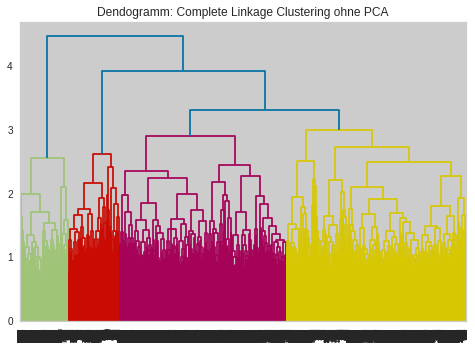

<Figure size 720x504 with 0 Axes>

time: 9min 41s (started: 2023-02-19 06:34:40 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_complete_ohnepca = dendrogram(complete_ohnepca)
dendogramm_complete_ohnepca = plt.title("Dendogramm: Complete Linkage Clustering ohne PCA")
dendogramm_complete_ohnepca = plt.figure(figsize=(10, 7))
dendogramm_complete_ohnepca.show()

In [ ]:
#Labels zum Df hinzufügen
cluster_labels = cut_tree(complete_ohnepca, n_clusters=3).reshape(-1, )
data_ohne_pca_hierarchy['Cluster_Labels_complete_ohne_pca'] = cluster_labels

time: 3.24 s (started: 2023-02-19 06:44:22 +00:00)


In [ ]:
#Speichern
savePickle(complete_ohnepca, 'complete_ohnepca')
savePickle(dendogramm_complete_ohnepca, 'dendogramm_complete_ohnepca')
saveCSV(data_ohne_pca_hierarchy, 'data_ohne_pca_hierarchy')

time: 11.8 s (started: 2023-02-19 06:44:25 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

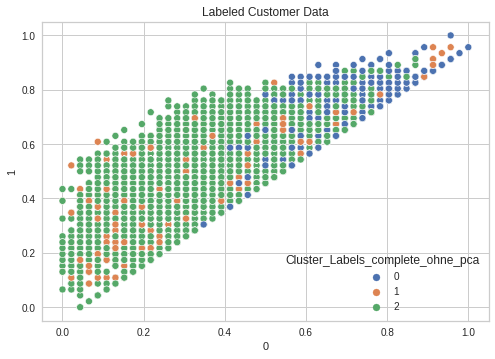

time: 1.72 s (started: 2023-02-19 06:44:37 +00:00)


In [ ]:
sns.scatterplot(x=data_ohne_pca_hierarchy[0], 
                y=data_ohne_pca_hierarchy[1], 
                data=data_ohne_pca_hierarchy, 
                hue=data_ohne_pca_hierarchy['Cluster_Labels_complete_ohne_pca'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_complete_ohne_pca_silhouette = silhouette_score(data_scaled, cluster_labels)
performance_complete_ohne_pca_davies = davies_bouldin_score(data_scaled, cluster_labels)
performance_complete_ohne_pca_calinski = calinski_harabasz_score(data_scaled, cluster_labels)

performance_complete_ohne_pca_cluster = len(np.unique(cluster_labels))

time: 6.89 s (started: 2023-02-19 06:44:39 +00:00)


###Mit 90% Varianz

####Berechnung

In [ ]:
#hierarchisches Clustering
complete_90 = linkage(data_pca_90, method="complete", metric='euclidean')

time: 19.3 s (started: 2023-02-19 06:44:46 +00:00)


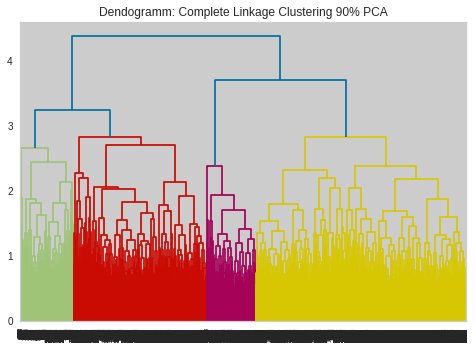

<Figure size 720x504 with 0 Axes>

time: 10min 14s (started: 2023-02-19 06:45:05 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_complete_90 = dendrogram(complete_90)
dendogramm_complete_90 = plt.title("Dendogramm: Complete Linkage Clustering 90% PCA")
dendogramm_complete_90 = plt.figure(figsize=(10, 7))
dendogramm_complete_90.show()

In [ ]:
#Lbales zum DF hinzufügen
cluster_labels = cut_tree(complete_90, n_clusters=3).reshape(-1, )
data_pca_90_hierarchy['Cluster_Labels_complete_90'] = cluster_labels

time: 4.26 s (started: 2023-02-19 06:55:20 +00:00)


In [ ]:
#Speichern
savePickle(complete_90, 'complete_90')
savePickle(dendogramm_complete_90, 'dendogramm_complete_90')
saveCSV(data_pca_90_hierarchy, 'data_pca_90_hierarchy')

time: 1.08 s (started: 2023-02-19 06:55:24 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

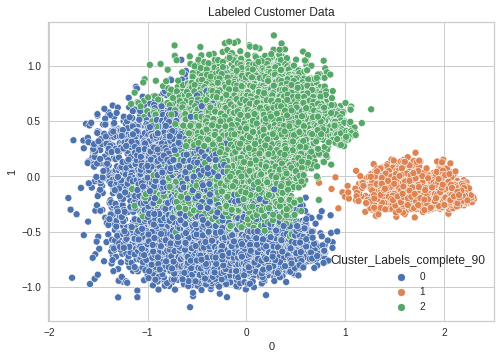

time: 2.19 s (started: 2023-02-19 06:55:25 +00:00)


In [ ]:
sns.scatterplot(x=data_pca_90_hierarchy[0], 
                y=data_pca_90_hierarchy[1], 
                data=data_pca_90_hierarchy, 
                hue=data_pca_90_hierarchy['Cluster_Labels_complete_90'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_complete_90_silhouette = silhouette_score(data_pca_90, cluster_labels)
performance_complete_90_davies = davies_bouldin_score(data_pca_90, cluster_labels)
performance_complete_90_calinski = calinski_harabasz_score(data_pca_90, cluster_labels)

performance_complete_90_cluster = len(np.unique(cluster_labels))

time: 4.78 s (started: 2023-02-19 06:55:27 +00:00)


###Mit 70% Varianz

####Berechnung

In [ ]:
#hierarchisches Clustering
complete_70 = linkage(data_pca_70, method="complete", metric='euclidean')

time: 18.9 s (started: 2023-02-19 06:55:32 +00:00)


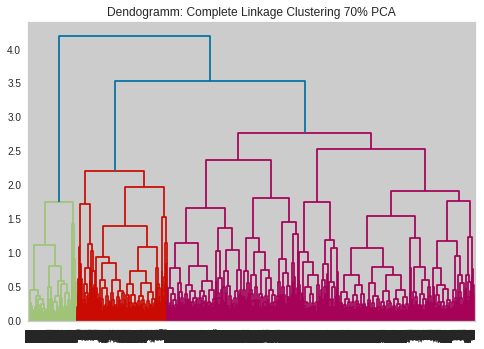

<Figure size 720x504 with 0 Axes>

time: 9min 58s (started: 2023-02-19 06:55:51 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_complete_70 = dendrogram(complete_70)
dendogramm_complete_70 = plt.title("Dendogramm: Complete Linkage Clustering 70% PCA")
dendogramm_complete_70 = plt.figure(figsize=(10, 7))
dendogramm_complete_70.show()

In [ ]:
#Labels zum Data Frame hinzufügen
cluster_labels = cut_tree(complete_70, n_clusters=3).reshape(-1, )
data_pca_70_hierarchy['Cluster_Labels_complete_70'] = cluster_labels

time: 3.2 s (started: 2023-02-19 07:05:50 +00:00)


In [ ]:
#Speichern
savePickle(complete_70, 'complete_70')
savePickle(dendogramm_complete_70, 'dendogramm_complete_70')
saveCSV(data_pca_70_hierarchy, 'data_pca_70_hierarchy')

time: 941 ms (started: 2023-02-19 07:05:53 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

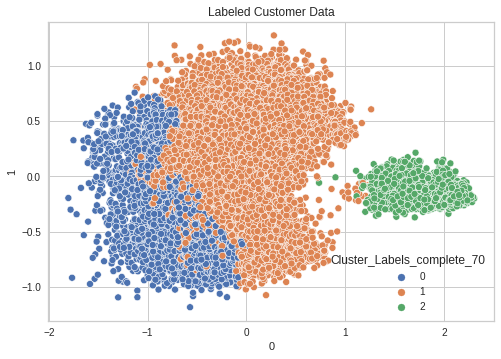

time: 3.07 s (started: 2023-02-19 07:05:54 +00:00)


In [ ]:
sns.scatterplot(x=data_pca_70_hierarchy[0], 
                y=data_pca_70_hierarchy[1], 
                data=data_pca_70_hierarchy, 
                hue=data_pca_70_hierarchy['Cluster_Labels_complete_70'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_complete_70_silhouette = silhouette_score(data_pca_70, cluster_labels)
performance_complete_70_davies = davies_bouldin_score(data_pca_70, cluster_labels)
performance_complete_70_calinski = calinski_harabasz_score(data_pca_70, cluster_labels)

performance_complete_70_cluster = len(np.unique(cluster_labels))

time: 6.21 s (started: 2023-02-19 07:05:57 +00:00)


## Average Linkage Clustering

###Ohne PCA

####Berechnung

In [ ]:
#hierarchisches Clustering
average_ohnepca = linkage(data_scaled_df, method="average", metric='euclidean')

time: 29.8 s (started: 2023-02-19 07:06:03 +00:00)


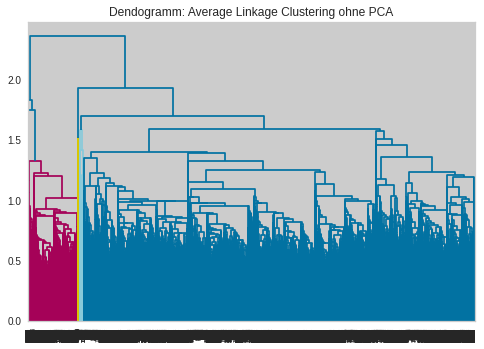

<Figure size 720x504 with 0 Axes>

time: 9min 55s (started: 2023-02-19 07:06:33 +00:00)


In [ ]:
#Visualisierung
dendogramm_average_ohnepca = dendrogram(average_ohnepca)
dendogramm_average_ohnepca = plt.title("Dendogramm: Average Linkage Clustering ohne PCA")
dendogramm_average_ohnepca = plt.figure(figsize=(10, 7))
dendogramm_average_ohnepca.show()

In [ ]:
#Labels zum DF hinzufügen
cluster_labels = cut_tree(average_ohnepca, n_clusters=3).reshape(-1, )
data_ohne_pca_hierarchy['Cluster_Labels_average_ohne_pca'] = cluster_labels

time: 4.91 s (started: 2023-02-19 07:16:28 +00:00)


In [ ]:
#Speichern
savePickle(average_ohnepca, 'average_ohnepca')
savePickle(dendogramm_average_ohnepca, 'dendogramm_average_ohnepca')
saveCSV(data_ohne_pca_hierarchy, 'data_ohne_pca_hierarchy')

time: 2.21 s (started: 2023-02-19 07:16:33 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

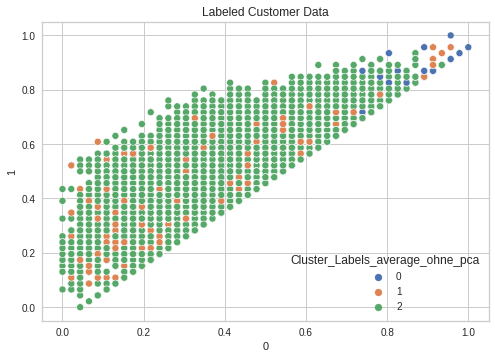

time: 1.46 s (started: 2023-02-19 07:16:35 +00:00)


In [ ]:
sns.scatterplot(x=data_ohne_pca_hierarchy[0], 
                y=data_ohne_pca_hierarchy[1], 
                data=data_ohne_pca_hierarchy, 
                hue=data_ohne_pca_hierarchy['Cluster_Labels_average_ohne_pca'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_average_ohne_pca_silhouette = silhouette_score(data_scaled_df, cluster_labels)
performance_average_ohne_pca_davies = davies_bouldin_score(data_scaled_df, cluster_labels)
performance_average_ohne_pca_calinski = calinski_harabasz_score(data_scaled_df, cluster_labels)

performance_average_ohne_pca_cluster = len(np.unique(cluster_labels))

time: 6.32 s (started: 2023-02-19 07:16:37 +00:00)


###90%

####Berechnung

In [ ]:
#hierarchisches Clustering
average_90 = linkage(data_pca_90, method="average", metric='euclidean')

time: 23.7 s (started: 2023-02-19 07:16:43 +00:00)


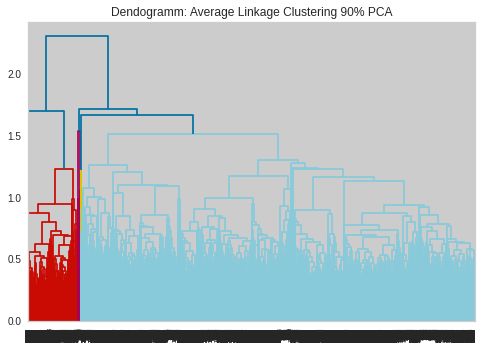

<Figure size 720x504 with 0 Axes>

time: 9min 54s (started: 2023-02-19 07:17:07 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_average_90 = dendrogram(average_90)
dendogramm_average_90 = plt.title("Dendogramm: Average Linkage Clustering 90% PCA")
dendogramm_average_90 = plt.figure(figsize=(10, 7))
dendogramm_average_90.show()

In [ ]:
#Labels zum DF hinzufügen
cluster_labels = cut_tree(average_90, n_clusters=3).reshape(-1, )
data_pca_90_hierarchy['Cluster_Labels_average_90'] = cluster_labels

time: 3.8 s (started: 2023-02-19 07:27:01 +00:00)


In [ ]:
#Speichern
savePickle(average_90, 'average_90')
savePickle(dendogramm_average_90, 'dendogramm_average_90')
saveCSV(data_pca_90_hierarchy, 'data_pca_90_hierarchy')

time: 893 ms (started: 2023-02-19 07:27:05 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

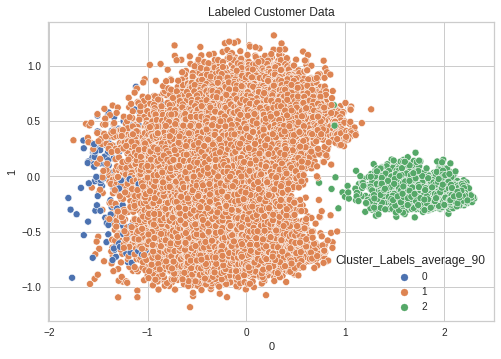

time: 1.61 s (started: 2023-02-19 07:27:06 +00:00)


In [ ]:
sns.scatterplot(x=data_pca_90_hierarchy[0], 
                y=data_pca_90_hierarchy[1], 
                data=data_pca_90_hierarchy, 
                hue=data_pca_90_hierarchy['Cluster_Labels_average_90'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_average_90_silhouette = silhouette_score(data_pca_90, cluster_labels)
performance_average_90_davies = davies_bouldin_score(data_pca_90, cluster_labels)
performance_average_90_calinski = calinski_harabasz_score(data_pca_90, cluster_labels)

performance_average_90_cluster = len(np.unique(cluster_labels))

time: 7.77 s (started: 2023-02-19 07:27:07 +00:00)


###70%

####Berechnung

In [ ]:
#hierarchisches Clustering
average_70 = linkage(data_pca_70, method="average", metric='euclidean')

time: 24.3 s (started: 2023-02-19 07:27:15 +00:00)


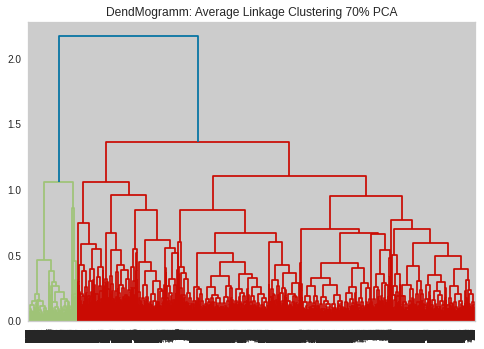

<Figure size 720x504 with 0 Axes>

time: 12min 47s (started: 2023-02-19 07:27:39 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_average_70 = dendrogram(average_70)
dendogramm_average_70 = plt.title("DendMogramm: Average Linkage Clustering 70% PCA")
dendogramm_average_70 = plt.figure(figsize=(10, 7))
dendogramm_average_70.show()

In [ ]:
#Labels zum DF hinzufügen
cluster_labels = cut_tree(average_70, n_clusters=3).reshape(-1, )
data_pca_70_hierarchy['Cluster_Labels_average_70'] = cluster_labels

time: 5.37 s (started: 2023-02-19 07:40:27 +00:00)


In [ ]:
#Speichern
savePickle(average_70, 'average_70')
savePickle(dendogramm_average_70, 'dendogramm_average_70')
saveCSV(data_pca_70_hierarchy, 'data_pca_70_hierarchy')

time: 757 ms (started: 2023-02-19 07:40:32 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

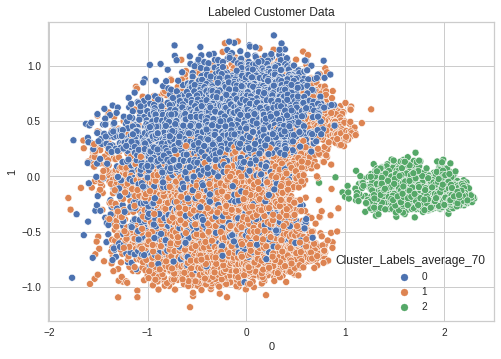

time: 1.82 s (started: 2023-02-19 07:40:33 +00:00)


In [ ]:
sns.scatterplot(x=data_pca_70_hierarchy[0], 
                y=data_pca_70_hierarchy[1], 
                data=data_pca_70_hierarchy, 
                hue=data_pca_70_hierarchy['Cluster_Labels_average_70'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_average_70_silhouette = silhouette_score(data_pca_70, cluster_labels)
performance_average_70_davies = davies_bouldin_score(data_pca_70, cluster_labels)
performance_average_70_calinski = calinski_harabasz_score(data_pca_70, cluster_labels)

performance_average_70_cluster = len(np.unique(cluster_labels))

time: 11.9 s (started: 2023-02-19 07:40:35 +00:00)


## Ward Linkage lustering

###Ohne PCA

####Berechnung

In [ ]:
#hierarchisches Clustering
ward_ohnepca = linkage(data_scaled_df, method="ward", metric='euclidean')

time: 55.5 s (started: 2023-02-19 07:40:47 +00:00)


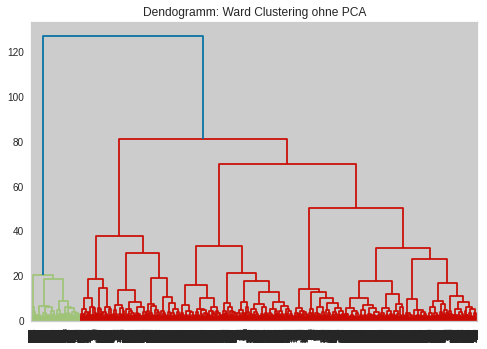

<Figure size 720x504 with 0 Axes>

time: 10min 18s (started: 2023-02-19 07:41:42 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_ward_ohnepca = dendrogram(ward_ohnepca)
dendogramm_ward_ohnepca = plt.title("Dendogramm: Ward Clustering ohne PCA")
dendogramm_ward_ohnepca = plt.figure(figsize=(10, 7))
dendogramm_ward_ohnepca.show()

In [ ]:
#Labels zum Df hinzufügen
cluster_labels = cut_tree(ward_ohnepca, n_clusters=3).reshape(-1, )
data_ohne_pca_hierarchy['Cluster_Labels_ward_ohne_pca'] = cluster_labels

time: 4.27 s (started: 2023-02-19 07:52:01 +00:00)


In [ ]:
#Speichern
savePickle(ward_ohnepca, 'ward_ohnepca')
savePickle(dendogramm_ward_ohnepca, 'dendogramm_ward_ohnepca')
saveCSV(data_ohne_pca_hierarchy, 'data_ohne_pca_hierarchy')

time: 1.63 s (started: 2023-02-19 07:52:05 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

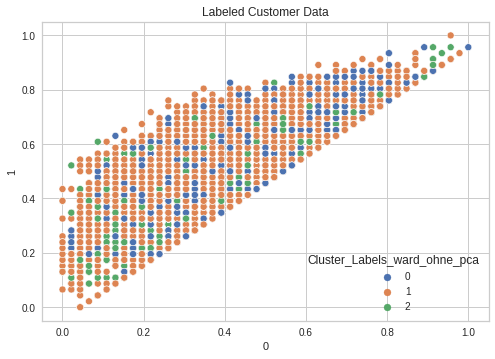

time: 1.38 s (started: 2023-02-19 07:52:06 +00:00)


In [ ]:
sns.scatterplot(x=data_ohne_pca_hierarchy[0], 
                y=data_ohne_pca_hierarchy[1], 
                data=data_ohne_pca_hierarchy, 
                hue=data_ohne_pca_hierarchy['Cluster_Labels_ward_ohne_pca'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_ward_ohne_pca_silhouette = silhouette_score(data_scaled_df, cluster_labels)
performance_ward_ohne_pca_davies = davies_bouldin_score(data_scaled_df, cluster_labels)
performance_ward_ohne_pca_calinski = calinski_harabasz_score(data_scaled_df, cluster_labels)

performance_ward_ohne_pca_cluster = len(np.unique(cluster_labels))

time: 5.98 s (started: 2023-02-19 07:52:08 +00:00)


###90%

####Berechnung

In [ ]:
#hierarchisches Clustering
ward_90 = linkage(data_pca_90, method="ward", metric='euclidean')

time: 24 s (started: 2023-02-19 07:52:14 +00:00)


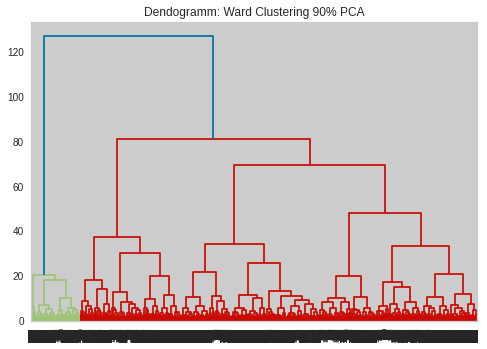

<Figure size 720x504 with 0 Axes>

time: 9min 55s (started: 2023-02-19 07:52:38 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_ward_90 = dendrogram(ward_90)
dendogramm_ward_90 = plt.title("Dendogramm: Ward Clustering 90% PCA")
dendogramm_ward_90 = plt.figure(figsize=(10, 7))
dendogramm_ward_90.show()

In [ ]:
#Labels zum Df hinzufügen
cluster_labels = cut_tree(ward_90, n_clusters=3).reshape(-1, )
data_pca_90_hierarchy['Cluster_Labels_ward_90'] = cluster_labels

time: 3.19 s (started: 2023-02-19 08:02:33 +00:00)


In [ ]:
#Speichern
savePickle(ward_90, 'ward_90')
savePickle(dendogramm_ward_90, 'dendogramm_ward_90')
saveCSV(data_pca_90_hierarchy, 'data_pca_90_hierarchy')

time: 1.23 s (started: 2023-02-19 08:02:36 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

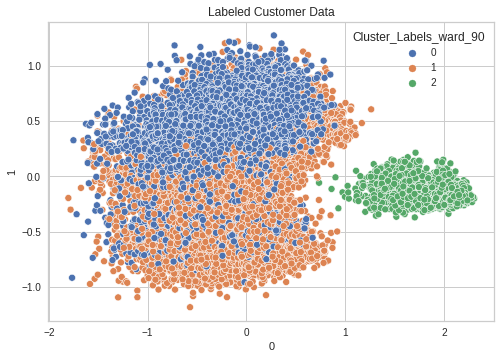

time: 1.99 s (started: 2023-02-19 08:02:37 +00:00)


In [ ]:
sns.scatterplot(x=data_pca_90_hierarchy[0], 
                y=data_pca_90_hierarchy[1], 
                data=data_pca_90_hierarchy, 
                hue=data_pca_90_hierarchy['Cluster_Labels_ward_90'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_ward_90_silhouette = silhouette_score(data_pca_90, cluster_labels)
performance_ward_90_davies = davies_bouldin_score(data_pca_90, cluster_labels)
performance_ward_90_calinski = calinski_harabasz_score(data_pca_90, cluster_labels)

performance_ward_90_cluster = len(np.unique(cluster_labels))

time: 5.99 s (started: 2023-02-19 08:02:39 +00:00)


###70%

####Berechnung

In [ ]:
#hierarchisches Clustering
ward_70 = linkage(data_pca_70, method="ward", metric='euclidean')

time: 20.9 s (started: 2023-02-19 08:02:45 +00:00)


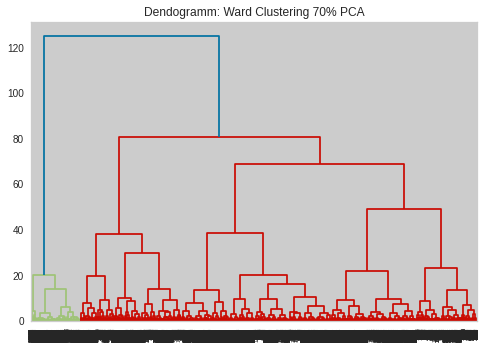

<Figure size 720x504 with 0 Axes>

time: 9min 52s (started: 2023-02-19 08:03:06 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
dendogramm_ward_70 = dendrogram(ward_70)
dendogramm_ward_70 = plt.title("Dendogramm: Ward Clustering 70% PCA")
dendogramm_ward_70 = plt.figure(figsize=(10, 7))
dendogramm_ward_70.show()

In [ ]:
#Labels zum Df hinzufügen
cluster_labels = cut_tree(ward_70, n_clusters=3).reshape(-1, )
data_pca_70_hierarchy['Cluster_Labels_ward_70'] = cluster_labels

time: 3.79 s (started: 2023-02-19 08:12:59 +00:00)


In [ ]:
#Speichern
savePickle(ward_70, 'ward_70')
savePickle(dendogramm_ward_70, 'dendogramm_ward_70')
saveCSV(data_pca_70_hierarchy, 'data_pca_70_hierarchy')

time: 806 ms (started: 2023-02-19 08:13:03 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

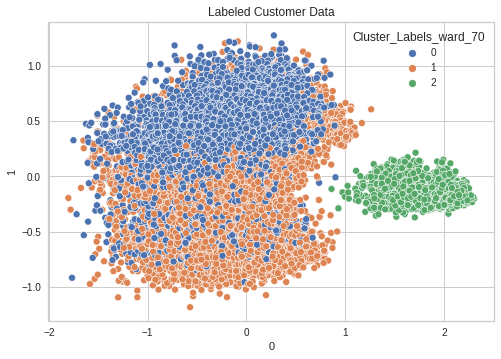

time: 1.79 s (started: 2023-02-19 08:13:04 +00:00)


In [ ]:
sns.scatterplot(x=data_pca_70_hierarchy[0], 
                y=data_pca_70_hierarchy[1], 
                data=data_pca_70_hierarchy, 
                hue=data_pca_70_hierarchy['Cluster_Labels_ward_70'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_ward_70_silhouette = silhouette_score(data_pca_70, cluster_labels)
performance_ward_70_davies = davies_bouldin_score(data_pca_70, cluster_labels)
performance_ward_70_calinski = calinski_harabasz_score(data_pca_70, cluster_labels)

performance_ward_70_cluster = len(np.unique(cluster_labels))

time: 5.28 s (started: 2023-02-19 08:13:05 +00:00)


## Single Linkage Clustering ???

###Ohne PCA

####Berechnung

In [ ]:
#hierarchisches Clustering
mergings = linkage(data_scaled_df_hierarchy, method="single", metric='euclidean')

time: 11 s (started: 2023-02-15 12:32:27 +00:00)


In [ ]:
#Speichern
saveModel(mergings, 'single_ohnepca')

time: 307 ms (started: 2023-02-15 12:32:38 +00:00)


In [ ]:
# Visualisierung ~9 Minuten
# dendogramm_single_ohnepca = dendrogram(mergings)
# dendogramm_single_ohnepca = plt.title("Dendogramm: Single Clustering ohne PCA")
# dendogramm_single_ohnepca = plt.figure(figsize=(10, 7))
# dendogramm_single_ohnepca.show()

time: 432 µs (started: 2023-02-15 12:32:38 +00:00)


In [ ]:
#Speichern
#saveModel(dendogramm_single_ohnepca, 'dendogramm_single_ohnepca')

time: 339 µs (started: 2023-02-15 12:32:38 +00:00)


In [ ]:
cluster_labels = cut_tree(mergings, n_clusters=3).reshape(-1, )
data_scaled_df_hierarchy['Cluster_Labels_single_ohne_pca'] = cluster_labels

time: 1min 40s (started: 2023-02-15 12:32:38 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

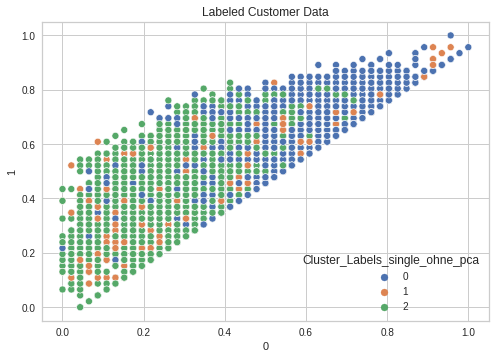

time: 1.32 s (started: 2023-02-15 12:34:19 +00:00)


In [ ]:
sns.scatterplot(x=data_scaled_df_hierarchy[0], 
                y=data_scaled_df_hierarchy[1], 
                data=data_scaled_df_hierarchy, 
                hue=data_scaled_df_hierarchy['Cluster_Labels_single_ohne_pca'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_single_ohne_pca_silhouette = silhouette_score(data_scaled_df_hierarchy, cluster_labels)
performance_single_ohne_pca_davies = davies_bouldin_score(data_scaled_df_hierarchy, cluster_labels)
performance_single_ohne_pca_calinski = calinski_harabasz_score(data_scaled_df_hierarchy, cluster_labels)

performance_single_ohne_pca_cluster = len(np.unique(cluster_labels))

time: 5.53 s (started: 2023-02-15 12:34:20 +00:00)


###90%

####Berechnung

In [ ]:
#hierarchisches Clustering
mergings = linkage(data_pca_90_hierarchy, method="single", metric='euclidean')

In [ ]:
#Speichern
saveModel(mergings, 'single_90')

In [ ]:
#Visualisierung ~9 Minuten
# dendogramm_single_90 = dendrogram(mergings)
# dendogramm_single_90 = plt.title("Dendogramm: Single Clustering 90% PCA")
# dendogramm_single_90 = plt.figure(figsize=(10, 7))
# dendogramm_ward_90.show()

In [ ]:
#Speichern
# saveModel(dendogramm_single_90, 'dendogramm_single_90')

In [ ]:
cluster_labels = cut_tree(mergings, n_clusters=3).reshape(-1, )
data_pca_90_hierarchy['Cluster_Labels_single_90'] = cluster_labels

####Visualisierung

In [ ]:
sns.scatterplot(x=data_pca_90_hierarchy[0], 
                y=data_pca_90_hierarchy[1], 
                data=data_pca_90_hierarchy, 
                hue=data_pca_90_hierarchy['Cluster_Labels_single_90'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_single_90_silhouette = silhouette_score(data_pca_90_hierarchy, cluster_labels)
performance_single_90_davies = davies_bouldin_score(data_pca_90_hierarchy, cluster_labels)
performance_single_90_calinski = calinski_harabasz_score(data_pca_90_hierarchy, cluster_labels)

performance_single_90_cluster = len(np.unique(cluster_labels))

###70%

####Berechnung

In [ ]:
#hierarchisches Clustering
mergings = linkage(data_pca_70_hierarchy, method="single", metric='euclidean')

time: 5.38 s (started: 2023-02-15 12:34:26 +00:00)


In [ ]:
#Speichern
saveModel(mergings, 'single_70')

time: 294 ms (started: 2023-02-15 12:34:31 +00:00)


In [ ]:
#Visualisierung ~9 Minuten
# dendogramm_single_70 = dendrogram(mergings)
# dendogramm_single_70 = plt.title("Dendogramm: single Clustering 70% PCA")
# dendogramm_single_70 = plt.figure(figsize=(10, 7))
# dendogramm_single_70.show()

time: 292 µs (started: 2023-02-15 12:34:32 +00:00)


In [ ]:
#Speichern
# saveModel(dendogramm_single_70, 'dendogramm_single_70')

time: 380 µs (started: 2023-02-15 12:34:32 +00:00)


In [ ]:
cluster_labels = cut_tree(mergings, n_clusters=3).reshape(-1, )
data_pca_70_hierarchy['Cluster_Labels_single_70'] = cluster_labels

time: 47.6 s (started: 2023-02-15 12:34:32 +00:00)


####Visualisierung

Text(0.5, 1.0, 'Labeled Customer Data')

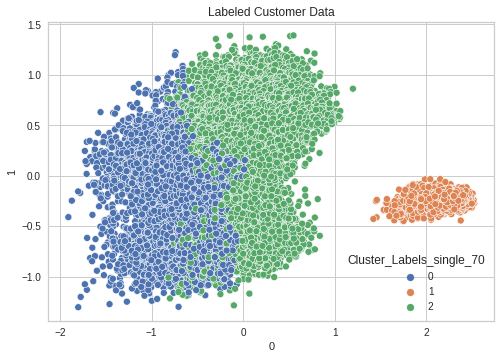

time: 1.43 s (started: 2023-02-15 12:35:19 +00:00)


In [ ]:
sns.scatterplot(x=data_pca_70_hierarchy[0], 
                y=data_pca_70_hierarchy[1], 
                data=data_pca_70_hierarchy, 
                hue=data_pca_70_hierarchy['Cluster_Labels_single_70'],
                palette="deep"
                ).set_title('Labeled Customer Data')

####Performance Metriken

In [ ]:
performance_single_70_silhouette = silhouette_score(data_pca_70_hierarchy, cluster_labels)
performance_single_70_davies = davies_bouldin_score(data_pca_70_hierarchy, cluster_labels)
performance_single_70_calinski = calinski_harabasz_score(data_pca_70_hierarchy, cluster_labels)

performance_single_70_cluster = len(np.unique(cluster_labels))

time: 4.98 s (started: 2023-02-15 12:35:21 +00:00)


#Performance

##Dataframes erstellen

In [ ]:
#DataFrames für die Performance mit PCA 90%
performance_90_silhouette = pd.DataFrame(columns =  ['Algorithmus','Cluster','Parameter','Silhouette Score'])
performance_90_davies = pd.DataFrame(columns =      ['Algorithmus','Cluster','Parameter','Davies Bouldin Score'])
performance_90_calinski = pd.DataFrame(columns =    ['Algorithmus','Cluster','Parameter','Calinski H. Score'])

#DataFrames für die Performance ohne PCA
performance_ohne_pca_silhouette =    performance_90_silhouette.copy()
performance_ohne_pca_davies =    performance_90_davies.copy()
performance_ohne_pca_calinski =  performance_90_calinski.copy()

#DataFrames für die Performance mit PCA 70%
performance_70_silhouette =  performance_90_silhouette.copy()
performance_70_davies =      performance_90_davies.copy()
performance_70_calinski =    performance_90_calinski.copy()

time: 19.4 ms (started: 2023-02-19 08:28:12 +00:00)


##DataFrames füllen

###**Ohne PCA** ~ Alle Features ~ 100% der Varianz

In [ ]:
#Silhouette Score

kmeans_ohne_pca_new_row = 	  {'Algorithmus': 'kMeans',
                              'Parameter': 'k = ' + str(performance_kmeans_ohne_pca_cluster),
                              'Cluster': performance_kmeans_ohne_pca_cluster,
                              'Silhouette Score': performance_kmeans_ohne_pca_silhouette}

dbscan_ohne_pca_new_row =     {'Algorithmus': 'DBScan',
                              'Parameter': f'eps = ' + str(round(eps_silhouette_dbscan_ohne_pca,1)) + ',\nsamples = ' + str(samples_silhouette_dbscan_ohne_pca),
                              'Cluster': cluster_silhouette_dbscan_ohne_pca,
                              'Silhouette Score': max_value_silhouette_dbscan_ohne_pca}

# single_ohne_pca_new_row =     {'Algorithmus': 'Single Linkage',
#                                'Parameter': 'keine',
#                                'Cluster': performance_single_ohne_pca_cluster,
#                                'Silhouette Score': performance_single_ohne_pca_silhouette}

average_ohne_pca_new_row =    {'Algorithmus': 'Average Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_average_ohne_pca_cluster,
                              'Silhouette Score': performance_average_ohne_pca_silhouette}

complete_ohne_pca_new_row =   {'Algorithmus': 'Complete Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_complete_ohne_pca_cluster,
                              'Silhouette Score': performance_complete_ohne_pca_silhouette}

ward_ohne_pca_new_row =       {'Algorithmus': 'Ward Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_ward_ohne_pca_cluster,
                              'Silhouette Score': performance_ward_ohne_pca_silhouette}


performance_ohne_pca_silhouette = performance_ohne_pca_silhouette.append(kmeans_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_silhouette = performance_ohne_pca_silhouette.append(dbscan_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_silhouette = performance_ohne_pca_silhouette.append(average_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_silhouette = performance_ohne_pca_silhouette.append(complete_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_silhouette = performance_ohne_pca_silhouette.append(ward_ohne_pca_new_row, ignore_index=True)

NameError: ignored

time: 194 ms (started: 2023-02-19 08:28:12 +00:00)


In [ ]:
#Davies Bouldin Score

kmeans_ohne_pca_new_row = 	  {'Algorithmus': 'kMeans',
                              'Parameter': 'k = ' + str(performance_kmeans_ohne_pca_cluster),
                              'Cluster': performance_kmeans_ohne_pca_cluster,
                              'Davies Bouldin Score': performance_kmeans_ohne_pca_davies}

dbscan_ohne_pca_new_row =     {'Algorithmus': 'DBScan',
                              'Parameter': f'eps = ' + str(round(eps_davies_dbscan_ohne_pca,1)) + ',\nsamples = ' + str(samples_davies_dbscan_ohne_pca),
                              'Cluster': cluster_davies_dbscan_ohne_pca,
                              'Davies Bouldin Score': min_value_davies_dbscan_ohne_pca}

single_ohne_pca_new_row =    {'Algorithmus': 'Single Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_single_ohne_pca_cluster,
                              'Davies Bouldin Score': performance_single_ohne_pca_davies}

average_ohne_pca_new_row =    {'Algorithmus': 'Average Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_average_ohne_pca_cluster,
                              'Davies Bouldin Score': performance_average_ohne_pca_davies}

complete_ohne_pca_new_row =   {'Algorithmus': 'Complete Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_complete_ohne_pca_cluster,
                              'Davies Bouldin Score': performance_complete_ohne_pca_davies}

ward_ohne_pca_new_row =       {'Algorithmus': 'Ward Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_ward_ohne_pca_cluster,
                              'Davies Bouldin Score': performance_ward_ohne_pca_davies}


performance_ohne_pca_davies = performance_ohne_pca_davies.append(kmeans_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_davies = performance_ohne_pca_davies.append(dbscan_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_davies = performance_ohne_pca_davies.append(single_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_davies = performance_ohne_pca_davies.append(average_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_davies = performance_ohne_pca_davies.append(complete_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_davies = performance_ohne_pca_davies.append(ward_ohne_pca_new_row, ignore_index=True)

In [ ]:
#Calinski H. Score

kmeans_ohne_pca_new_row = 	  {'Algorithmus': 'kMeans',
                              'Parameter': 'k = ' + str(performance_kmeans_ohne_pca_cluster),
                              'Cluster': performance_kmeans_ohne_pca_cluster,
                              'Calinski Score': performance_kmeans_ohne_pca_calinski}

dbscan_ohne_pca_new_row =     {'Algorithmus': 'DBScan',
                              'Parameter': f'eps = ' + str(round(eps_calinski_dbscan_ohne_pca,1)) + ',\nsamples = ' + str(samples_calinski_dbscan_ohne_pca),
                              'Cluster': cluster_calinski_dbscan_ohne_pca,
                              'Calinski Score': max_value_calinski_dbscan_ohne_pca}

single_ohne_pca_new_row =    {'Algorithmus': 'Single Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_single_ohne_pca_cluster,
                              'Calinski Score': performance_single_ohne_pca_calinksi}

average_ohne_pca_new_row =    {'Algorithmus': 'Average Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_average_ohne_pca_cluster,
                              'Calinski Score': performance_average_ohne_pca_calinksi}

complete_ohne_pca_new_row =   {'Algorithmus': 'Complete Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_complete_ohne_pca_cluster,
                              'Calinski Score': performance_complete_ohne_pca_calinksi}

ward_ohne_pca_new_row =       {'Algorithmus': 'Ward Linkage',
                              'Parameter': 'keine',
                              'Cluster': performance_ward_ohne_pca_cluster,
                              'Calinski Score': performance_ward_ohne_pca_calinksi}


performance_ohne_pca_calinski = performance_ohne_pca_calinski.append(kmeans_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_calinski = performance_ohne_pca_calinski.append(dbscan_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_calinski = performance_ohne_pca_calinski.append(single_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_calinski = performance_ohne_pca_calinski.append(average_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_calinski = performance_ohne_pca_calinski.append(complete_ohne_pca_new_row, ignore_index=True)
performance_ohne_pca_calinski = performance_ohne_pca_calinski.append(ward_ohne_pca_new_row, ignore_index=True)

###**13 Features** ~ 90% der Varianz

In [ ]:
#Silhouette Score

kmeans_90_new_row = 	  {'Algorithmus': 'kMeans',
                        'Parameter': 'k = ' + str(performance_kmeans_90_cluster),
                        'Cluster': performance_kmeans_90_cluster,
                        'Silhouette Score': performance_kmeans_90_silhouette}

dbscan_90_new_row =     {'Algorithmus': 'DBScan',
                        'Parameter': f'eps = ' + str(round(eps_silhouette_dbscan_90,1)) + ',\nsamples = ' + str(samples_silhouette_dbscan_90),
                        'Cluster': cluster_silhouette_dbscan_90,
                        'Silhouette Score': max_value_silhouette_dbscan_90}

# single_90_new_row =    {'Algorithmus': 'Single Linkage',
#                         'Parameter': 'keine',
#                         'Cluster': performance_single_90_cluster,
#                         'Silhouette Score': performance_single_90_silhouette}

average_90_new_row =    {'Algorithmus': 'Average Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_average_90_cluster,
                        'Silhouette Score': performance_average_90_silhouette}

complete_90_new_row =   {'Algorithmus': 'Complete Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_complete_90_cluster,
                        'Silhouette Score': performance_complete_90_silhouette}

ward_90_new_row =       {'Algorithmus': 'Ward Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_ward_90_cluster,
                        'Silhouette Score': performance_ward_90_silhouette}

performance_90_silhouette = performance_90_silhouette.append(kmeans_90_new_row, ignore_index=True)
performance_90_silhouette = performance_90_silhouette.append(dbscan_90_new_row, ignore_index=True)
performance_90_silhouette = performance_90_silhouette.append(single_90_new_row, ignore_index=True)
performance_90_silhouette = performance_90_silhouette.append(average_90_new_row, ignore_index=True)
performance_90_silhouette = performance_90_silhouette.append(complete_90_new_row, ignore_index=True)
performance_90_silhouette = performance_90_silhouette.append(ward_90_new_row, ignore_index=True)

In [ ]:
#Davies Bouldin Score

kmeans_90_new_row = 	  {'Algorithmus': 'kMeans',
                        'Parameter': 'k = ' + str(performance_kmeans_90_cluster),
                        'Cluster': performance_kmeans_90_cluster,
                        'Davies Bouldin Score': performance_kmeans_90_davies}

dbscan_90_new_row =     {'Algorithmus': 'DBScan',
                        'Parameter': f'eps = ' + str(round(eps_davies_dbscan_90,1)) + ',\nsamples = ' + str(samples_davies_dbscan_90),
                        'Cluster': cluster_davies_dbscan_90,
                        'Davies Bouldin Score': min_value_davies_dbscan_90}

single_90_new_row =    {'Algorithmus': 'Single Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_single_90_cluster,
                        'Davies Bouldin Score': performance_single_90_davies}

average_90_new_row =    {'Algorithmus': 'Average Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_average_90_cluster,
                        'Davies Bouldin Score': performance_average_90_davies}

complete_90_new_row =   {'Algorithmus': 'Complete Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_complete_90_cluster,
                        'Davies Bouldin Score': performance_complete_90_davies}

ward_90_new_row =       {'Algorithmus': 'Ward Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_ward_90_cluster,
                        'Davies Bouldin Score': performance_ward_90_davies}

performance_90_davies = performance_90_davies.append(kmeans_90_new_row, ignore_index=True)
performance_90_davies = performance_90_davies.append(dbscan_90_new_row, ignore_index=True)
performance_90_davies = performance_90_davies.append(single_90_new_row, ignore_index=True)
performance_90_davies = performance_90_davies.append(average_90_new_row, ignore_index=True)
performance_90_davies = performance_90_davies.append(complete_90_new_row, ignore_index=True)
performance_90_davies = performance_90_davies.append(ward_90_new_row, ignore_index=True)

In [ ]:
#Calinski H. Score

kmeans_90_new_row = 	  {'Algorithmus': 'kMeans',
                        'Parameter': 'k = ' + str(performance_kmeans_90_cluster),
                        'Cluster': performance_kmeans_90_cluster,
                        'Calinski Score': performance_kmeans_90_calinski}

dbscan_90_new_row =     {'Algorithmus': 'DBScan',
                        'Parameter': f'eps = ' + str(round(eps_calinski_dbscan_90,1)) + ',\nsamples = ' + str(samples_calinski_dbscan_90),
                        'Cluster': cluster_calinski_dbscan_90,
                        'Calinski Score': max_value_calinski_dbscan_90}

single_90_new_row =    {'Algorithmus': 'Single Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_single_90_cluster,
                        'Calinski Score': performance_single_90_calinski}

average_90_new_row =    {'Algorithmus': 'Average Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_average_90_cluster,
                        'Calinski Score': performance_average_90_calinski}

complete_90_new_row =   {'Algorithmus': 'Complete Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_complete_90_cluster,
                        'Calinski Score': performance_complete_90_calinski}

ward_90_new_row =       {'Algorithmus': 'Ward Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_ward_90_cluster,
                        'Calinski Score': performance_ward_90_calinski}

performance_90_calinski = performance_90_calinski.append(kmeans_90_new_row, ignore_index=True)
performance_90_calinski = performance_90_calinski.append(dbscan_90_new_row, ignore_index=True)
performance_90_calinski = performance_90_calinski.append(single_90_new_row, ignore_index=True)
performance_90_calinski = performance_90_calinski.append(average_90_new_row, ignore_index=True)
performance_90_calinski = performance_90_calinski.append(complete_90_new_row, ignore_index=True)
performance_90_calinski = performance_90_calinski.append(ward_90_new_row, ignore_index=True)

###**4 Features** ~ 70% der Varianz

In [ ]:
#Silhouette Score

kmeans_70_new_row = 	  {'Algorithmus': 'kMeans',
                        'Parameter': 'k = ' + str(performance_kmeans_70_cluster),
                        'Cluster': performance_kmeans_70_cluster,
                        'Silhouette Score': performance_kmeans_70_silhouette}

dbscan_70_new_row =     {'Algorithmus': 'DBScan',
                        'Parameter': f'eps = ' + str(round(eps_silhouette_dbscan_70,1)) + ',\nsamples = ' + str(samples_silhouette_dbscan_70),
                        'Cluster': cluster_silhouette_dbscan_70,
                        'Silhouette Score': max_value_silhouette_dbscan_70}

# single_70_new_row =    {'Algorithmus': 'Single Linkage',
#                         'Parameter': 'keine',
#                         'Cluster': performance_single_70_cluster,
#                         'Silhouette Score': performance_single_ohne_pca_silhouette}

average_70_new_row =    {'Algorithmus': 'Average Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_average_70_cluster,
                        'Silhouette Score': performance_average_ohne_pca_silhouette}

complete_70_new_row =   {'Algorithmus': 'Complete Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_complete_70_cluster,
                        'Silhouette Score': performance_complete_ohne_pca_silhouette}

ward_70_new_row =       {'Algorithmus': 'Ward Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_ward_70_cluster,
                        'Silhouette Score': performance_ward_ohne_pca_silhouette}


performance_70_silhouette = performance_70_silhouette.append(kmeans_70_new_row, ignore_index=True)
performance_70_silhouette = performance_70_silhouette.append(dbscan_70_new_row, ignore_index=True)
performance_70_silhouette = performance_70_silhouette.append(single_70_new_row, ignore_index=True)
performance_70_silhouette = performance_70_silhouette.append(average_70_new_row, ignore_index=True)
performance_70_silhouette = performance_70_silhouette.append(complete_70_new_row, ignore_index=True)
performance_70_silhouette = performance_70_silhouette.append(ward_70_new_row, ignore_index=True)

In [ ]:
#Davies Bouldin Score

kmeans_70_new_row = 	  {'Algorithmus': 'kMeans',
                        'Parameter': 'k = ' + str(performance_kmeans_70_cluster),
                        'Cluster': performance_kmeans_70_cluster,
                        'Davies Bouldin Score': performance_kmeans_70_davies}

dbscan_70_new_row =     {'Algorithmus': 'DBScan',
                        'Parameter': f'eps = ' + str(round(eps_davies_dbscan_70,1)) + ',\nsamples = ' + str(samples_davies_dbscan_70),
                        'Cluster': cluster_davies_dbscan_70,
                        'Davies Bouldin Score': min_value_davies_dbscan_70}

average_70_new_row =    {'Algorithmus': 'Average Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_average_70_cluster,
                        'Davies Bouldin Score': performance_average_ohne_pca_davies}

complete_70_new_row =   {'Algorithmus': 'Complete Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_complete_70_cluster,
                        'Davies Bouldin Score': performance_complete_ohne_pca_davies}

ward_70_new_row =       {'Algorithmus': 'Ward Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_ward_70_cluster,
                        'Davies Bouldin Score': performance_ward_ohne_pca_davies}


performance_70_davies = performance_70_davies.append(kmeans_70_new_row, ignore_index=True)
performance_70_davies = performance_70_davies.append(dbscan_70_new_row, ignore_index=True)
performance_70_davies = performance_70_davies.append(average_70_new_row, ignore_index=True)
performance_70_davies = performance_70_davies.append(complete_70_new_row, ignore_index=True)
performance_70_davies = performance_70_davies.append(ward_70_new_row, ignore_index=True)

In [ ]:
#Calinski H. Score

kmeans_70_new_row = 	  {'Algorithmus': 'kMeans',
                        'Parameter': 'k = ' + str(performance_kmeans_70_cluster),
                        'Cluster': performance_kmeans_70_cluster,
                        'Calinski Score': performance_kmeans_70_calinski}

dbscan_70_new_row =     {'Algorithmus': 'DBScan',
                        'Parameter': f'eps = ' + str(round(eps_calinski_dbscan_70,1)) + ',\nsamples = ' + str(samples_calinski_dbscan_70),
                        'Cluster': cluster_calinski_dbscan_70,
                        'Calinski Score': max_value_calinski_dbscan_70}

average_70_new_row =    {'Algorithmus': 'Average Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_average_70_cluster,
                        'Calinski Score': performance_average_ohne_pca_calinski}

complete_70_new_row =   {'Algorithmus': 'Complete Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_complete_70_cluster,
                        'Calinski Score': performance_complete_ohne_pca_calinski}

ward_70_new_row =       {'Algorithmus': 'Ward Linkage',
                        'Parameter': 'keine',
                        'Cluster': performance_ward_70_cluster,
                        'Calinski Score': performance_ward_ohne_pca_calinski}


performance_70_calinski = performance_70_calinski.append(kmeans_70_new_row, ignore_index=True)
performance_70_calinski = performance_70_calinski.append(dbscan_70_new_row, ignore_index=True)
performance_70_calinski = performance_70_calinski.append(average_70_new_row, ignore_index=True)
performance_70_calinski = performance_70_calinski.append(complete_70_new_row, ignore_index=True)
performance_70_calinski = performance_70_calinski.append(ward_70_new_row, ignore_index=True)

##Performance Tabellen

In [ ]:
pd.options.display.max_colwidth = 80

In [ ]:
def displayNice (df):
  display( HTML( df.to_html().replace("\\n","<br>")))

In [ ]:
displayNice(performance_ohne_pca_silhouette)
displayNice(performance_ohne_pca_davies)
displayNice(performance_ohne_pca_calinski)

In [ ]:
displayNice(performance_90_silhouette)
displayNice(performance_90_davies)
displayNice(performance_90_calinski)

In [ ]:
displayNice(performance_70_silhouette)
displayNice(performance_70_davies)
displayNice(performance_70_calinski)